In [1]:
# Bibliotecas
import os
import random
import pandas as pd
import cv2
import numpy as np
import matplotlib.pyplot as plt

from funcs import modificacoes, banco, tvt
from redes.unet import unet 
from redes.ResUnet import MultiResUnet


import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import mixed_precision
from tensorflow.keras.callbacks import EarlyStopping


In [2]:
# Configuração (GPU / mixed precision / strategy)

print('TensorFlow:', tf.__version__)
print('Built with CUDA:', tf.test.is_built_with_cuda())

gpus = tf.config.list_physical_devices('GPU')
cpus = tf.config.list_physical_devices('CPU')
print('GPUs:', gpus)
print('CPUs:', cpus)

# Importante: fazer isso ANTES de criar modelos/estratégias, para evitar reservar toda a VRAM
if gpus:
    for g in gpus:
        try:
            tf.config.experimental.set_memory_growth(g, True)
        except Exception as e:
            print('Não foi possível habilitar memory growth:', e)

    # Mixed precision costuma reduzir MUITO o uso de VRAM em U-Net
    mixed_precision.set_global_policy('mixed_float16')
    print('Mixed precision policy:', mixed_precision.global_policy())

# Estratégia: só use MirroredStrategy se tiver >1 GPU
strategy = tf.distribute.MirroredStrategy() if len(gpus) > 1 else tf.distribute.get_strategy()
print('Strategy:', type(strategy).__name__)

TensorFlow: 2.16.1
Built with CUDA: False
GPUs: []
CPUs: [PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU')]
Strategy: _DefaultDistributionStrategy


In [3]:
# Mais detalhes de GPU
# Se quiser ver detalhes, rode este bloco.
gpus = tf.config.list_physical_devices('GPU')
for i, g in enumerate(gpus):
    try:
        details = tf.config.experimental.get_device_details(g)
    except Exception as e:
        details = {'error': str(e)}
    print(f'GPU {i}:', g, 'details:', details)

In [4]:
""" Divide e modifica o banco de dados"""
# x_train
path_x_train = 'banco2/TreinoGeral/imgs/'
path_x_train_modificacoes = 'banco2/TreinoGeral/imgs_AUGMENTATION'
# path_x_train_modificacoes = 'banco2/Nelore1/imgAUGMENTATION'


# Função para fazer as modificações nas imagens
# modificacoes(path_x_train, 
#              path_x_train_modificacoes, 
#              original = True, 
#              brilho = 1.5,  
#              flip = False, 
#              escura = 0.5, 
#              rotacao=None)

# Função para carregar o banco de imagens
x_train = banco(path_x_train_modificacoes, resolution=(256,256), grayscale= True)

# y_train
path_y_train = 'banco2/TreinoGeral/label/'
path_y_train_modificacoes = 'banco2/TreinoGeral/label_AUGMENTATION'
# path_y_train_modificacoes = 'banco2/Nelore1/labelAUGMENTATION'



lista_img_train = os.listdir(path_x_train_modificacoes)
lista_img_label = os.listdir(path_y_train)

# duplica imagens de label se necessario
# for i,nome_arquivo in enumerate(lista_img_label):
#     for j,nome_arquivo_train in enumerate(lista_img_train):
#         if nome_arquivo[:6] == nome_arquivo_train[:6]:
#             caminho = os.path.join(path_y_train, nome_arquivo)
#             img = cv2.imread(caminho)
#             novo_nome = lista_img_train[j] +f'_{j}.png'
#             destino = os.path.join(path_y_train_modificacoes, novo_nome)
#             cv2.imwrite(destino, img)
#             print(f'A imagem {nome_arquivo} foi duplicada para igualar quantidade.')

y_train, labels = banco(path_y_train_modificacoes, resolution=(256,256), grayscale= True, nomes=True)


In [5]:
# Prints de verificação
print(f'Imagens : {x_train.shape}')
print(f'Máscaras: {y_train.shape}')
print(f'Labels  : {set(labels[0:3])}')
# print(f'label: {labels[2][2:6]}')

Imagens : (378, 256, 256, 1)
Máscaras: (378, 256, 256, 1)
Labels  : {'I-2519-251119-162630_dark_0.jpg_0.png', 'I-2519-251119-162630_luz_0.jpg_1.png', 'I-2519-251119-162630_origi_0.jpg_2.png'}


In [6]:
""" Visualizando algumas imagens e labels """
def plot_img_mask(img_list, mask_list, num_pairs = 5, label = None):
    n = num_pairs
    plt.figure(figsize=(10, 6))
    for i in range(n):
        idx = random.randint(0, len(img_list) - 1)
        img = img_list[idx]
        mask = mask_list[idx]
        plt.subplot(2, n, i + 1)
        plt.imshow(img)
        if label is not None and len(label) > idx:
            plt.title(f"Imagem = {label[idx][2:6]}, index =  {idx}", fontsize=9)
        plt.axis("off")

        plt.subplot(2, n, i + 1 + n)
        plt.imshow(mask)
        if label is not None and len(label) > idx:
            plt.title(f"Label = {label[idx][2:6]}, index = {idx}", fontsize=9)
        plt.axis("off")
        del img, mask

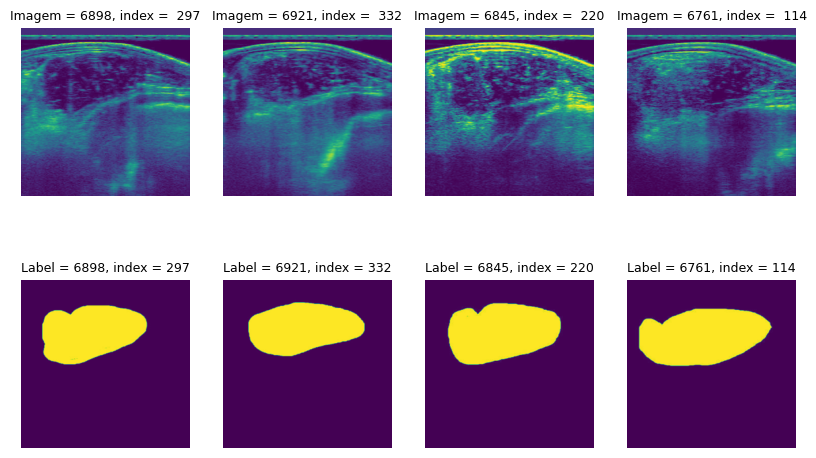

In [7]:
# Plot da função
plot_img_mask(x_train, y_train, num_pairs= 4, label= labels)

In [8]:
""" Função tvt: train, val, test """
x_train, y_train, nomes_train, x_val, y_val, nomes_val, x_test, y_test, nomes_test = tvt(x_train, y_train, partition=(0.6, 0.2, 0.2), nomes = labels) # 70% treino, 10% validação, 20% teste

In [9]:
# Prints de verificação dos conjuntos
print(f'Imagens X treino: {x_train.shape}')
print(f'Imagens Y treino: {y_train.shape}')
print(f'Nomes treino: {len(nomes_train)}')

print(f'Imagens X teste: {x_test.shape}')
print(f'Imagens Y teste: {y_test.shape}')
print(f'Nomes teste: {len(nomes_test)}')

print(f'Imagens X validação: {x_val.shape}')
print(f'Imagens Y validação: {y_val.shape}')
print(f'Nomes validação: {len(nomes_val)}')

Imagens X treino: (226, 256, 256, 1)
Imagens Y treino: (226, 256, 256, 1)
Nomes treino: 226
Imagens X teste: (77, 256, 256, 1)
Imagens Y teste: (77, 256, 256, 1)
Nomes teste: 77
Imagens X validação: (75, 256, 256, 1)
Imagens Y validação: (75, 256, 256, 1)
Nomes validação: 75


Treino
Validação
Teste


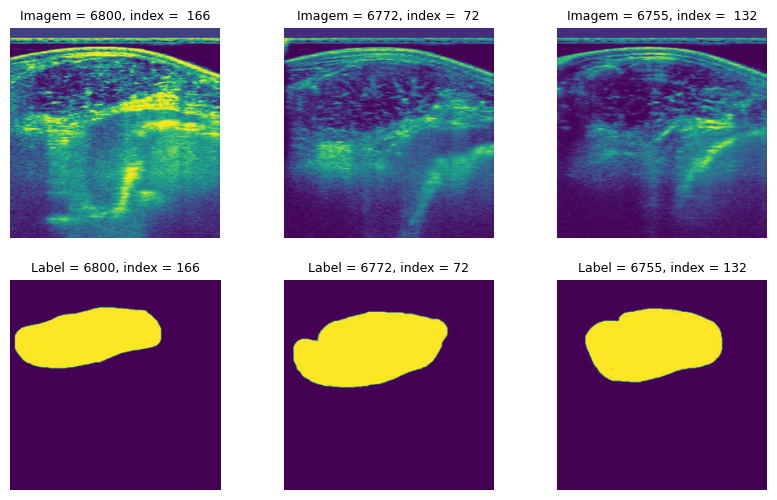

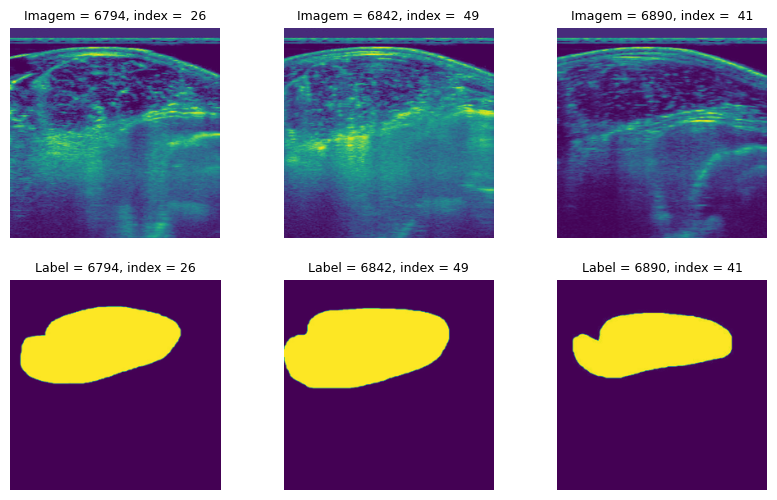

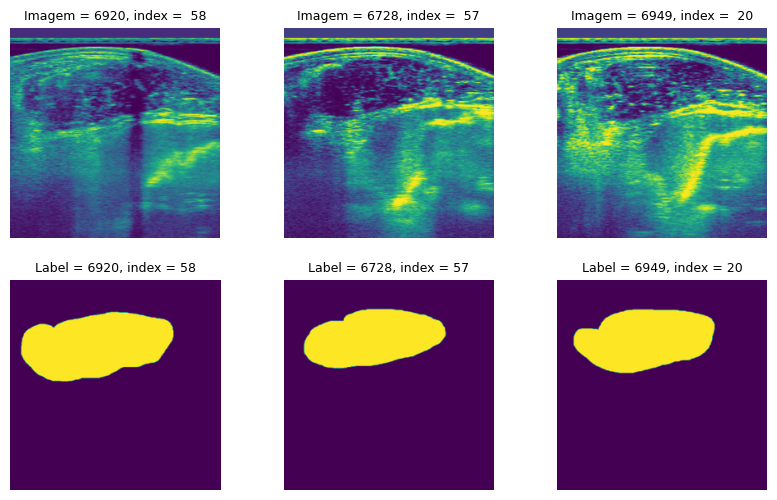

In [10]:
print("Treino")
plot_img_mask(x_train, y_train, num_pairs= 3, label= nomes_train)
print("Validação")
plot_img_mask(x_val, y_val, num_pairs= 3, label= nomes_val)
print("Teste")
plot_img_mask(x_test, y_test, num_pairs= 3, label= nomes_test)

In [11]:
# Converting the arrays into tf.data batches (mais leve e eficiente)
AUTOTUNE = tf.data.AUTOTUNE

# Se ainda der OOM, o 1º ajuste é reduzir batch_size
batch_size = 1

train_data = tf.data.Dataset.from_tensor_slices((x_train, y_train))
train_data = train_data.shuffle(buffer_size=len(x_train), seed=42, reshuffle_each_iteration=True)
train_data = train_data.batch(batch_size).prefetch(AUTOTUNE)

val_data = tf.data.Dataset.from_tensor_slices((x_val, y_val))
val_data = val_data.batch(batch_size).prefetch(AUTOTUNE)

test_data = tf.data.Dataset.from_tensor_slices((x_test, y_test))
test_data = test_data.batch(batch_size).prefetch(AUTOTUNE)

In [12]:
""" setting DICE coefficient to evaluate the model """
def dice_coefficient(y_true, y_pred, smooth=1.0):
    y_true = tf.cast(y_true, tf.float32)
    y_pred = tf.cast(y_pred, tf.float32)

    # Flatten per-sample to compute Dice over all pixels
    y_true_f = tf.reshape(y_true, [tf.shape(y_true)[0], -1])
    y_pred_f = tf.reshape(y_pred, [tf.shape(y_pred)[0], -1])

    intersection = tf.reduce_sum(y_true_f * y_pred_f, axis=1)
    union = tf.reduce_sum(y_true_f, axis=1) + tf.reduce_sum(y_pred_f, axis=1)
    dice_coeff = (2.0 * intersection + smooth) / (union + smooth)
    return dice_coeff

In [13]:
""" ResUnet """

with strategy.scope():
    resunet = MultiResUnet(256,256,1)
    resunet.compile(
        optimizer='adam',
        loss='binary_crossentropy',
        metrics=['accuracy', dice_coefficient] 
    )

resunet.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1 (Conv2D)   │ (None, 256, 256,  │         72 │ input_layer[0][0] │
│                     │ 8)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 256, 256,  │         24 │ conv2d_1[0][0]    │
│ (BatchNormalizatio… │ 8)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation          │ (None, 256, 256,  │          0 │ batch_normalizat… │
│ (Activation)        │ 8)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_2 (Conv2D)   │ (None, 256, 256,  │      1,224 │ activation[0][0]  │
│                     │ 17)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 256, 256,  │         51 │ conv2d_2[0][0]    │
│ (BatchNormalizatio… │ 17)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_1        │ (None, 256, 256,  │          0 │ batch_normalizat… │
│ (Activation)        │ 17)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_3 (Conv2D)   │ (None, 256, 256,  │      3,978 │ activation_1[0][… │
│                     │ 26)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 256, 256,  │         78 │ conv2d_3[0][0]    │
│ (BatchNormalizatio… │ 26)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_2        │ (None, 256, 256,  │          0 │ batch_normalizat… │
│ (Activation)        │ 26)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d (Conv2D)     │ (None, 256, 256,  │         51 │ input_layer[0][0] │
│                     │ 51)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate         │ (None, 256, 256,  │          0 │ activation[0][0], │
│ (Concatenate)       │ 51)               │            │ activation_1[0][… │
│                     │                   │            │ activation_2[0][… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalization │ (None, 256, 256,  │        153 │ conv2d[0][0]      │
│ (BatchNormalizatio… │ 51)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 256, 256,  │        153 │ concatenate[0][0] │
│ (BatchNormalizatio… │ 51)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add (Add)           │ (None, 256, 256,  │          0 │ batch_normalizat… │
│                     │ 51)               │            │ batch_normalizat… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_3        │ (None, 256, 256,  │          0 │ add[0][0]         │
│ (Activation)        │ 51)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼─────────────────

 Total params: 7,260,063 (27.69 MB)

 Trainable params: 7,235,541 (27.60 MB)

 Non-trainable params: 24,522 (95.79 KB)

In [14]:
""" U-net """
tf.keras.backend.clear_session()

# Garante que o modelo segue o shape real dos dados
input_shape = tuple(x_train.shape[1:])  # (H, W, C)

with strategy.scope():
    # Modelo menor para caber na GPU (tente 32; se ainda der OOM, use 16)
    unet = unet(input_shape=input_shape, base_filters=64, max_filters=512)
    unet.compile(
        loss='binary_crossentropy',
        optimizer='adam',
        metrics=['accuracy', dice_coefficient],
    )
unet.summary()

Model: "U-Net"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d (Conv2D)     │ (None, 256, 256,  │        640 │ input_layer[0][0] │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1 (Conv2D)   │ (None, 256, 256,  │     36,928 │ conv2d[0][0]      │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d       │ (None, 128, 128,  │          0 │ conv2d_1[0][0]    │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_2 (Conv2D)   │ (None, 128, 128,  │     73,856 │ max_pooling2d[0]… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_3 (Conv2D)   │ (None, 128, 128,  │    147,584 │ conv2d_2[0][0]    │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_1     │ (None, 64, 64,    │          0 │ conv2d_3[0][0]    │
│ (MaxPooling2D)      │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_4 (Conv2D)   │ (None, 64, 64,    │    295,168 │ max_pooling2d_1[… │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_5 (Conv2D)   │ (None, 64, 64,    │    590,080 │ conv2d_4[0][0]    │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_2     │ (None, 32, 32,    │          0 │ conv2d_5[0][0]    │
│ (MaxPooling2D)      │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_6 (Conv2D)   │ (None, 32, 32,    │  1,180,160 │ max_pooling2d_2[… │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_7 (Conv2D)   │ (None, 32, 32,    │  2,359,808 │ conv2d_6[0][0]    │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_3     │ (None, 16, 16,    │          0 │ conv2d_7[0][0]    │
│ (MaxPooling2D)      │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_8 (Conv2D)   │ (None, 16, 16,    │  4,719,616 │ max_pooling2d_3[… │
│                     │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_9 (Conv2D)   │ (None, 16, 16,    │  9,438,208 │ conv2d_8[0][0]    │
│                     │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_transpose    │ (None, 32, 32,    │  2,097,664 │ conv2d_9[0][0]    │
│ (Conv2DTranspose)   │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate         │ (None, 32, 32,    │          0 │ conv2d_transpose

 Total params: 27,548,993 (105.09 MB)

 Trainable params: 27,548,993 (105.09 MB)

 Non-trainable params: 0 (0.00 B)

In [15]:
""" Defining early stopping callback """
early_stopping = EarlyStopping(monitor='val_loss', patience=15, restore_best_weights=True)

In [16]:
# """ Treinando ResUnet """
# resunet_history = resunet.fit(
#     train_data,
#     validation_data=test_data,
#     epochs=50,
#     callbacks=[early_stopping]
# )

# resunet.save('modelos/resunet_model.keras')

In [17]:
""" Treinando Unet """
unet_history = unet.fit(
    train_data,
    validation_data=test_data,
    epochs=50,
    callbacks=[early_stopping],
)

# Save the model
unet.save('modelos/unet_model_512_menosBanco.keras')

Epoch 1/50
226/226 ━━━━━━━━━━━━━━━━━━━━ 116s 500ms/step - accuracy: 0.8081 - dice_coefficient: 0.2061 - loss: 0.4858 - val_accuracy: 0.8084 - val_dice_coefficient: 0.2104 - val_loss: 0.4258
Epoch 2/50
226/226 ━━━━━━━━━━━━━━━━━━━━ 112s 498ms/step - accuracy: 0.8241 - dice_coefficient: 0.3106 - loss: 0.3865 - val_accuracy: 0.9286 - val_dice_coefficient: 0.7089 - val_loss: 0.1645
Epoch 3/50
226/226 ━━━━━━━━━━━━━━━━━━━━ 113s 501ms/step - accuracy: 0.9273 - dice_coefficient: 0.7470 - loss: 0.1553 - val_accuracy: 0.9273 - val_dice_coefficient: 0.8022 - val_loss: 0.1513
Epoch 4/50
226/226 ━━━━━━━━━━━━━━━━━━━━ 113s 499ms/step - accuracy: 0.9326 - dice_coefficient: 0.7781 - loss: 0.1353 - val_accuracy: 0.9362 - val_dice_coefficient: 0.7868 - val_loss: 0.1254
Epoch 5/50
226/226 ━━━━━━━━━━━━━━━━━━━━ 114s 505ms/step - accuracy: 0.9370 - dice_coefficient: 0.8070 - loss: 0.1146 - val_accuracy: 0.9404 - val_dice_coefficient: 0.8160 - val_loss: 0.1094
Epoch 6/50
226/226 ━━━━━━━━━━━━━━━━━━━━ 114s 505ms

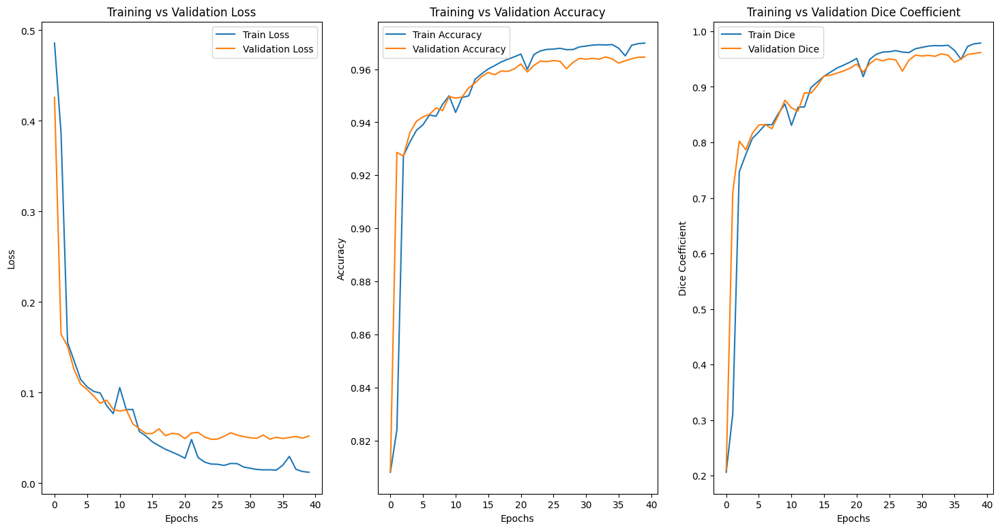

In [18]:
""" plotting the loss and accuracy during training and validation """
plt.figure(figsize=(18, 9))
plt.subplot(1, 3, 1)
plt.plot(unet_history.history['loss'])
plt.plot(unet_history.history['val_loss'])
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training vs Validation Loss')
plt.legend(['Train Loss', 'Validation Loss'])
plt.subplot(1, 3, 2)
plt.plot(unet_history.history['accuracy'])
plt.plot(unet_history.history['val_accuracy'])
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.title('Training vs Validation Accuracy')
plt.legend(['Train Accuracy', 'Validation Accuracy'])
plt.subplot(1, 3, 3)
plt.plot(unet_history.history['dice_coefficient'])
plt.plot(unet_history.history['val_dice_coefficient'])
plt.xlabel('Epochs')
plt.ylabel('Dice Coefficient')
plt.title('Training vs Validation Dice Coefficient')
plt.legend(['Train Dice', 'Validation Dice'])


In [19]:
""" Carregando o modelo salvo """
modelo = keras.models.load_model('modelos/unet_model_512_menosBanco.keras', custom_objects={'dice_coefficient': dice_coefficient})
modelo.evaluate(val_data, verbose= 1)

75/75 ━━━━━━━━━━━━━━━━━━━━ 13s 170ms/step - accuracy: 0.9621 - dice_coefficient: 0.9457 - loss: 0.0481


[0.04810718446969986, 0.9621077179908752, 0.9456951022148132]

In [20]:
""" Função: calcular área (predição vs máscara) na dimensão original (403x333) """
def comparar_area_predicao(
    idx,
    model,
    x_imgs,
    y_masks,
    nomes_dados = None,
    orig_size=(403, 333),
    threshold=0.5,
    px_per_cm=24.05,
    smooth=1e-6,
    plot=False,
    overlay_alpha=0.35,
    contours=True,
    verbose=True,
 ):
    """
    Compara a área da predição com a máscara verdadeira na dimensão original.

    Observação: se x_imgs/y_masks estiverem em 256x256 (por causa do pre-processamento),
    a comparação em 403x333 é feita via resize NEAREST para manter máscara binária.

    Retorna um dicionário com áreas (px² e cm²), diferença e métricas (Dice/IoU).
    """
    orig_h, orig_w = orig_size  # (H, W)
    cm2_per_px2 = 1.0 / (px_per_cm ** 2)
    # Pega amostra
    x = x_imgs[idx]
    y_true = y_masks[idx]
    # Predição (probabilidade)
    x_in = tf.expand_dims(x, axis=0)
    y_pred = model.predict(x_in, verbose=0)
    y_pred = np.squeeze(y_pred)
    # Binariza
    y_pred_bin = (y_pred >= threshold).astype(np.uint8)
    y_true = np.squeeze(y_true)
    # Se a máscara veio como 0..255, normaliza implicitamente via threshold
    y_true_bin = (y_true >= threshold).astype(np.uint8)
    # Garante 2D
    if y_pred_bin.ndim == 3:
        y_pred_bin = np.squeeze(y_pred_bin)
    if y_true_bin.ndim == 3:
        y_true_bin = np.squeeze(y_true_bin)
    # Resize para dimensão original (OpenCV usa (W,H))
    pred_orig = cv2.resize(y_pred_bin, (orig_w, orig_h), interpolation=cv2.INTER_NEAREST_EXACT)
    true_orig = cv2.resize(y_true_bin, (orig_w, orig_h), interpolation=cv2.INTER_NEAREST_EXACT)
    # Áreas (px²) e (cm²)
    area_pred_px = int(pred_orig.sum())
    area_true_px = int(true_orig.sum())
    area_pred_cm2 = area_pred_px * cm2_per_px2
    area_true_cm2 = area_true_px * cm2_per_px2
    diff_px = area_pred_px - area_true_px
    diff_cm2 = diff_px * cm2_per_px2
    perc_diff = (100.0 * diff_px / area_true_px) if area_true_px > 0 else np.nan
    # Métricas na dimensão original
    intersection = int((pred_orig & true_orig).sum())
    union = int((pred_orig | true_orig).sum())
    dice = (2.0 * intersection + smooth) / (area_pred_px + area_true_px + smooth)
    iou = (intersection + smooth) / (union + smooth)
    result = {
        'idx': idx,
        'orig_size': (orig_h, orig_w),
        'threshold': float(threshold),
        'px_per_cm': float(px_per_cm),
        'area_pred_px2': area_pred_px,
        'area_true_px2': area_true_px,
        'area_pred_cm2': float(area_pred_cm2),
        'area_true_cm2': float(area_true_cm2),
        'diff_px2': int(diff_px),
        'diff_cm2': float(diff_cm2),
        'perc_diff_%': float(perc_diff) if not np.isnan(perc_diff) else np.nan,
        'dice_orig': float(dice),
        'iou_orig': float(iou),
    }
    if verbose:
        print(
            f"idx={idx} | area_true={area_true_cm2:.3f} cm² | "
            f"area_pred={area_pred_cm2:.3f} cm² | diff={np.abs(diff_cm2):+.3f} cm² | "
            f"dice={dice:.4f} | iou={iou:.4f}"
        )
    if plot:
        img = np.squeeze(x)
        # Mostra na dimensão do modelo (p/ referência) e overlays na dimensão original
        plt.figure(figsize=(14, 5))
        plt.subplot(1, 3, 1)
        plt.imshow(img, cmap='gray')
        if nomes_dados is not None and len(nomes_dados) > idx:
            plt.title(f'Imagem (modelo) idx={idx} | {nomes_dados[idx][2:6]}')
        else:
            plt.title(f'Imagem (modelo) idx={idx}')
        plt.axis('off')
        plt.subplot(1, 3, 2)
        plt.imshow(true_orig, cmap='gray')
        plt.title(f'Máscara verdadeira (orig {orig_h}x{orig_w})')
        plt.axis('off')
        plt.subplot(1, 3, 3)
        plt.imshow(pred_orig, cmap='gray')
        plt.title(f'Máscara predita (orig {orig_h}x{orig_w})')
        plt.axis('off')
        plt.show()
        # Overlay (opcional)
        plt.figure(figsize=(7, 7))
        plt.imshow(cv2.resize(img, (orig_w, orig_h), interpolation=cv2.INTER_LINEAR), cmap='gray') # Plano de fundo
        plt.imshow(true_orig, cmap='Reds', alpha=overlay_alpha, vmin=0, vmax=1)
        plt.imshow(pred_orig, cmap='Blues', alpha=overlay_alpha, vmin=0, vmax=1)
        if contours:
            try:
                plt.contour(true_orig, levels=[0.5], colors='red', linewidths=1)
                plt.contour(pred_orig, levels=[0.5], colors='deepskyblue', linewidths=1)
            except Exception:
                pass
        plt.title(f'Overlay (orig) idx={idx} | true=vermelho | pred=azul')
        plt.axis('off')
        plt.show()
    return result

idx=0 | area_true=37.413 cm² | area_pred=37.816 cm² | diff=+0.403 cm² | dice=0.9630 | iou=0.9286


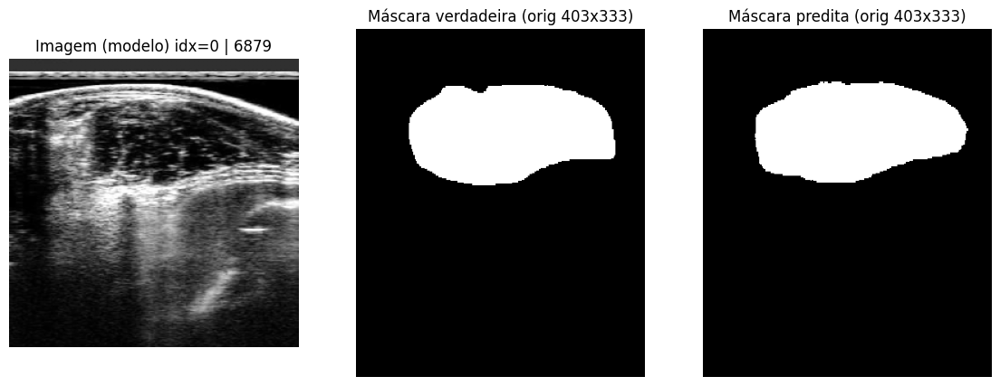

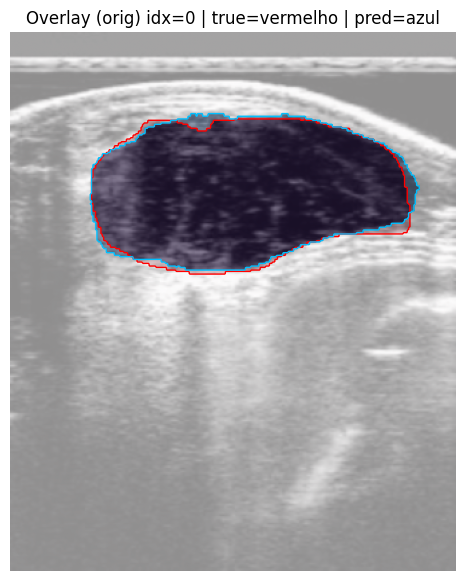

idx=1 | area_true=53.324 cm² | area_pred=51.542 cm² | diff=+1.782 cm² | dice=0.9737 | iou=0.9488


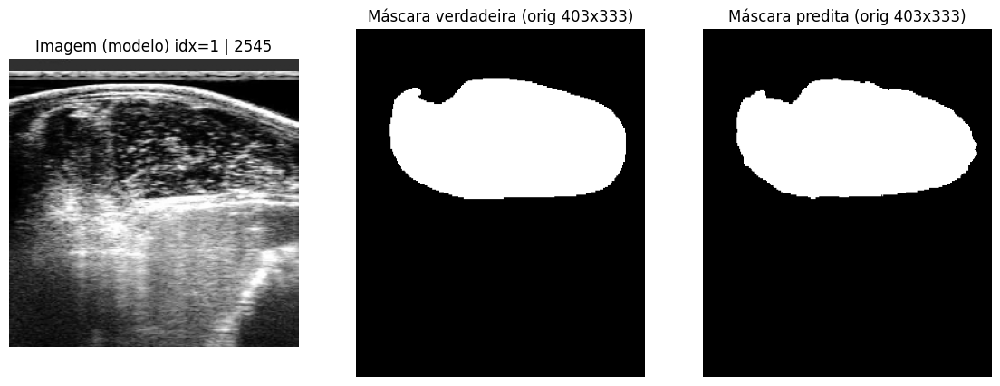

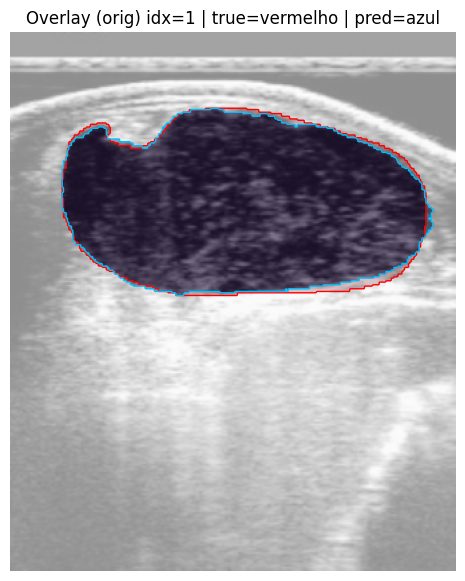

idx=2 | area_true=43.203 cm² | area_pred=42.171 cm² | diff=+1.032 cm² | dice=0.9778 | iou=0.9565


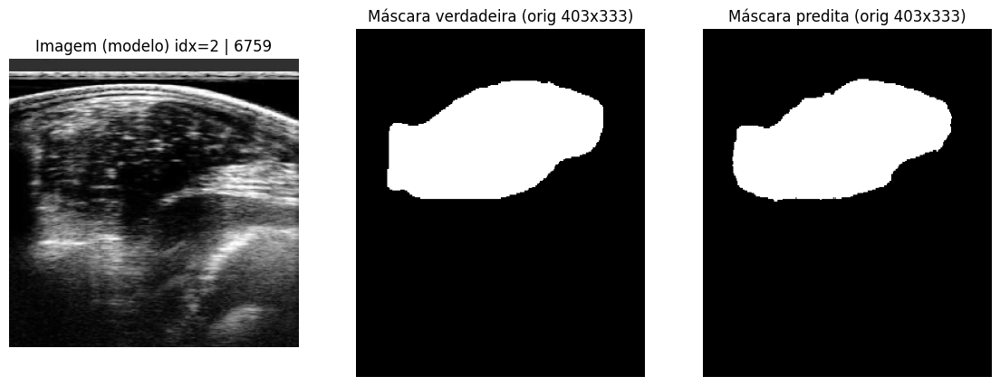

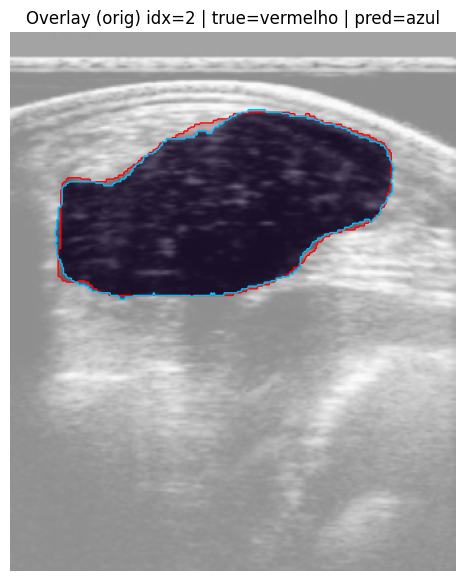

idx=3 | area_true=45.195 cm² | area_pred=45.027 cm² | diff=+0.168 cm² | dice=0.9741 | iou=0.9496


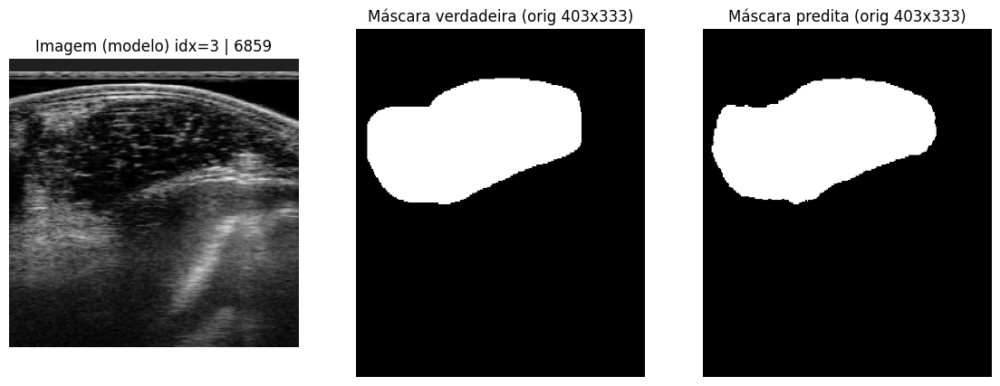

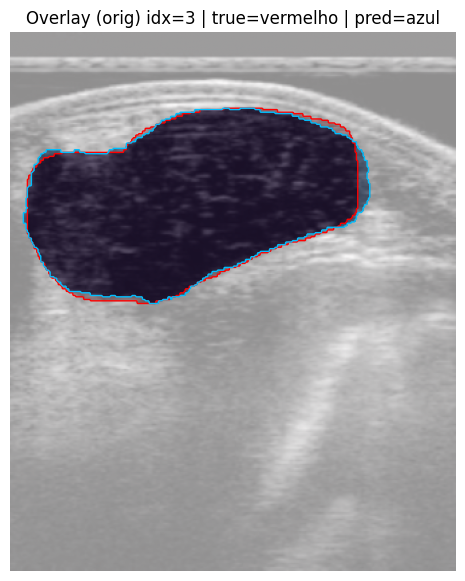

idx=4 | area_true=33.390 cm² | area_pred=34.009 cm² | diff=+0.619 cm² | dice=0.9545 | iou=0.9129


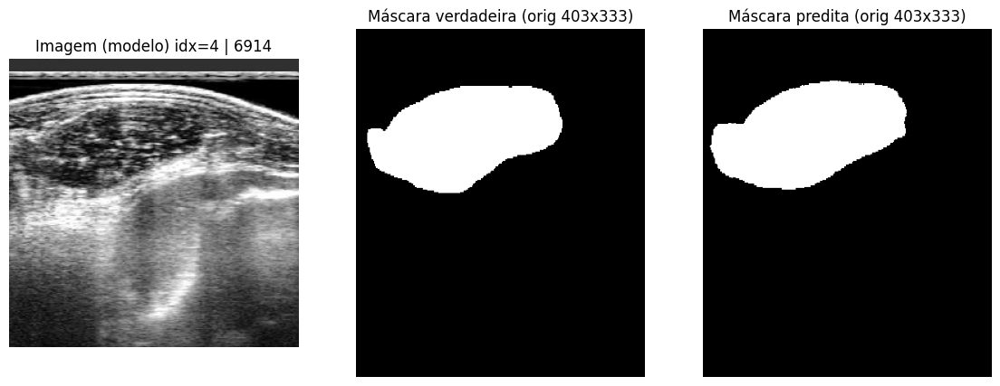

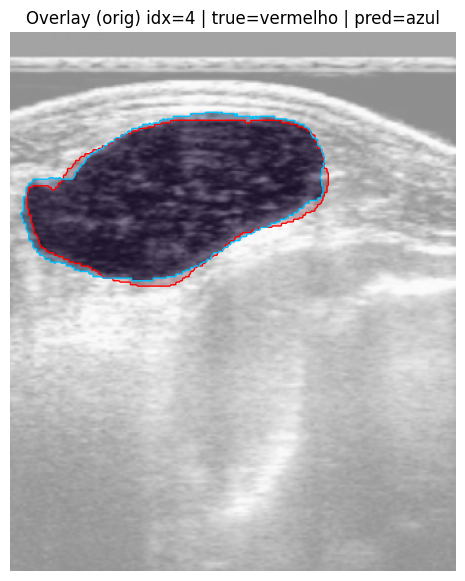

idx=5 | area_true=29.713 cm² | area_pred=28.969 cm² | diff=+0.743 cm² | dice=0.9677 | iou=0.9374


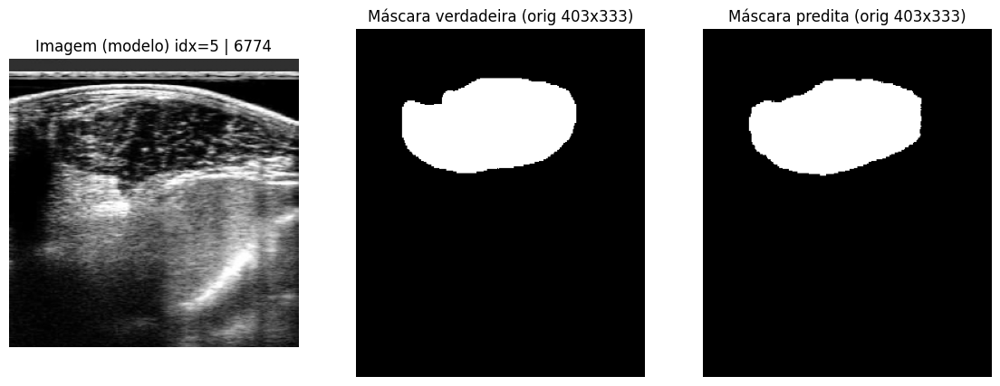

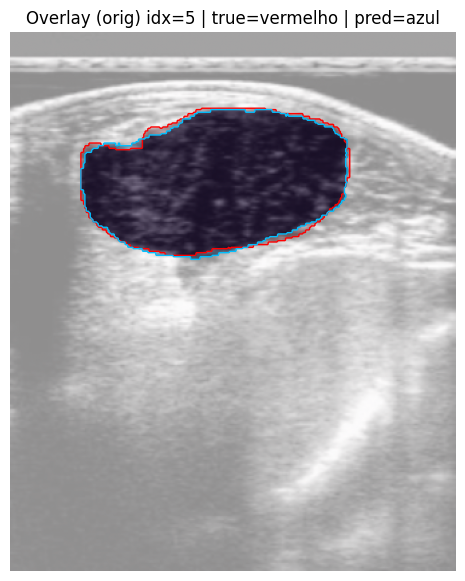

idx=6 | area_true=39.507 cm² | area_pred=38.112 cm² | diff=+1.395 cm² | dice=0.9536 | iou=0.9113


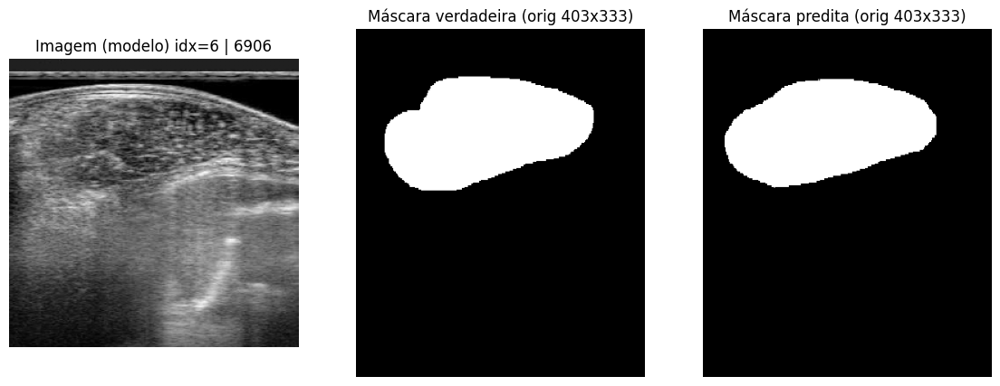

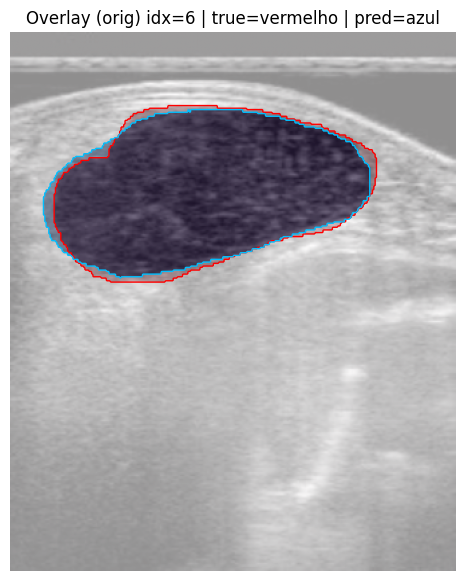

idx=7 | area_true=43.938 cm² | area_pred=43.421 cm² | diff=+0.517 cm² | dice=0.9867 | iou=0.9737


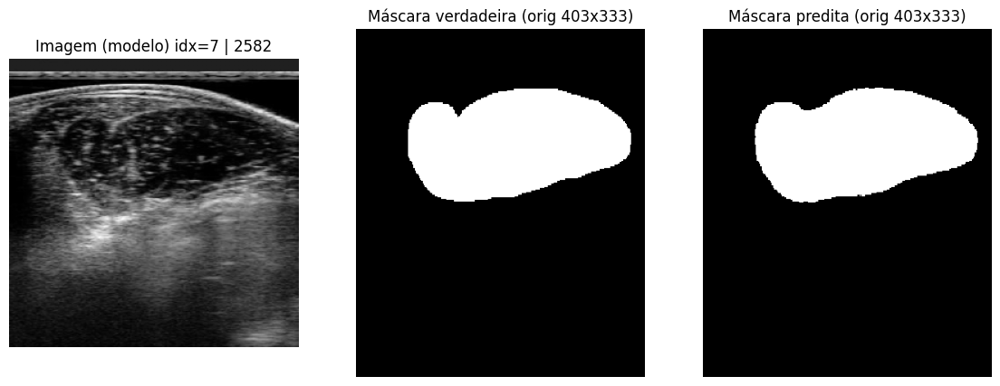

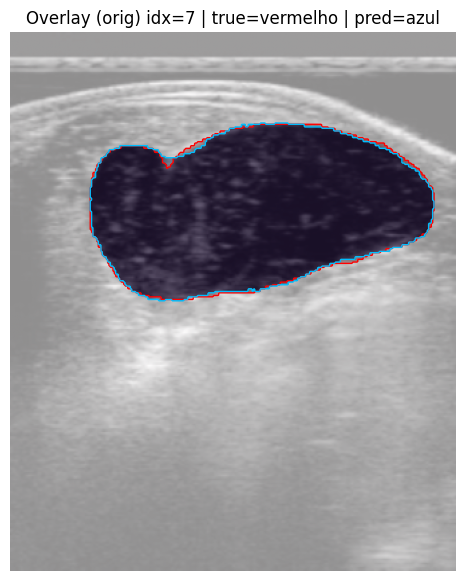

idx=8 | area_true=40.850 cm² | area_pred=44.308 cm² | diff=+3.458 cm² | dice=0.9547 | iou=0.9134


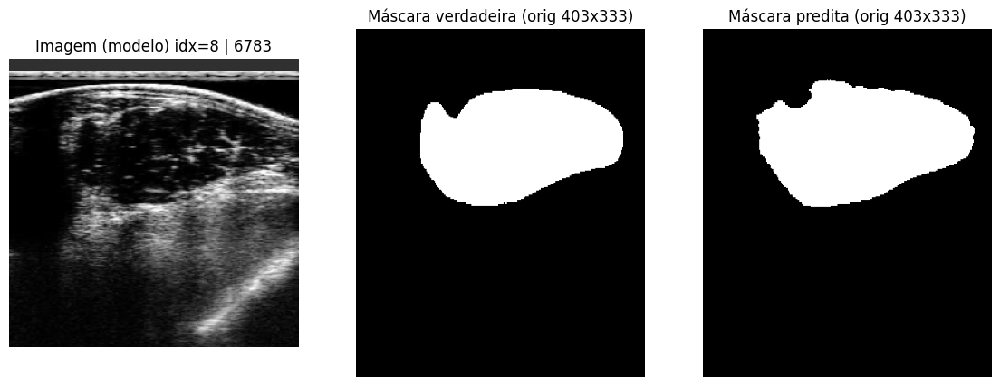

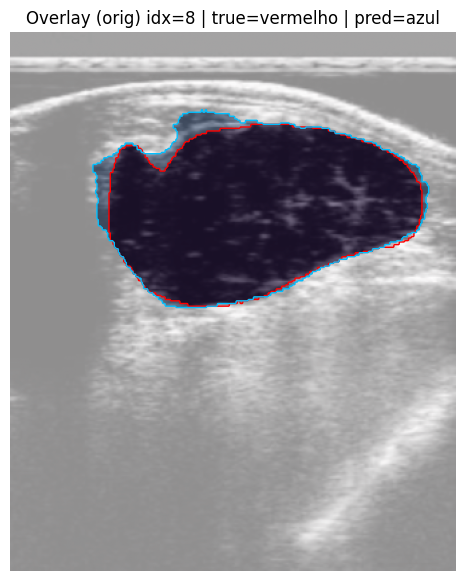

idx=9 | area_true=40.505 cm² | area_pred=40.982 cm² | diff=+0.477 cm² | dice=0.9705 | iou=0.9426


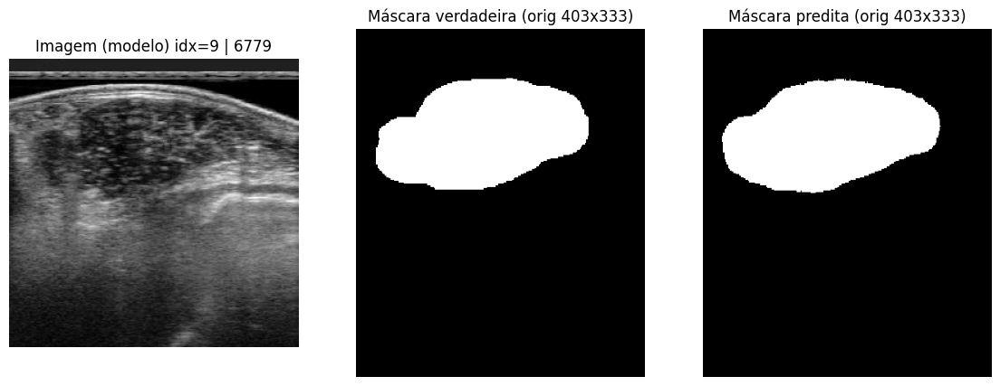

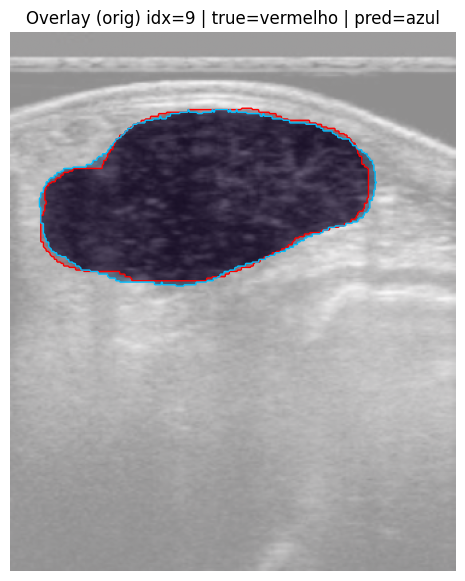

idx=10 | area_true=50.252 cm² | area_pred=47.832 cm² | diff=+2.420 cm² | dice=0.9691 | iou=0.9401


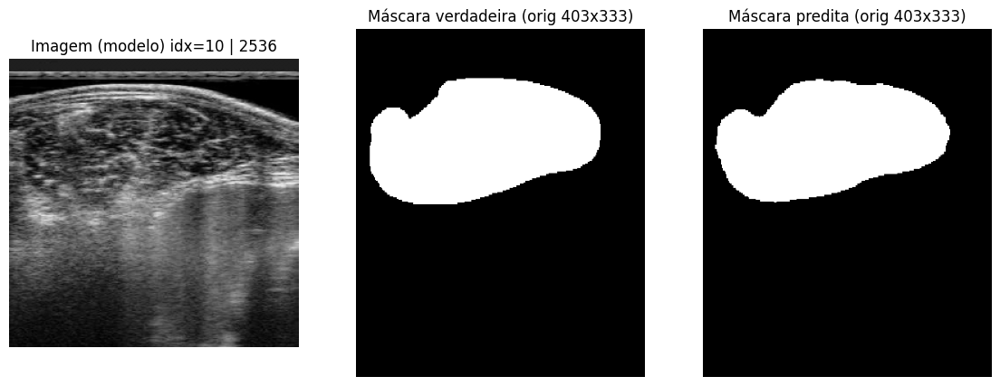

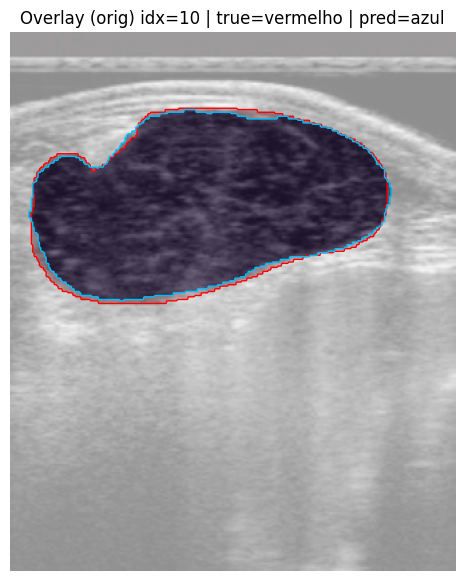

idx=11 | area_true=38.390 cm² | area_pred=38.373 cm² | diff=+0.017 cm² | dice=0.9764 | iou=0.9538


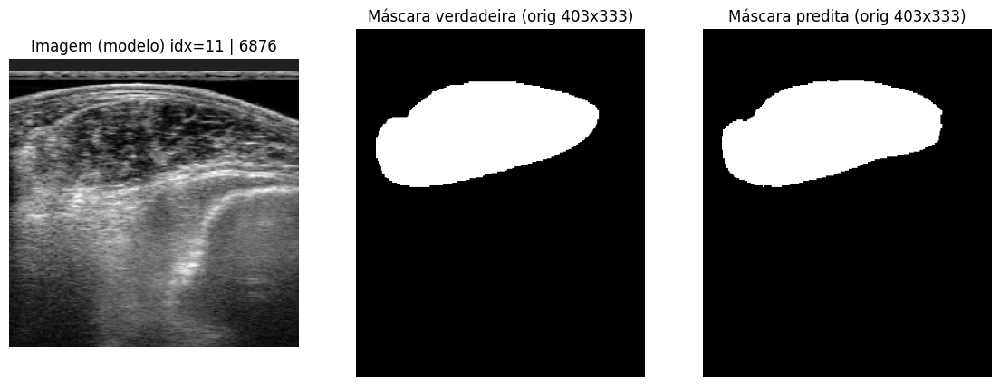

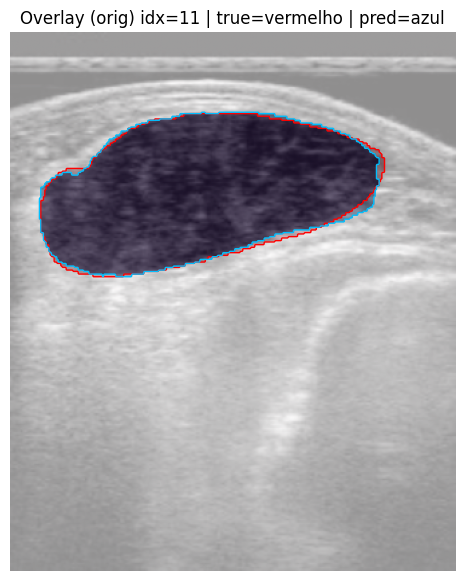

idx=12 | area_true=36.661 cm² | area_pred=36.914 cm² | diff=+0.252 cm² | dice=0.9716 | iou=0.9447


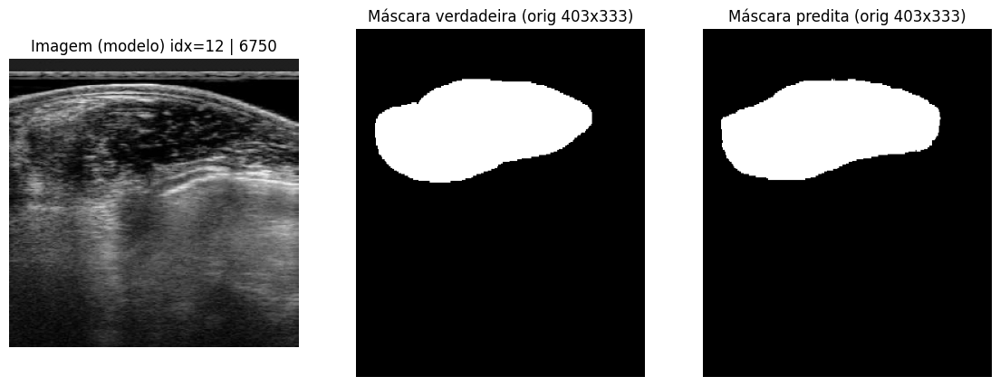

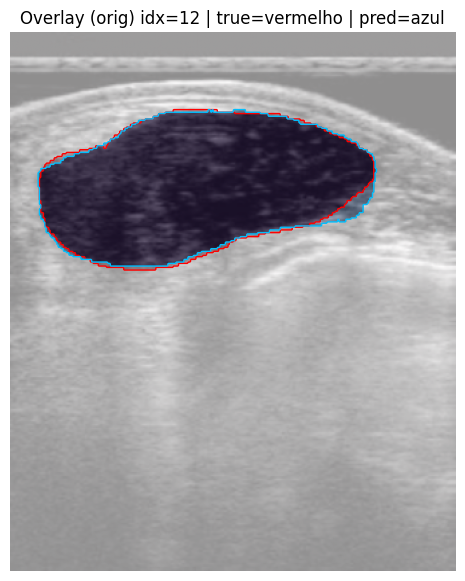

idx=13 | area_true=29.824 cm² | area_pred=33.107 cm² | diff=+3.283 cm² | dice=0.9357 | iou=0.8792


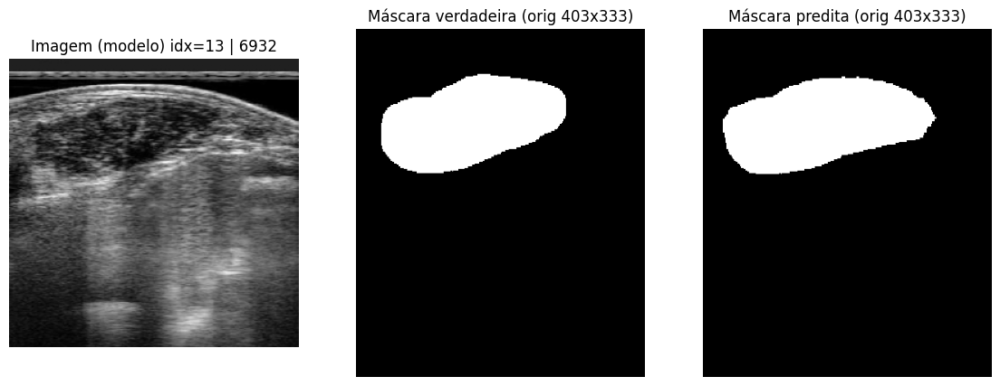

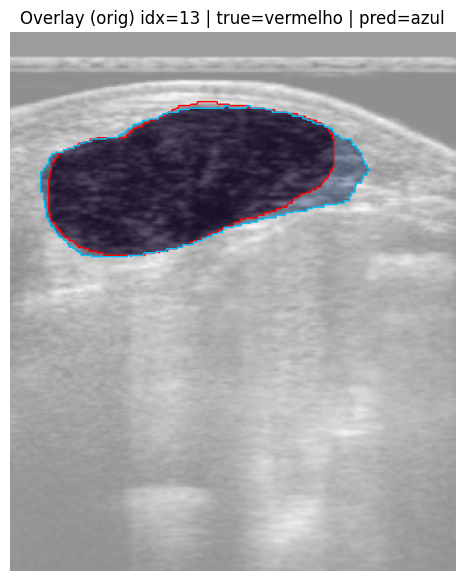

idx=14 | area_true=48.262 cm² | area_pred=47.019 cm² | diff=+1.243 cm² | dice=0.9748 | iou=0.9508


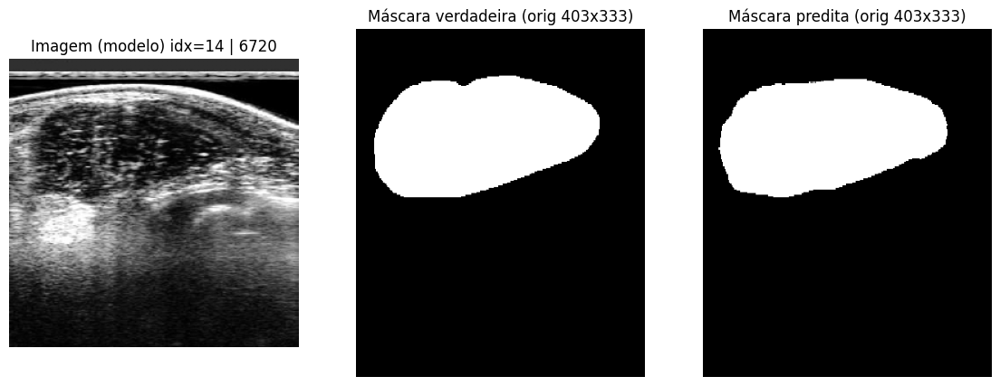

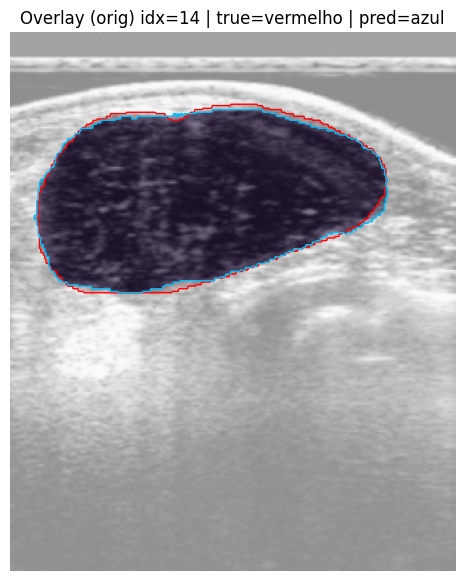

idx=15 | area_true=39.020 cm² | area_pred=36.922 cm² | diff=+2.097 cm² | dice=0.9513 | iou=0.9070


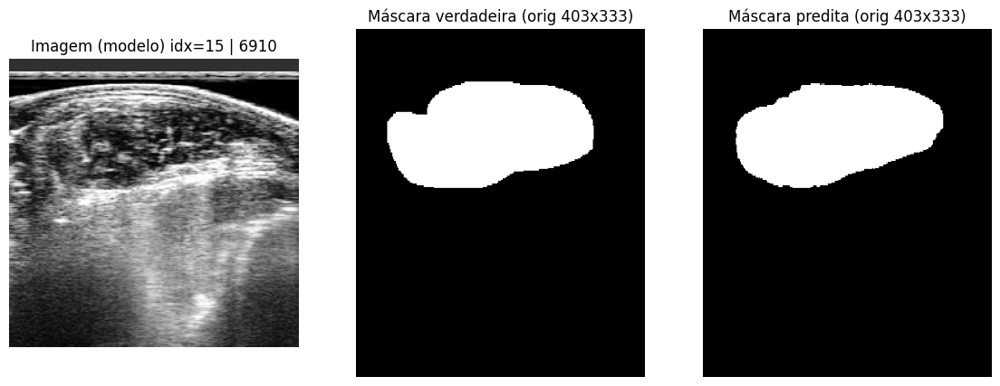

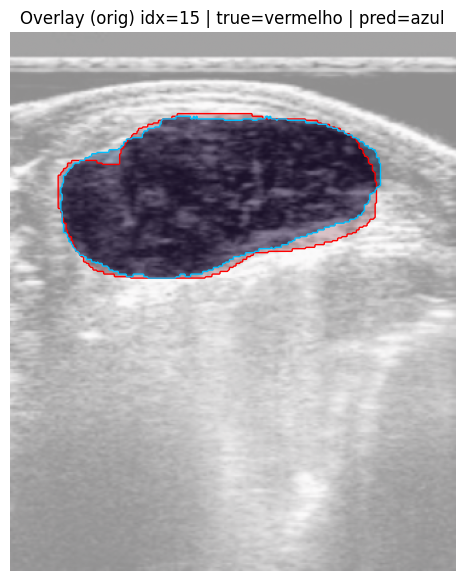

idx=16 | area_true=43.250 cm² | area_pred=43.556 cm² | diff=+0.306 cm² | dice=0.9736 | iou=0.9486


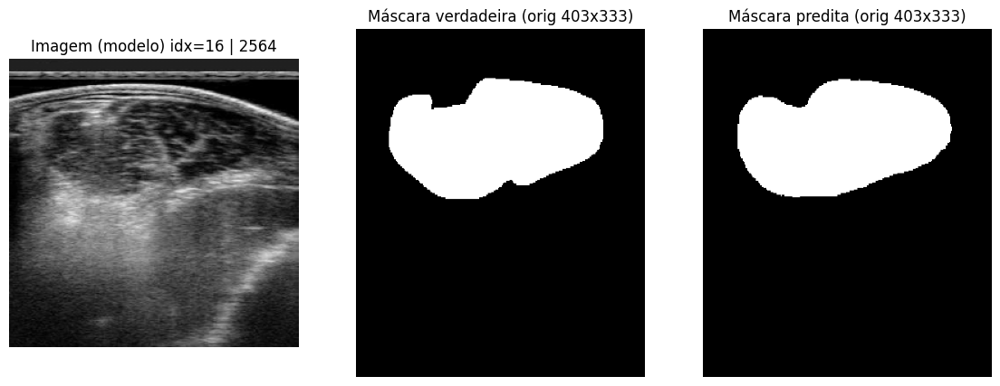

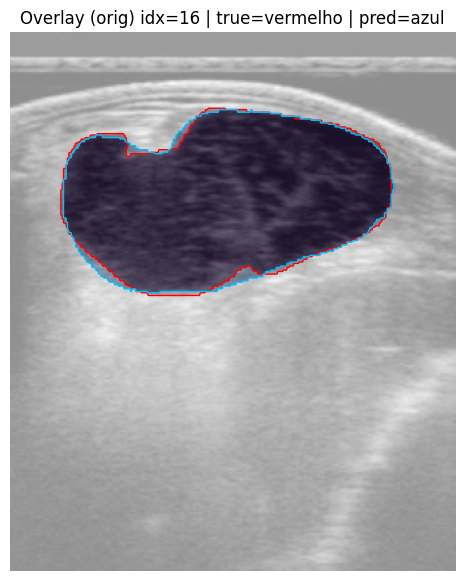

idx=17 | area_true=31.203 cm² | area_pred=33.802 cm² | diff=+2.599 cm² | dice=0.9522 | iou=0.9088


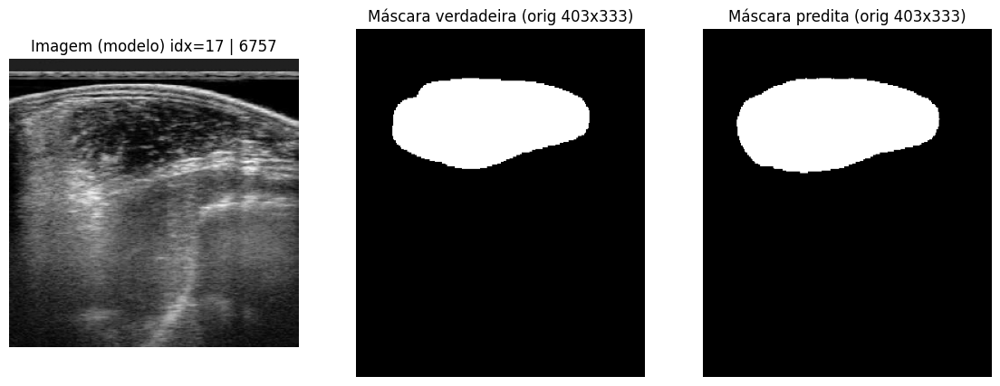

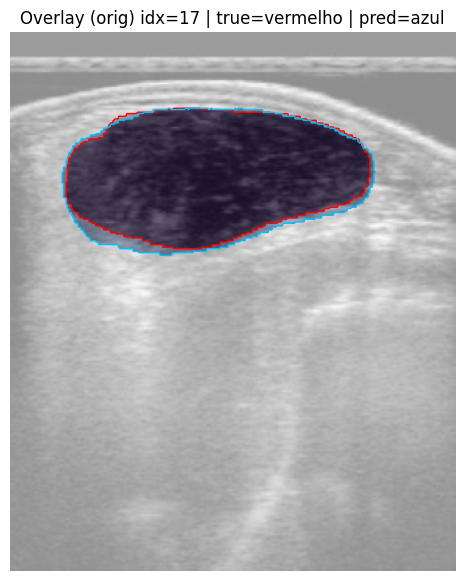

idx=18 | area_true=40.456 cm² | area_pred=39.989 cm² | diff=+0.467 cm² | dice=0.9718 | iou=0.9452


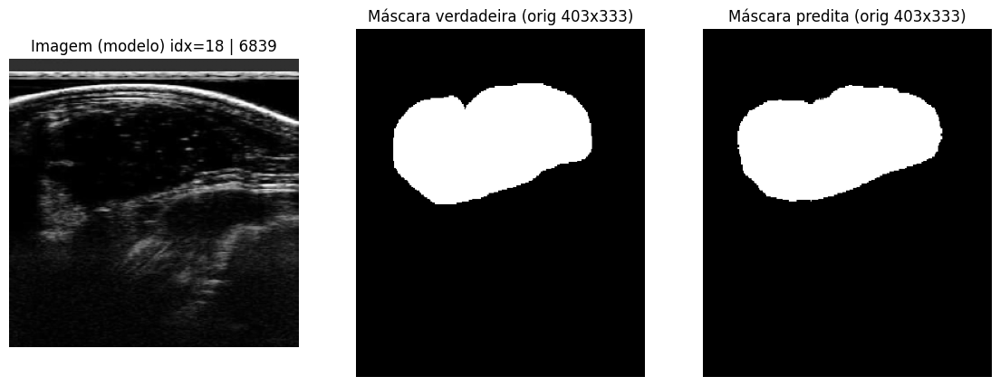

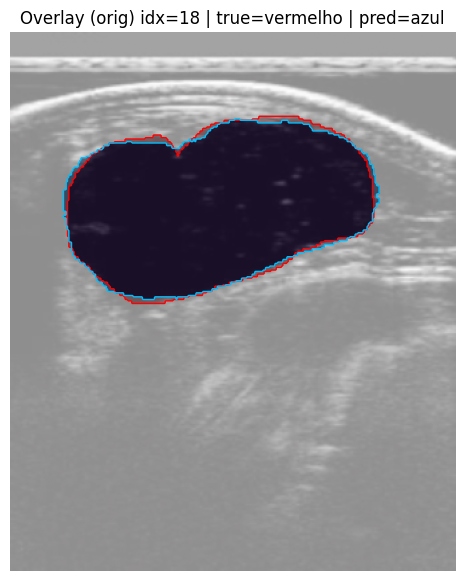

idx=19 | area_true=36.661 cm² | area_pred=37.427 cm² | diff=+0.766 cm² | dice=0.9752 | iou=0.9516


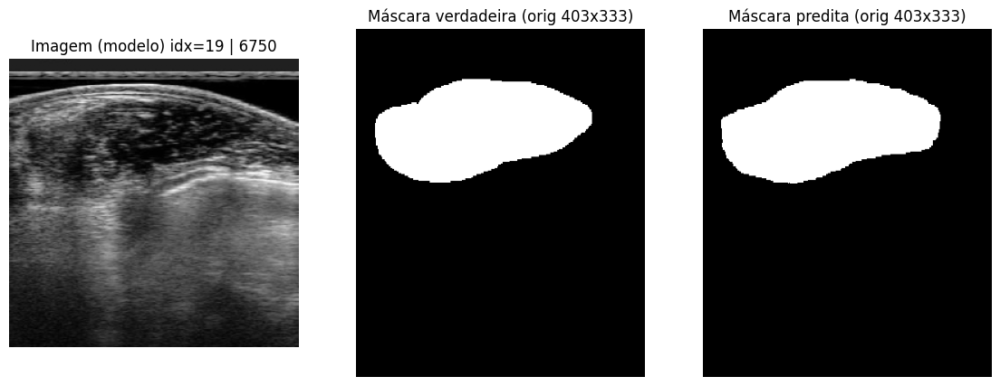

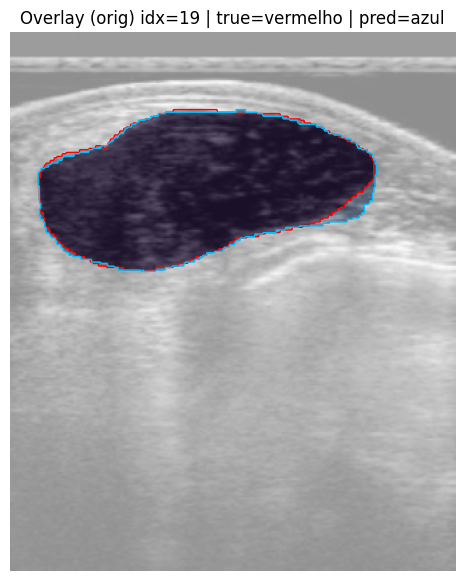

idx=20 | area_true=40.043 cm² | area_pred=37.782 cm² | diff=+2.261 cm² | dice=0.9627 | iou=0.9281


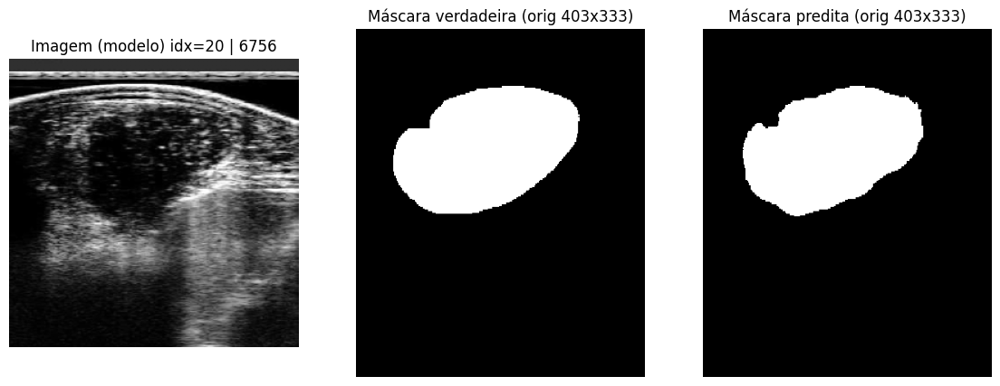

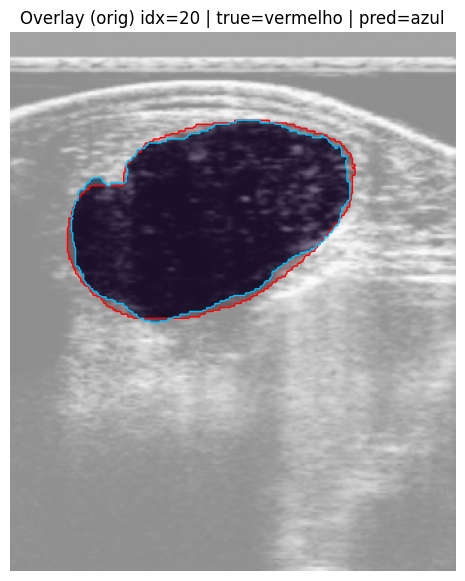

idx=21 | area_true=39.507 cm² | area_pred=39.101 cm² | diff=+0.406 cm² | dice=0.9509 | iou=0.9064


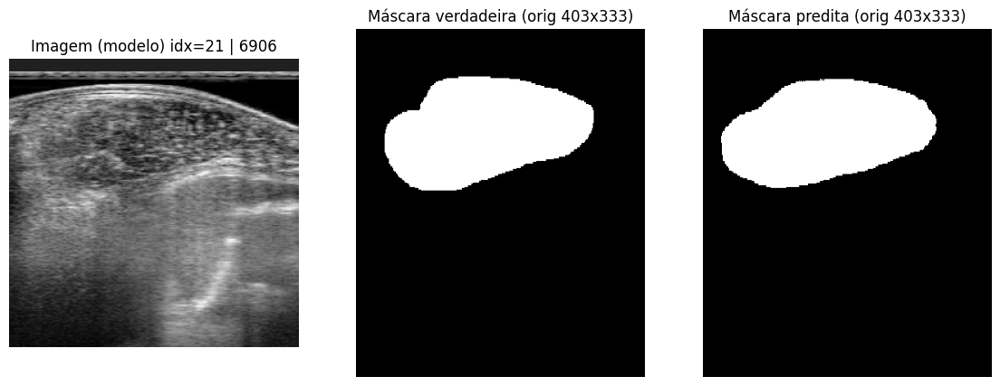

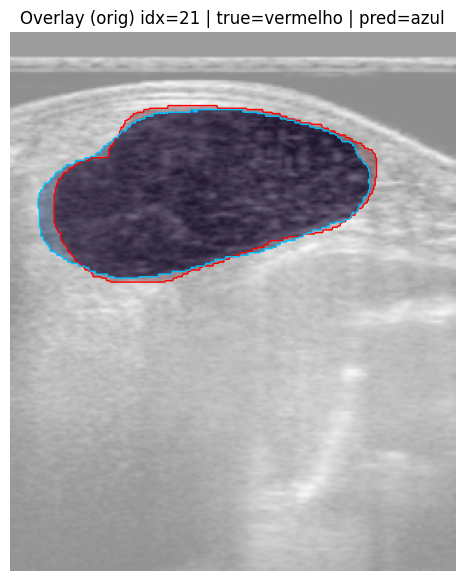

idx=22 | area_true=41.264 cm² | area_pred=39.938 cm² | diff=+1.326 cm² | dice=0.9769 | iou=0.9548


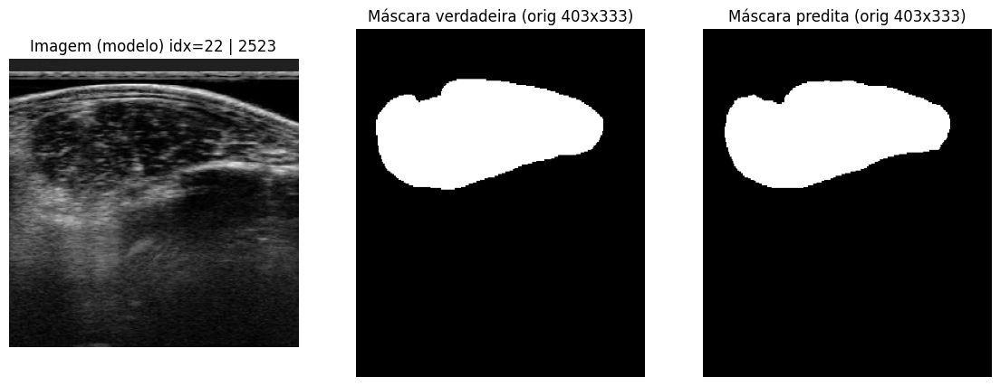

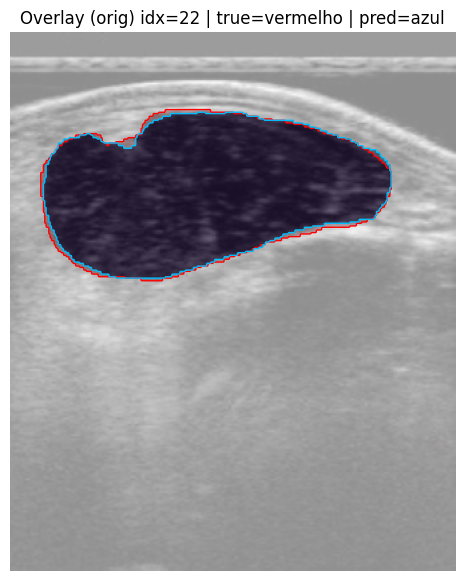

idx=23 | area_true=43.790 cm² | area_pred=42.849 cm² | diff=+0.941 cm² | dice=0.9807 | iou=0.9622


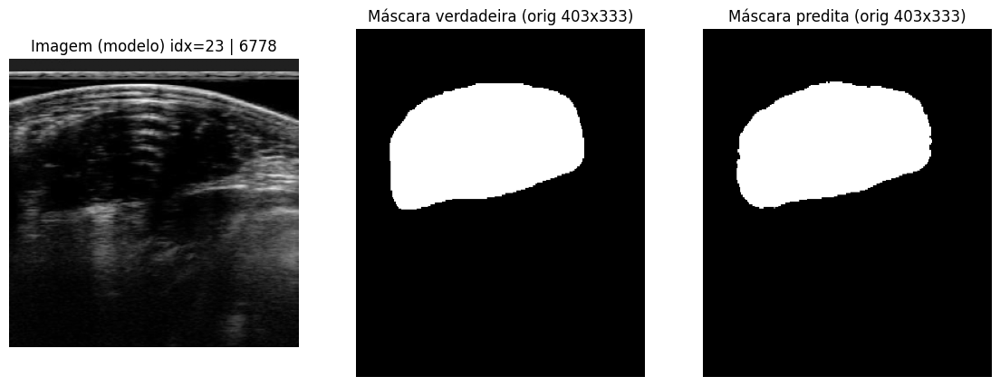

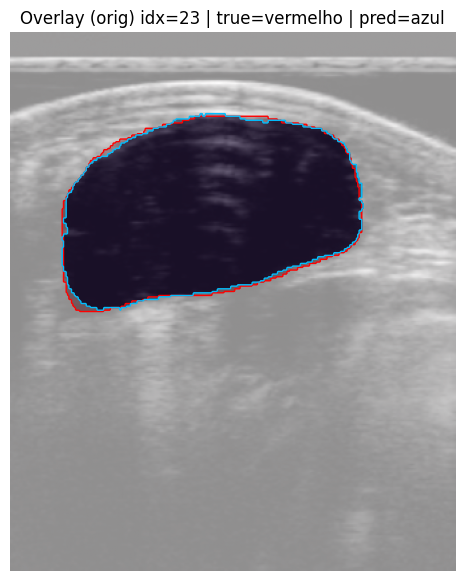

idx=24 | area_true=46.215 cm² | area_pred=45.372 cm² | diff=+0.844 cm² | dice=0.9762 | iou=0.9535


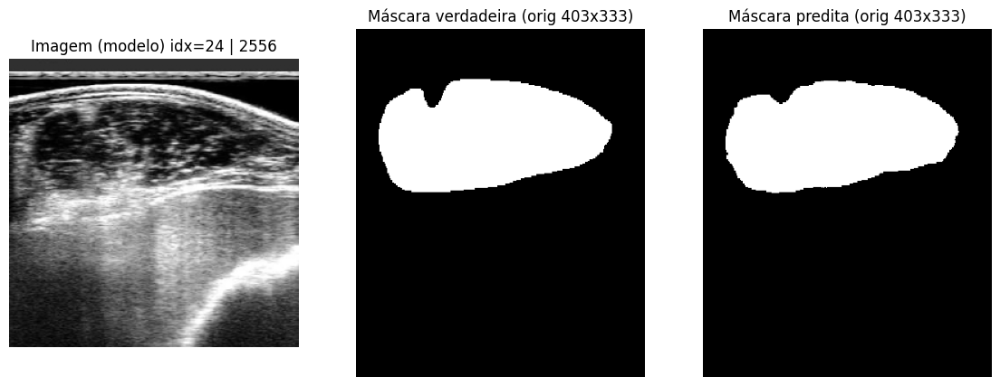

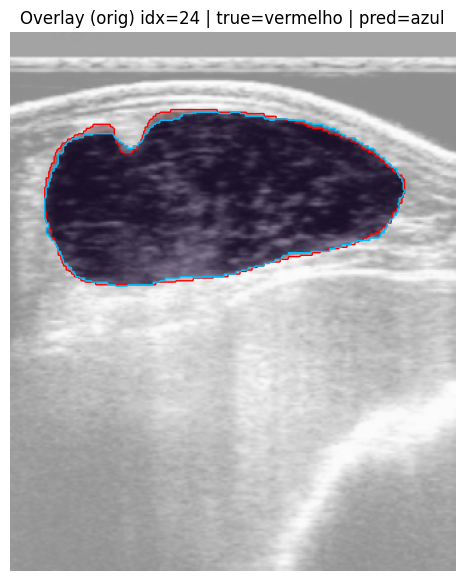

idx=25 | area_true=53.324 cm² | area_pred=50.724 cm² | diff=+2.600 cm² | dice=0.9699 | iou=0.9416


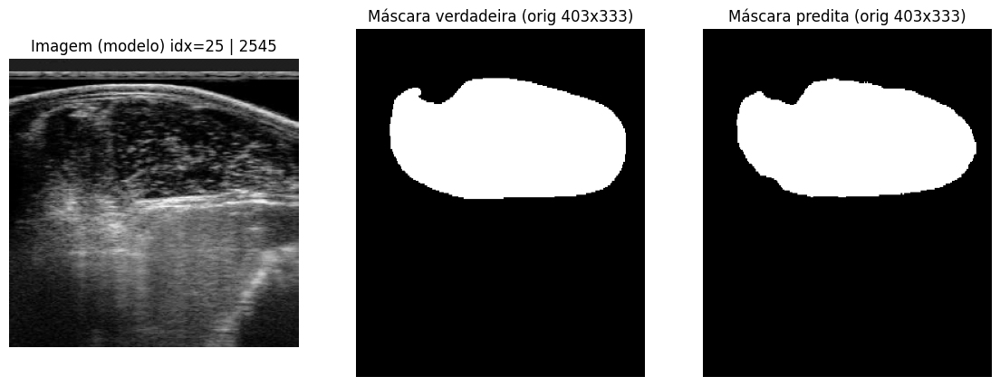

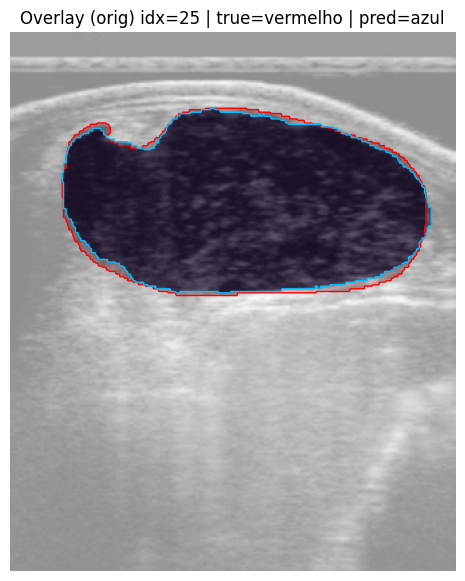

idx=26 | area_true=47.109 cm² | area_pred=46.743 cm² | diff=+0.367 cm² | dice=0.9707 | iou=0.9432


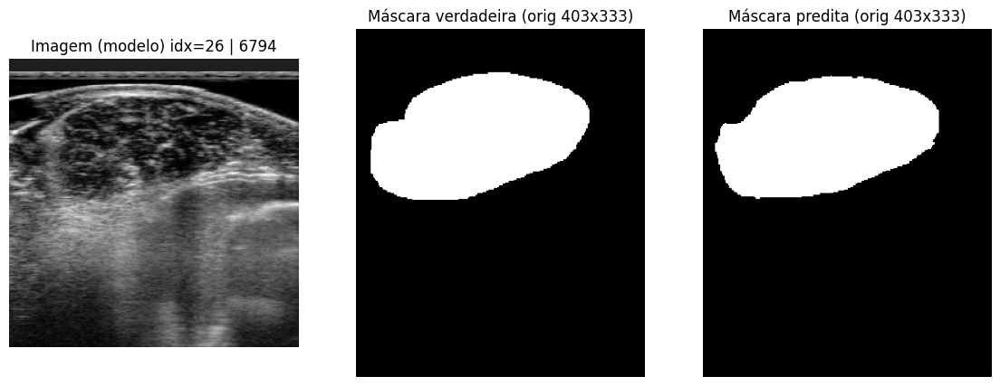

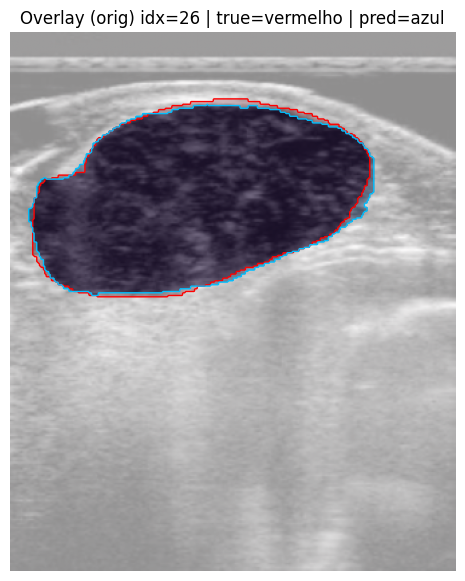

idx=27 | area_true=35.418 cm² | area_pred=35.076 cm² | diff=+0.342 cm² | dice=0.9618 | iou=0.9264


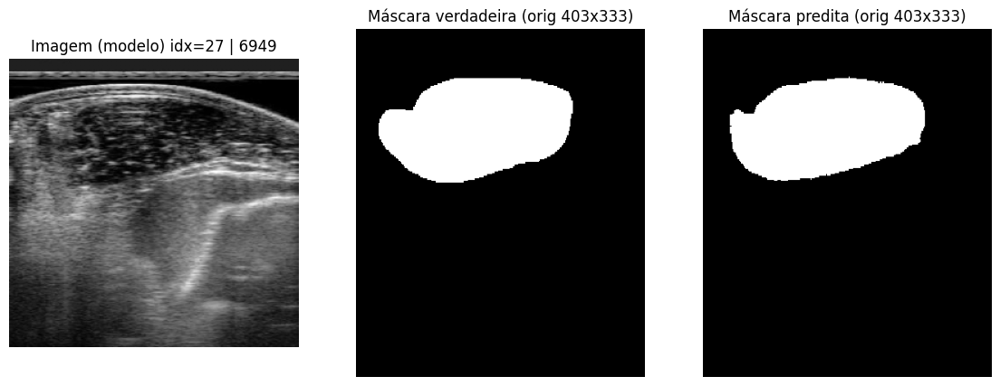

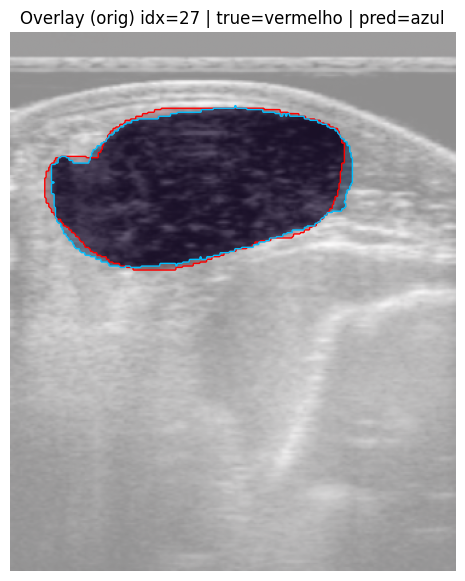

idx=28 | area_true=39.172 cm² | area_pred=36.063 cm² | diff=+3.109 cm² | dice=0.9518 | iou=0.9081


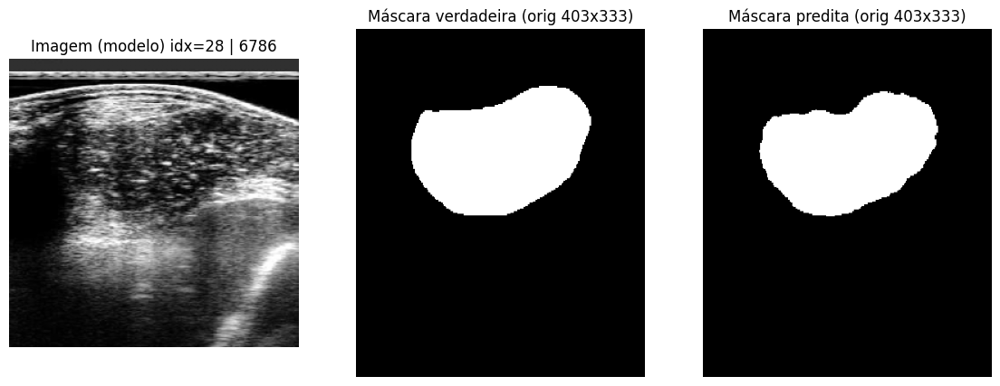

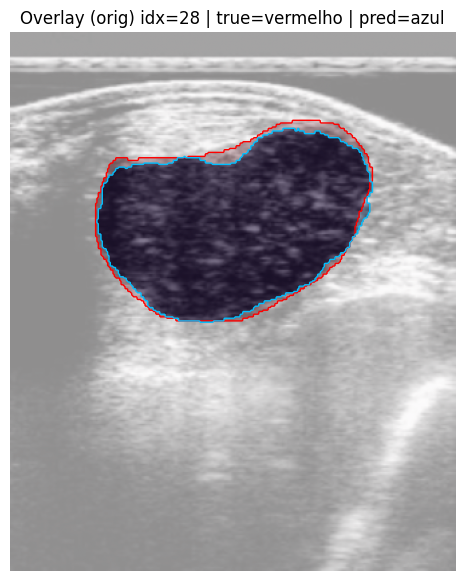

idx=29 | area_true=33.463 cm² | area_pred=34.459 cm² | diff=+0.996 cm² | dice=0.9689 | iou=0.9397


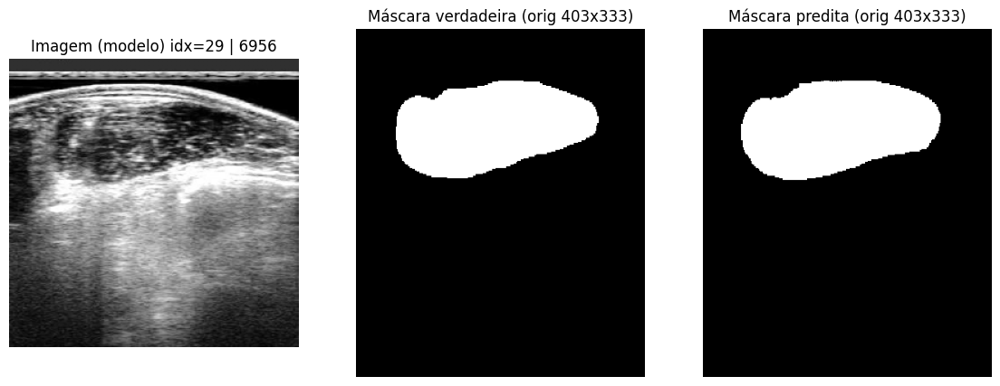

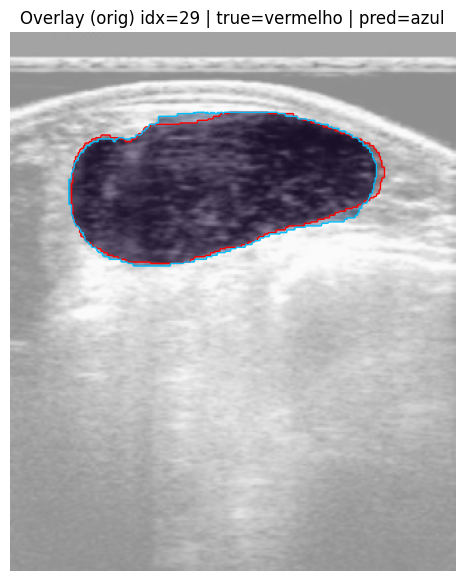

idx=30 | area_true=29.894 cm² | area_pred=29.393 cm² | diff=+0.501 cm² | dice=0.9749 | iou=0.9511


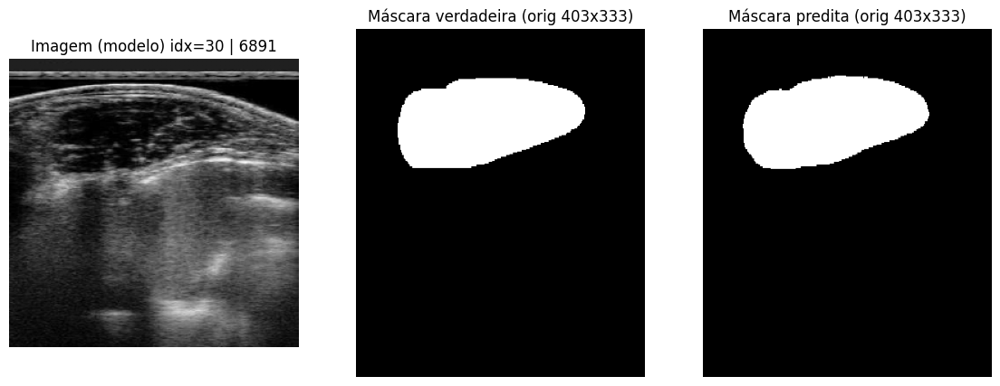

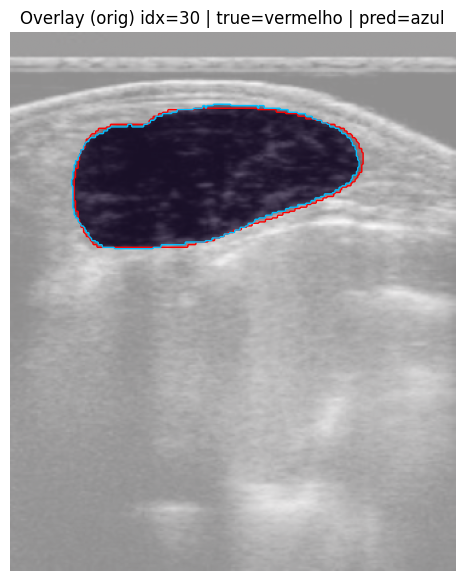

idx=31 | area_true=30.178 cm² | area_pred=30.640 cm² | diff=+0.462 cm² | dice=0.9756 | iou=0.9524


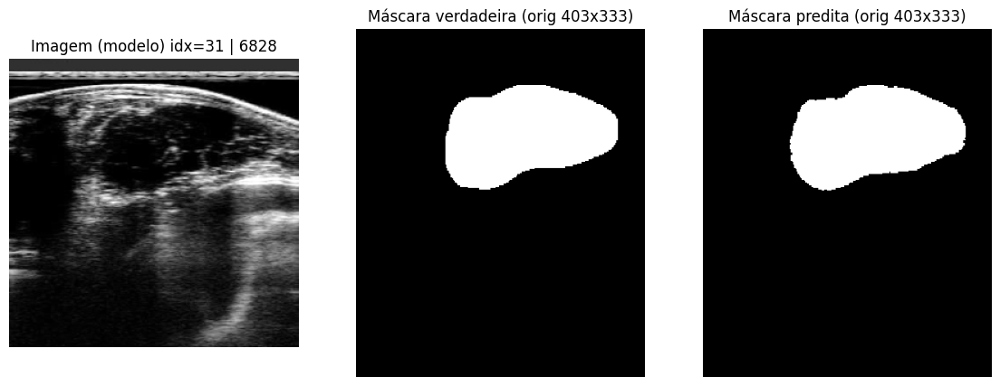

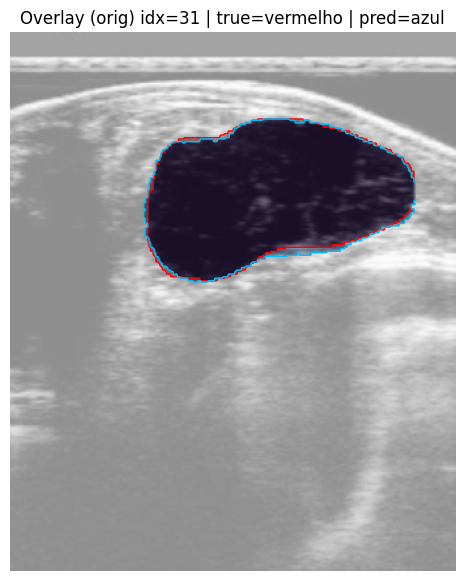

idx=32 | area_true=45.757 cm² | area_pred=45.076 cm² | diff=+0.681 cm² | dice=0.9796 | iou=0.9599


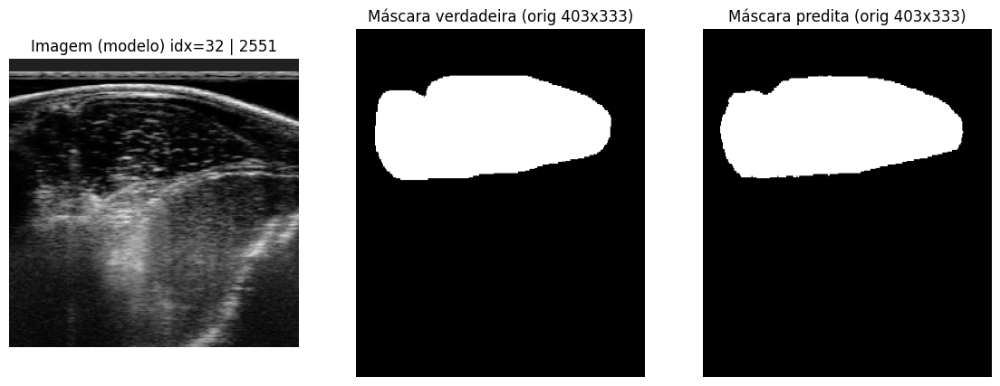

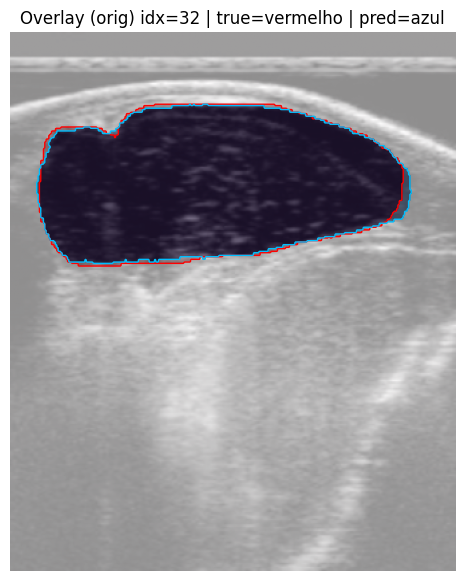

idx=33 | area_true=47.102 cm² | area_pred=49.874 cm² | diff=+2.771 cm² | dice=0.9055 | iou=0.8273


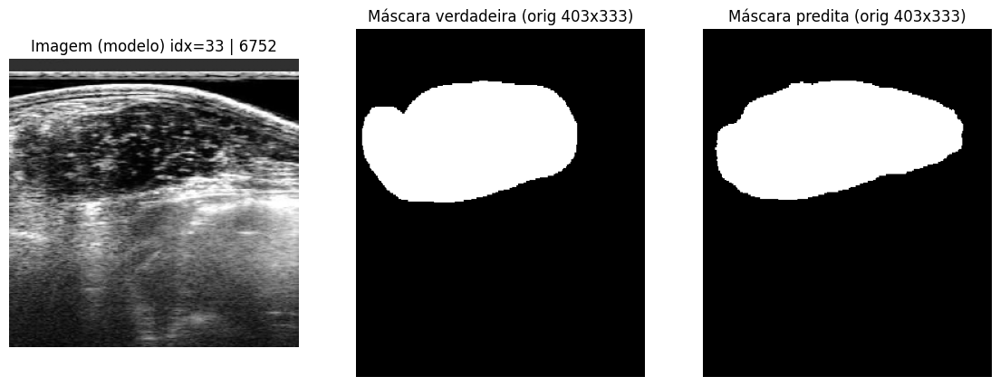

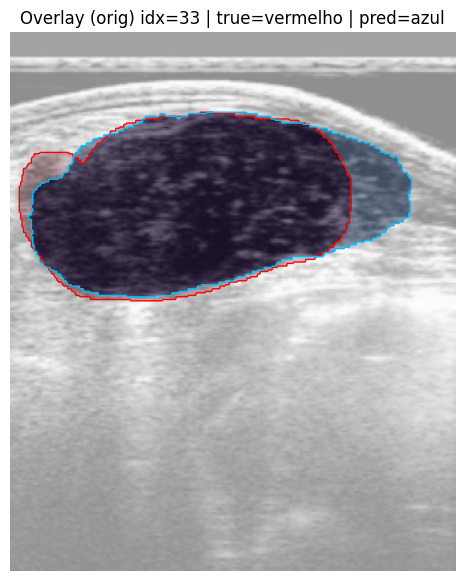

idx=34 | area_true=31.876 cm² | area_pred=32.612 cm² | diff=+0.737 cm² | dice=0.9564 | iou=0.9164


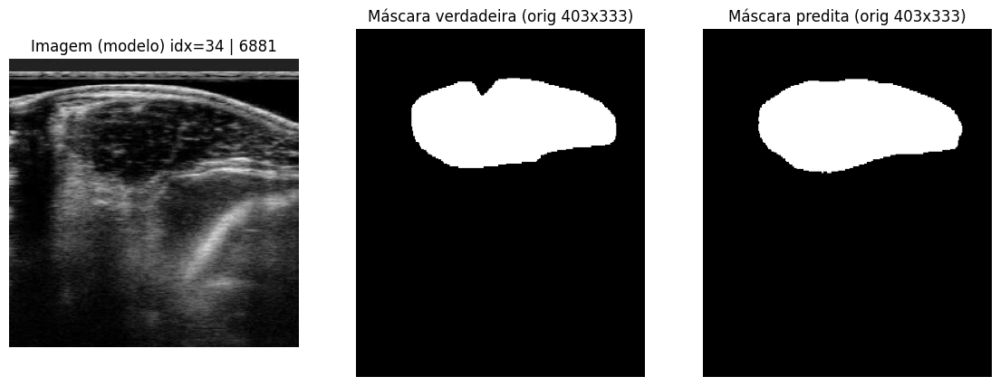

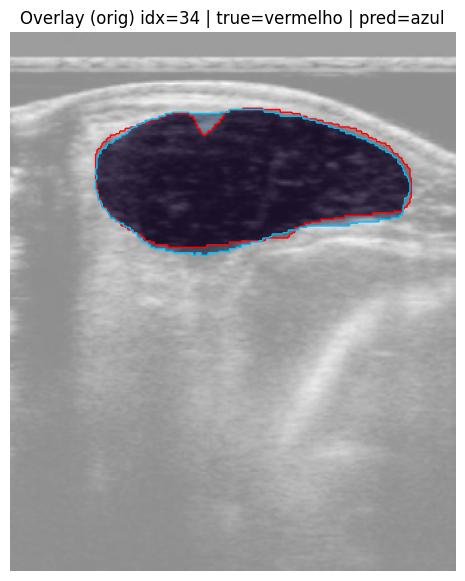

idx=35 | area_true=32.830 cm² | area_pred=32.647 cm² | diff=+0.183 cm² | dice=0.9816 | iou=0.9639


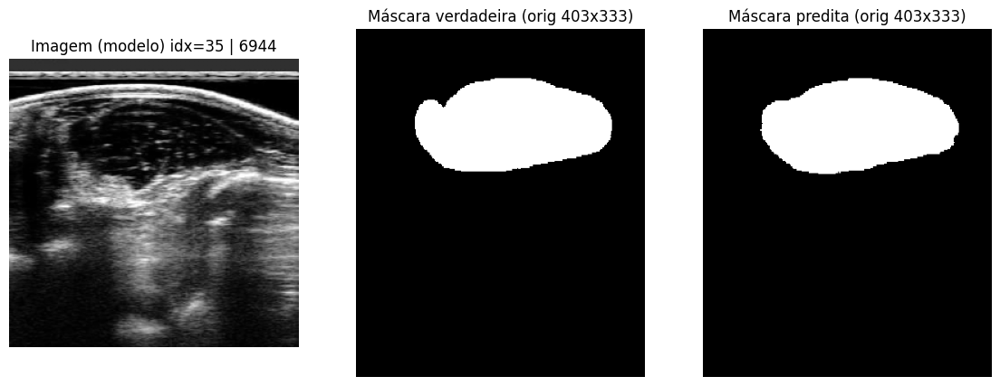

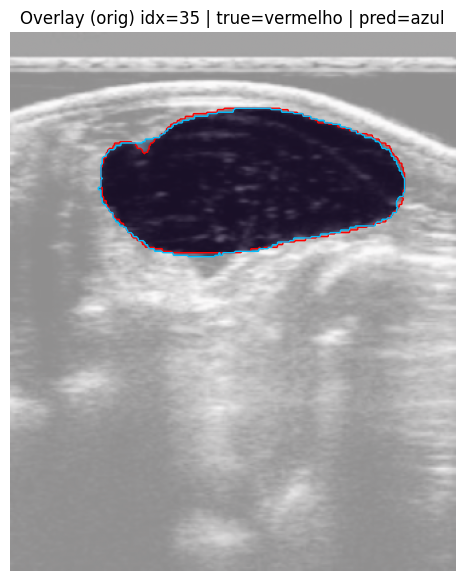

idx=36 | area_true=36.603 cm² | area_pred=35.795 cm² | diff=+0.807 cm² | dice=0.9595 | iou=0.9222


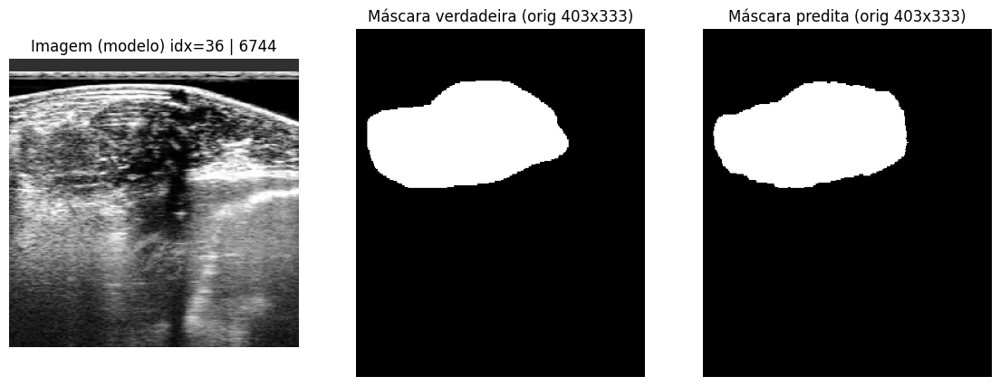

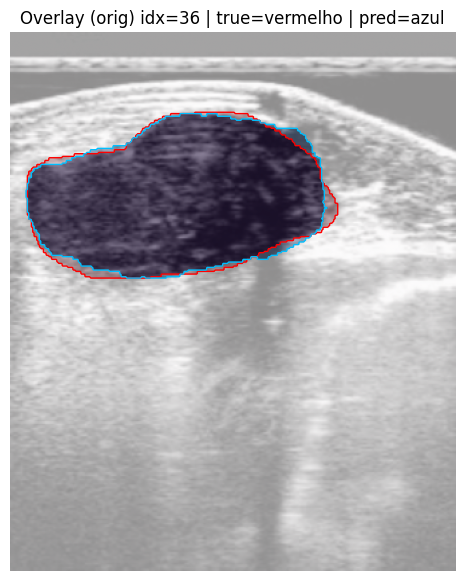

idx=37 | area_true=43.250 cm² | area_pred=44.561 cm² | diff=+1.311 cm² | dice=0.9698 | iou=0.9413


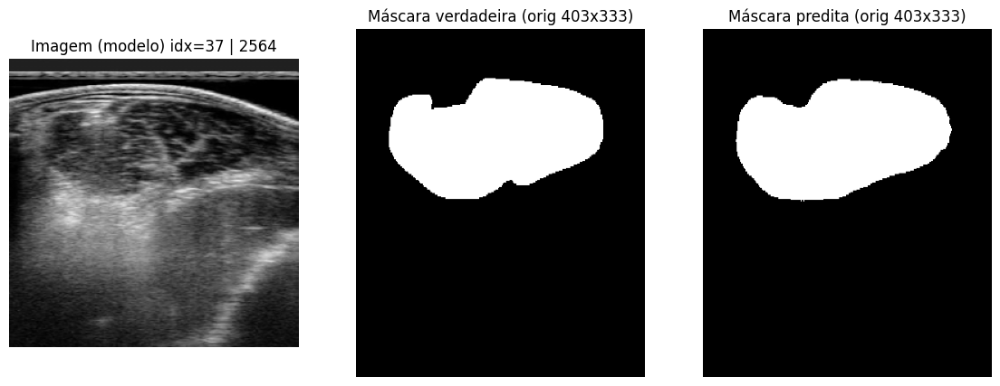

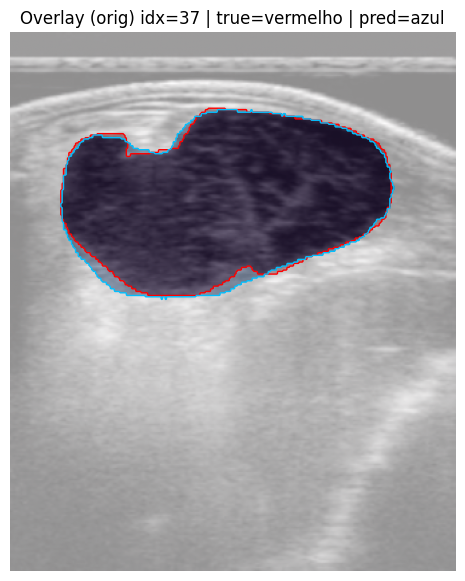

idx=38 | area_true=43.433 cm² | area_pred=52.247 cm² | diff=+8.814 cm² | dice=0.7928 | iou=0.6567


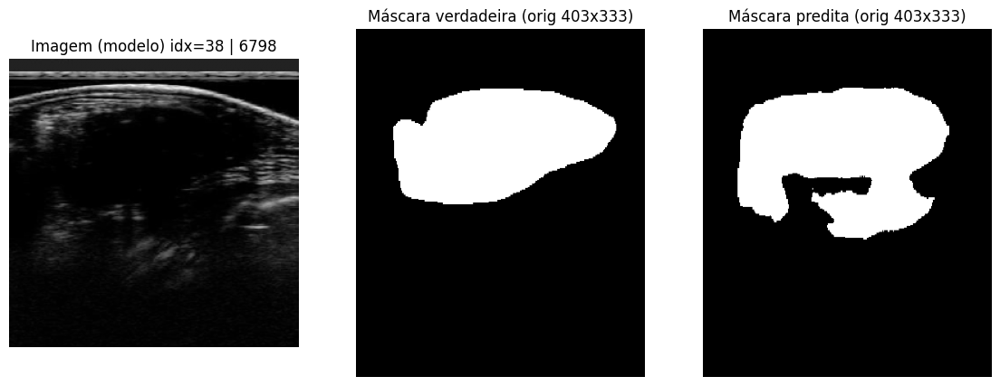

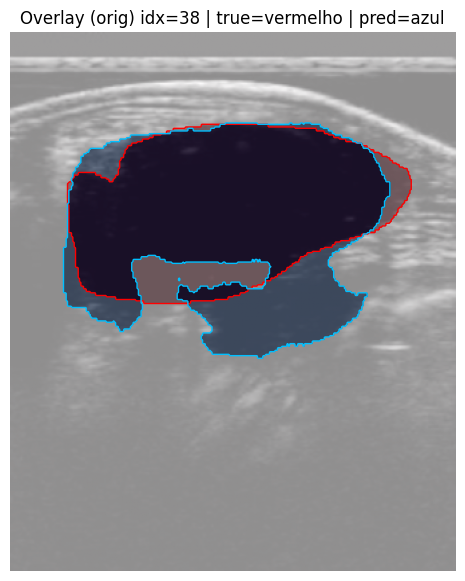

idx=39 | area_true=40.048 cm² | area_pred=39.106 cm² | diff=+0.942 cm² | dice=0.9507 | iou=0.9060


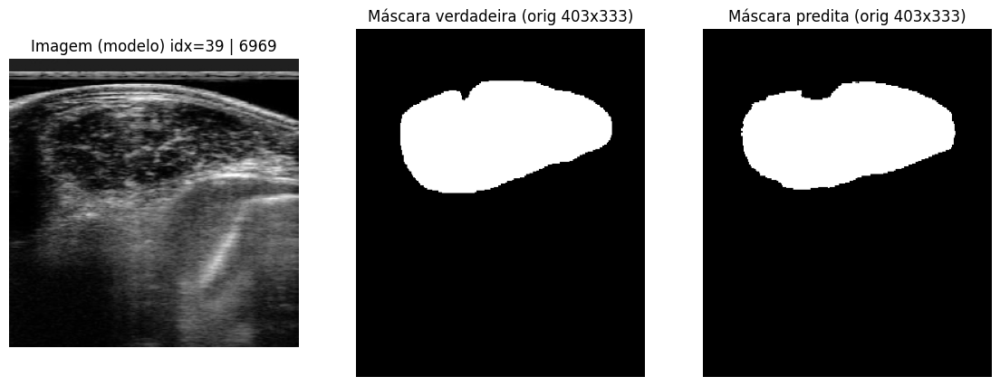

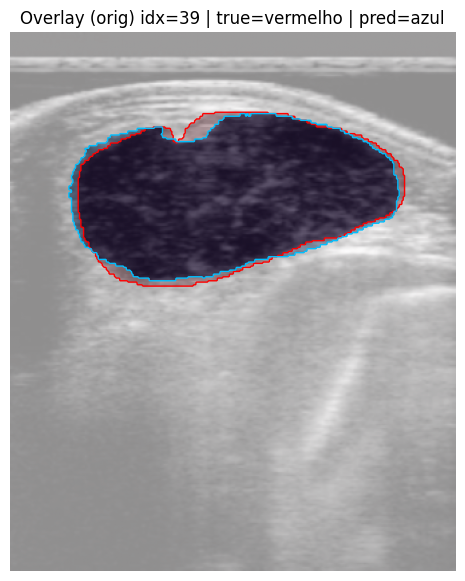

idx=40 | area_true=34.943 cm² | area_pred=35.057 cm² | diff=+0.114 cm² | dice=0.9663 | iou=0.9347


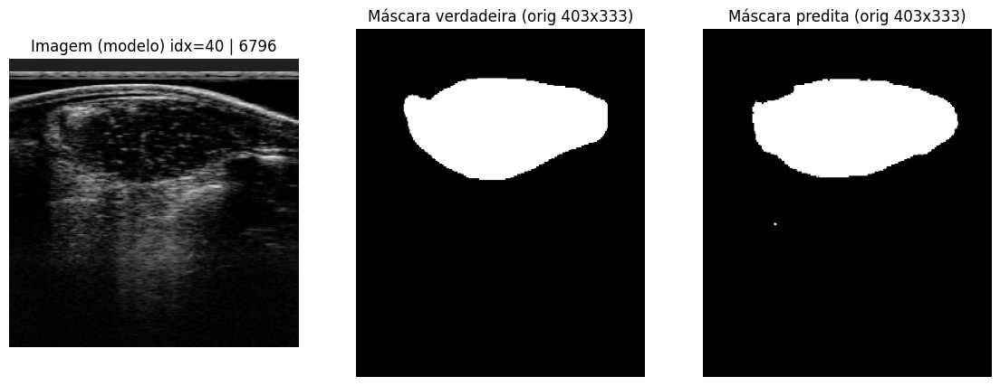

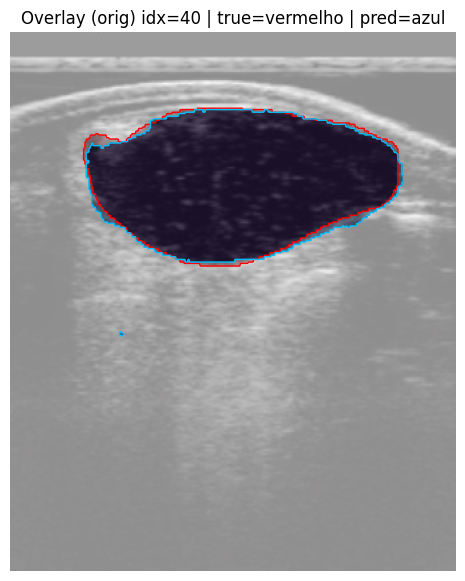

idx=41 | area_true=39.417 cm² | area_pred=38.394 cm² | diff=+1.024 cm² | dice=0.9727 | iou=0.9468


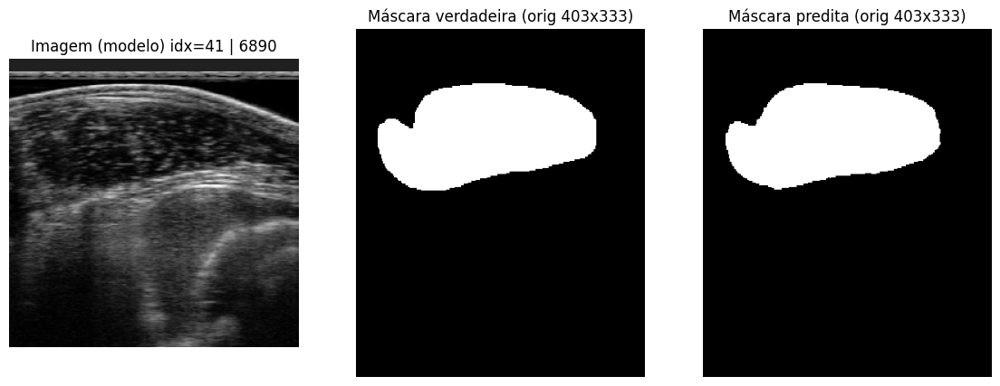

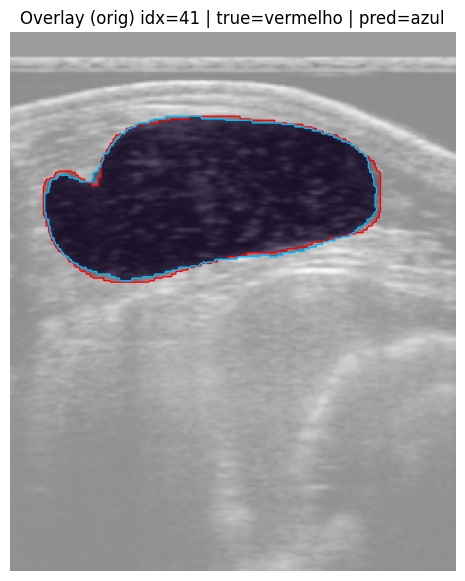

idx=42 | area_true=42.322 cm² | area_pred=46.201 cm² | diff=+3.880 cm² | dice=0.9067 | iou=0.8293


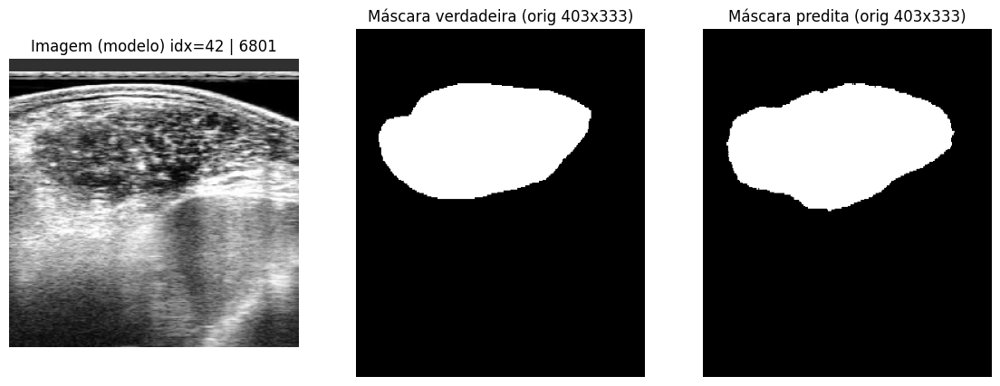

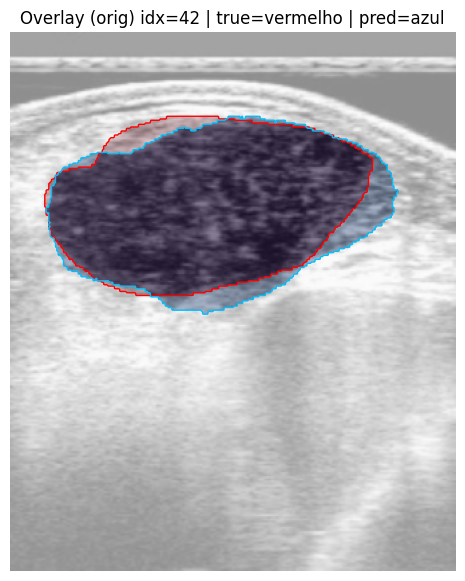

idx=43 | area_true=37.005 cm² | area_pred=34.666 cm² | diff=+2.339 cm² | dice=0.9583 | iou=0.9200


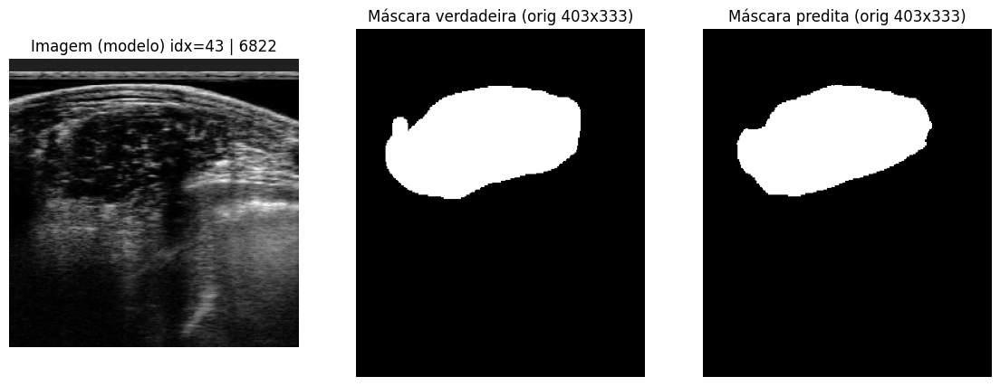

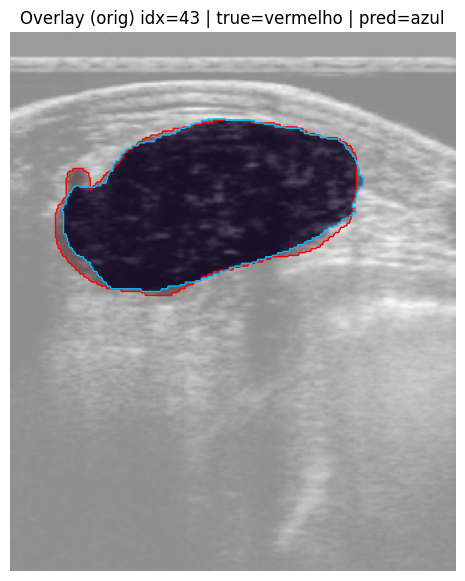

idx=44 | area_true=39.020 cm² | area_pred=37.386 cm² | diff=+1.634 cm² | dice=0.9558 | iou=0.9154


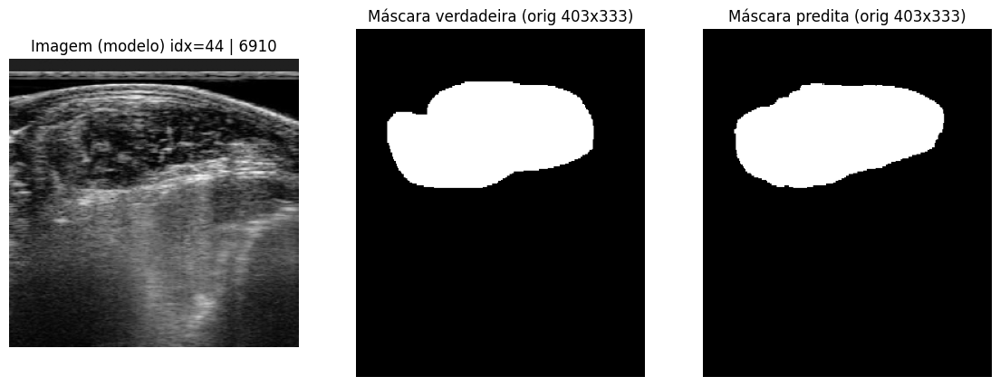

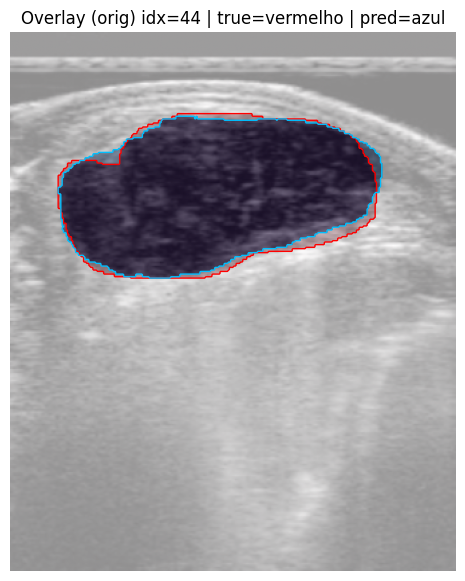

idx=45 | area_true=36.603 cm² | area_pred=34.787 cm² | diff=+1.815 cm² | dice=0.9549 | iou=0.9137


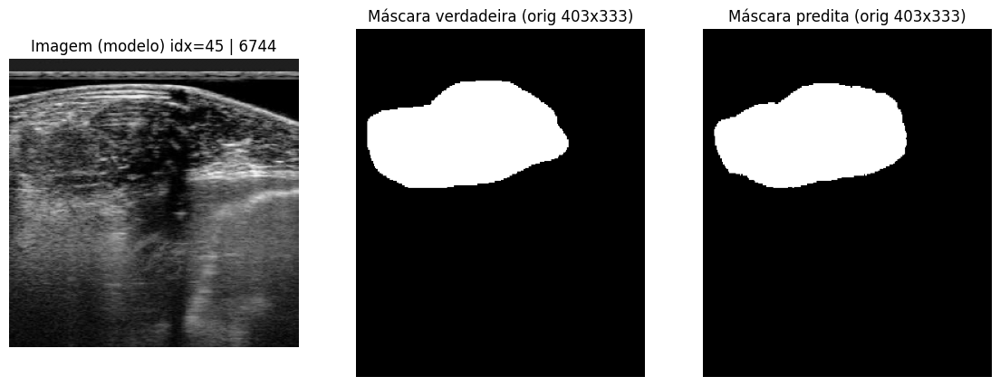

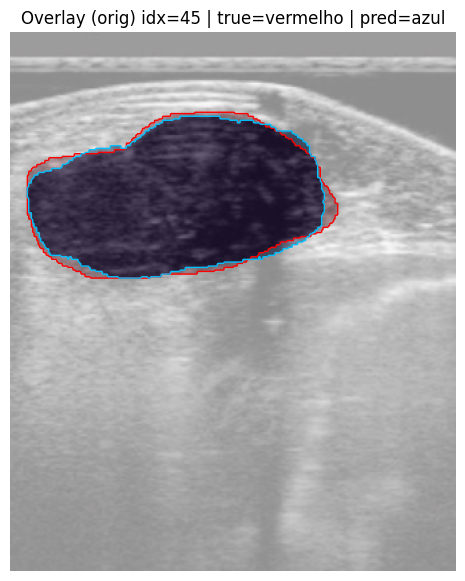

idx=46 | area_true=49.289 cm² | area_pred=48.337 cm² | diff=+0.953 cm² | dice=0.9763 | iou=0.9537


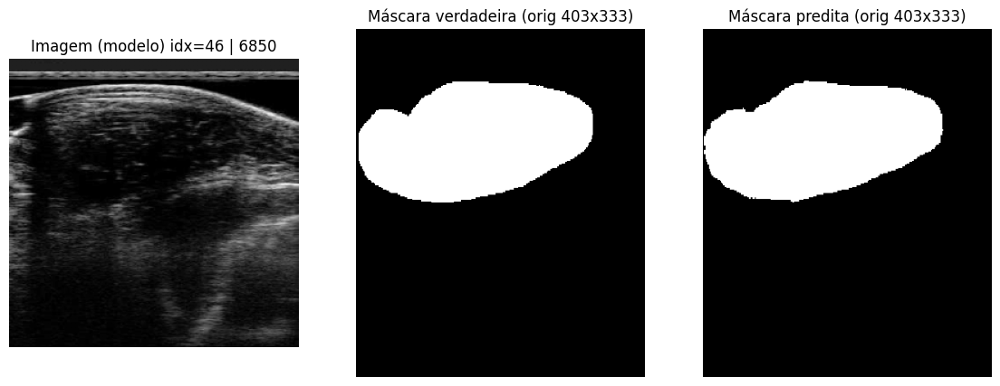

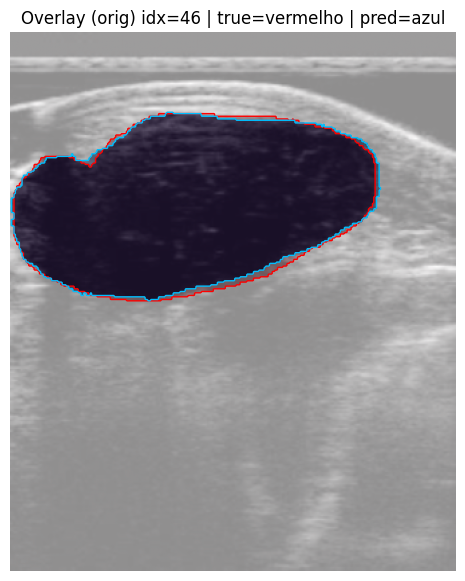

idx=47 | area_true=35.263 cm² | area_pred=34.275 cm² | diff=+0.987 cm² | dice=0.9765 | iou=0.9541


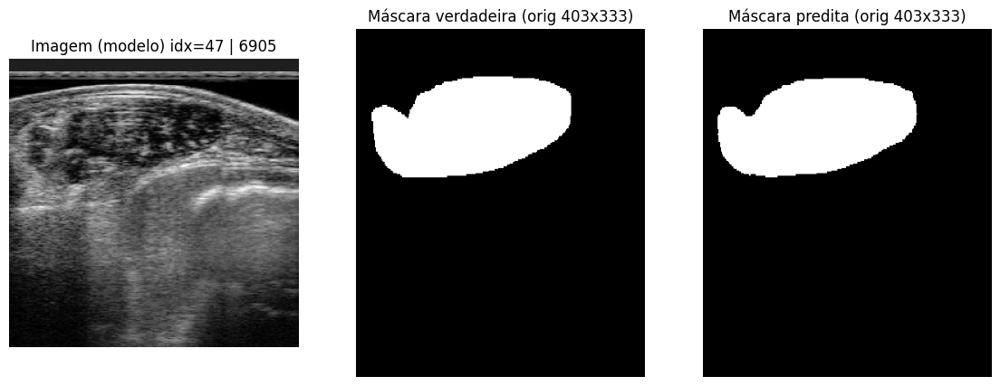

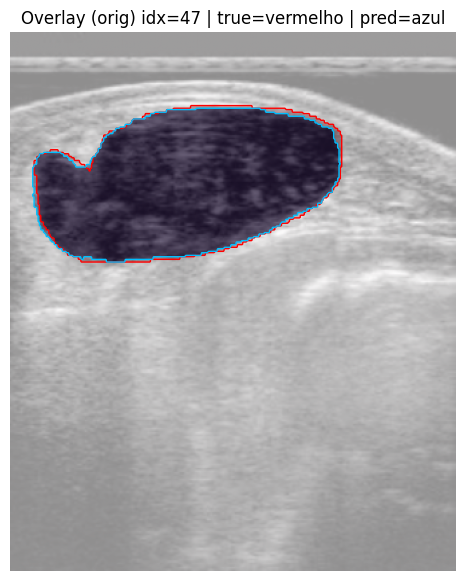

idx=48 | area_true=42.833 cm² | area_pred=43.383 cm² | diff=+0.550 cm² | dice=0.9529 | iou=0.9101


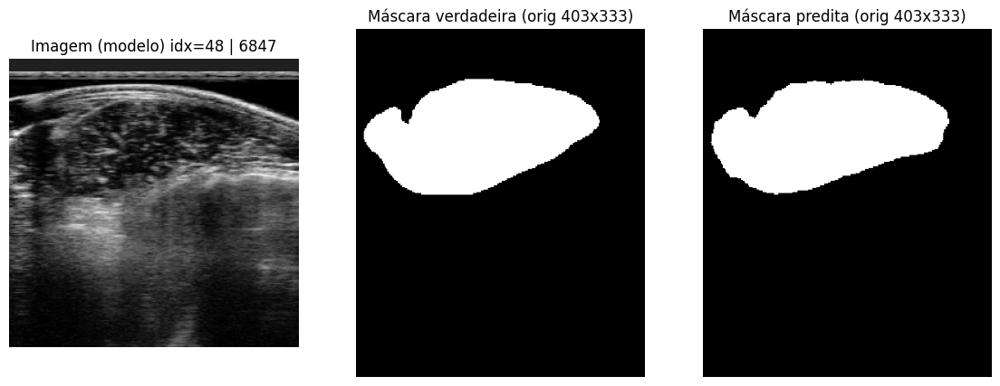

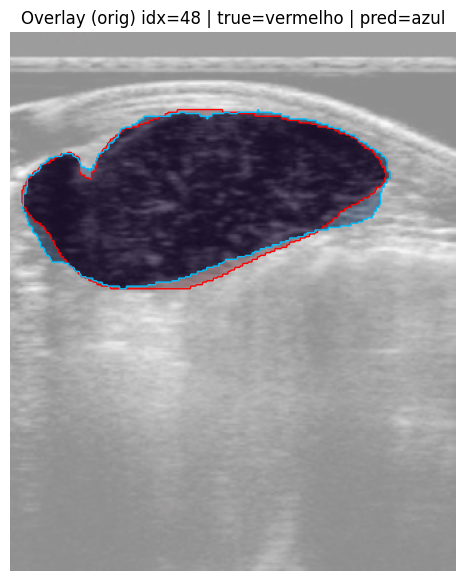

idx=49 | area_true=54.512 cm² | area_pred=53.693 cm² | diff=+0.819 cm² | dice=0.9717 | iou=0.9449


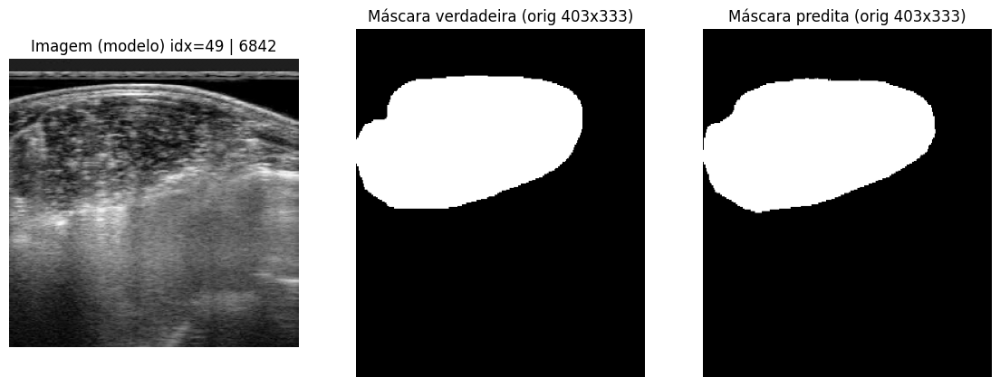

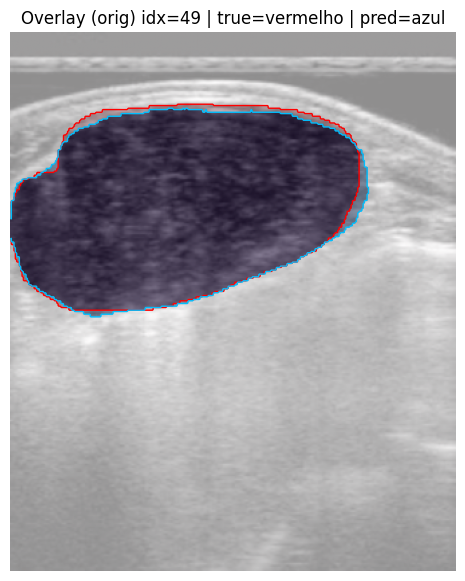

idx=50 | area_true=49.932 cm² | area_pred=49.974 cm² | diff=+0.041 cm² | dice=0.9750 | iou=0.9512


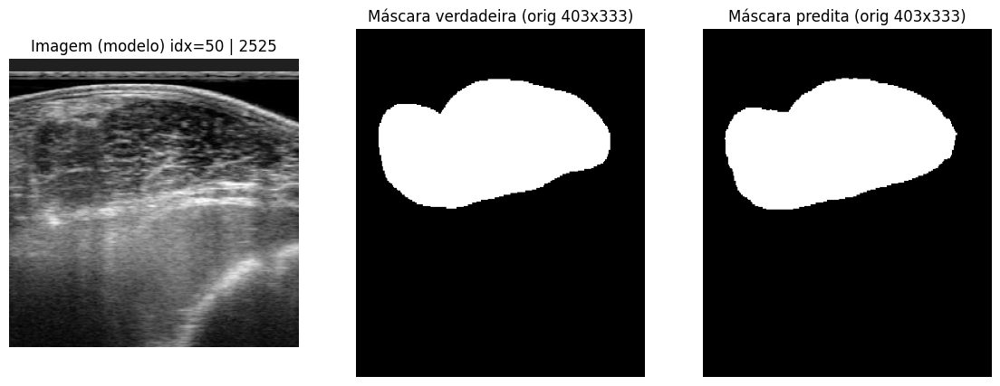

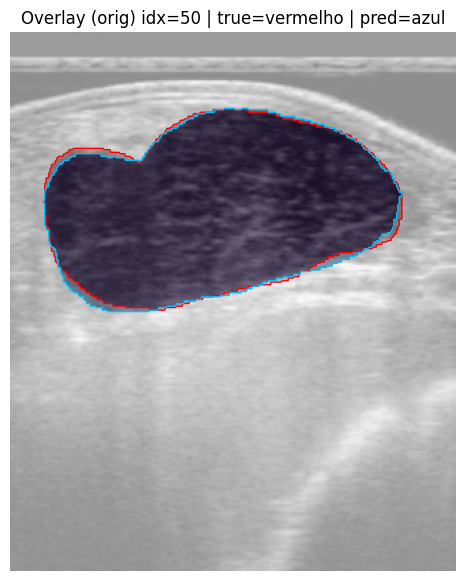

idx=51 | area_true=47.852 cm² | area_pred=45.503 cm² | diff=+2.350 cm² | dice=0.9680 | iou=0.9380


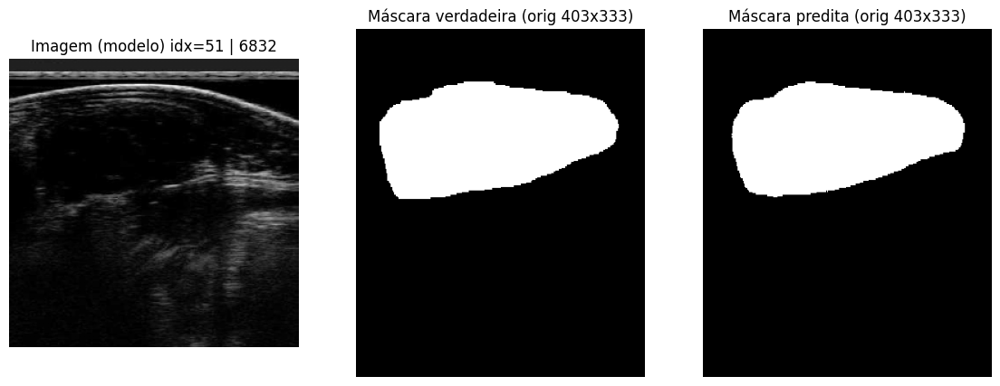

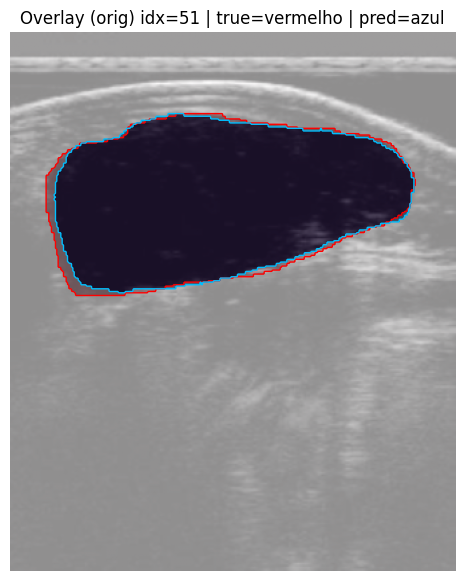

idx=52 | area_true=40.505 cm² | area_pred=41.027 cm² | diff=+0.522 cm² | dice=0.9721 | iou=0.9457


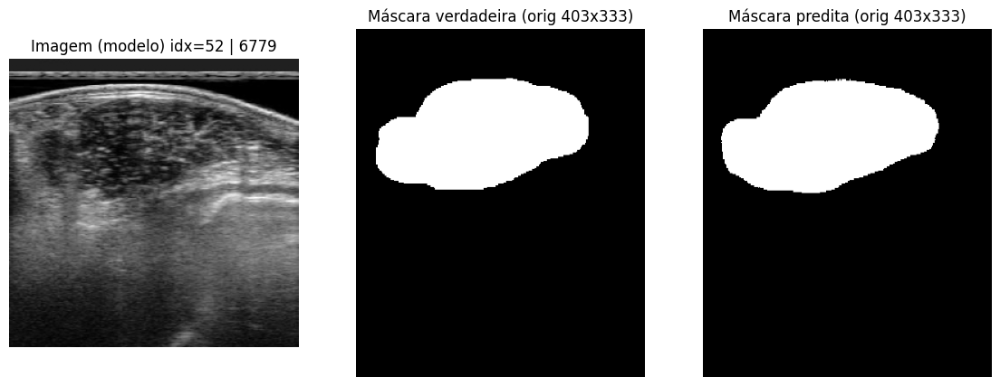

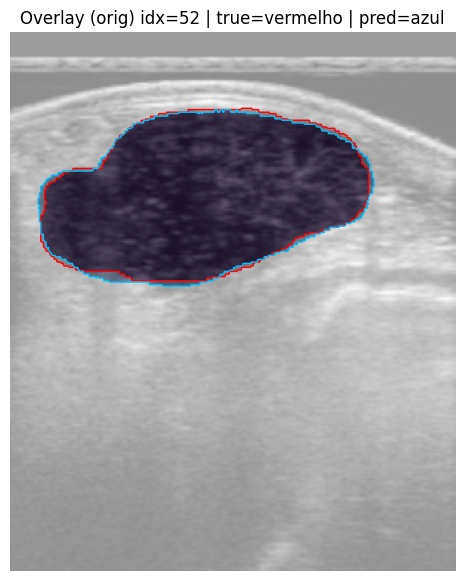

idx=53 | area_true=40.048 cm² | area_pred=38.829 cm² | diff=+1.219 cm² | dice=0.9556 | iou=0.9149


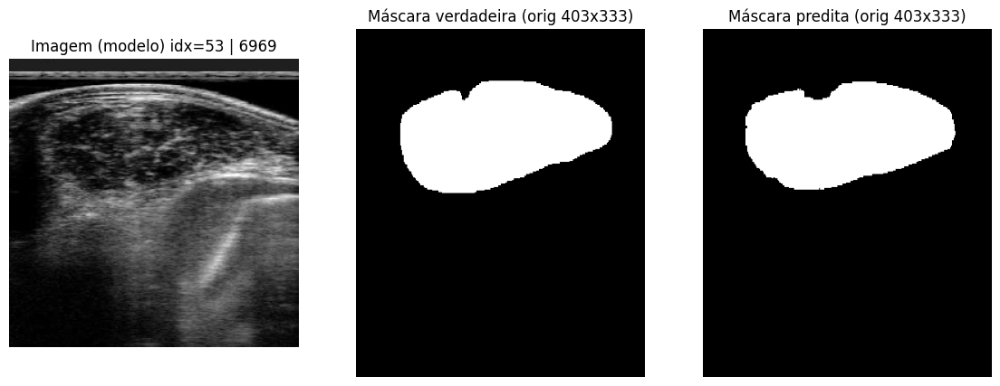

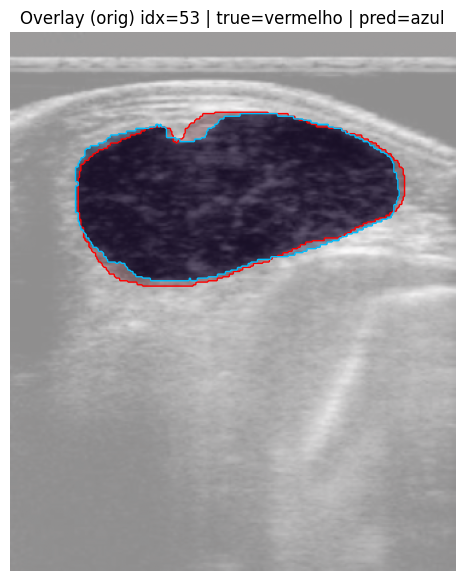

idx=54 | area_true=40.048 cm² | area_pred=38.560 cm² | diff=+1.489 cm² | dice=0.9478 | iou=0.9007


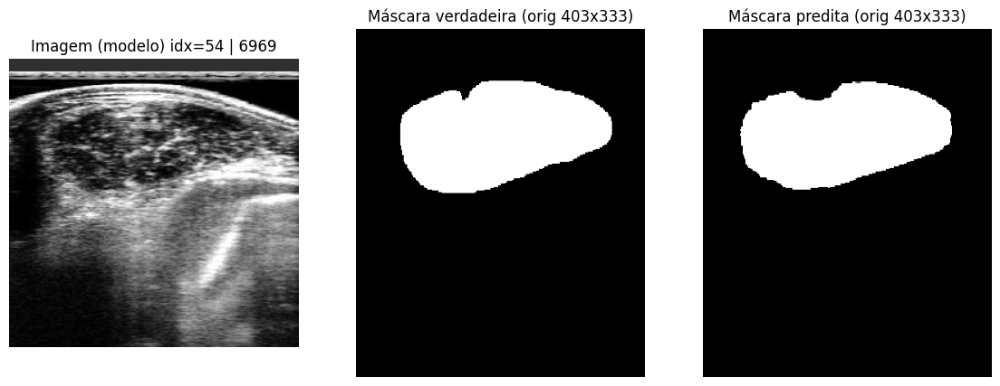

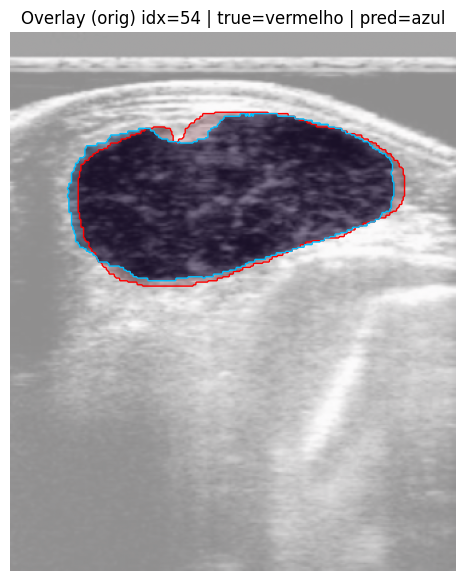

idx=55 | area_true=45.885 cm² | area_pred=43.508 cm² | diff=+2.377 cm² | dice=0.9614 | iou=0.9256


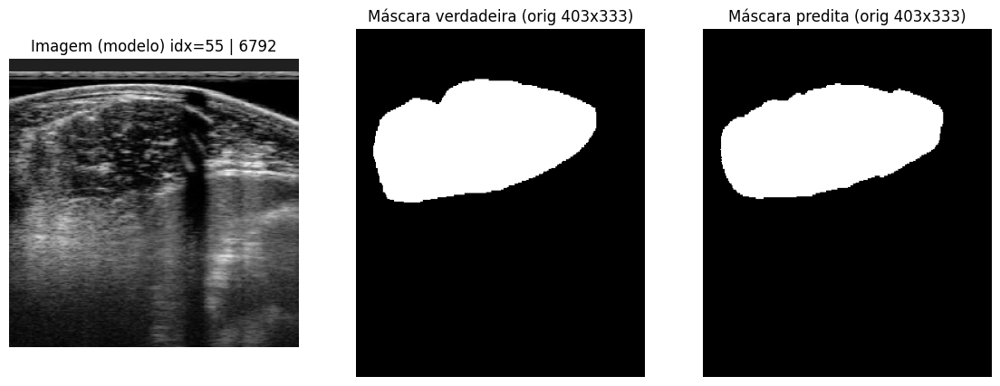

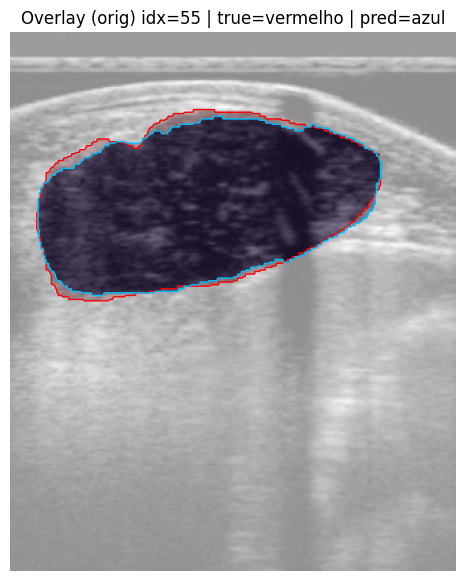

idx=56 | area_true=39.172 cm² | area_pred=35.389 cm² | diff=+3.783 cm² | dice=0.9403 | iou=0.8874


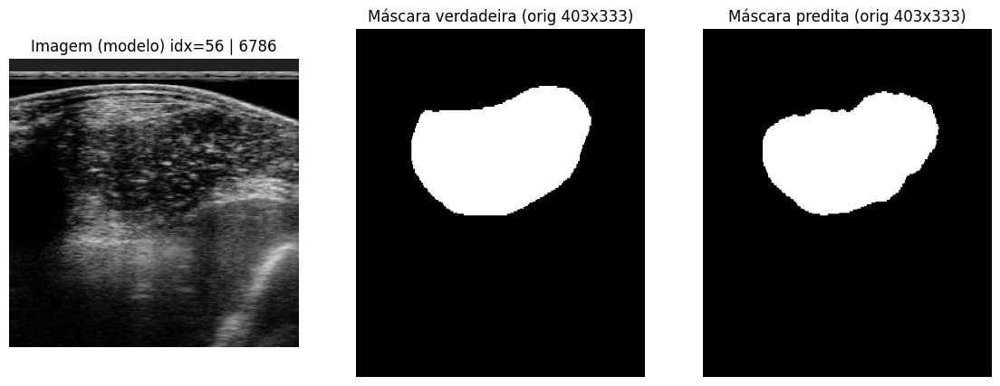

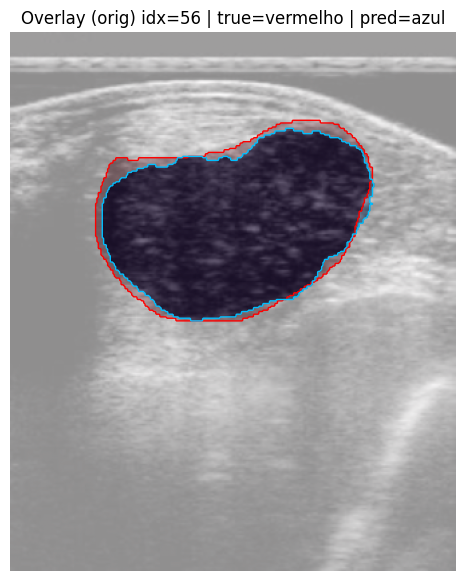

idx=57 | area_true=39.976 cm² | area_pred=39.718 cm² | diff=+0.258 cm² | dice=0.9806 | iou=0.9620


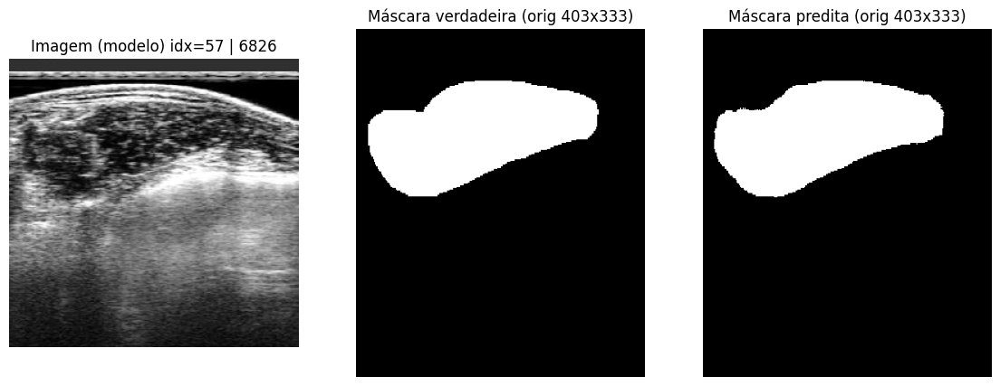

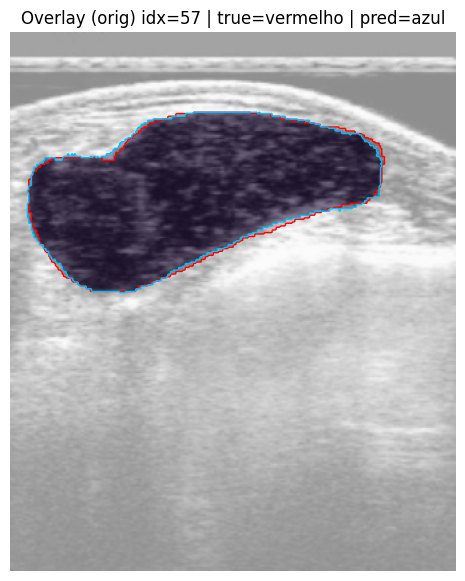

idx=58 | area_true=40.850 cm² | area_pred=44.239 cm² | diff=+3.389 cm² | dice=0.9543 | iou=0.9126


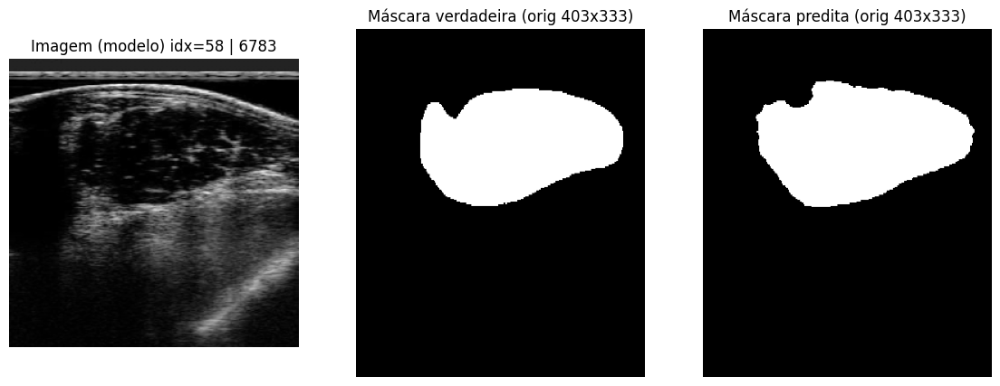

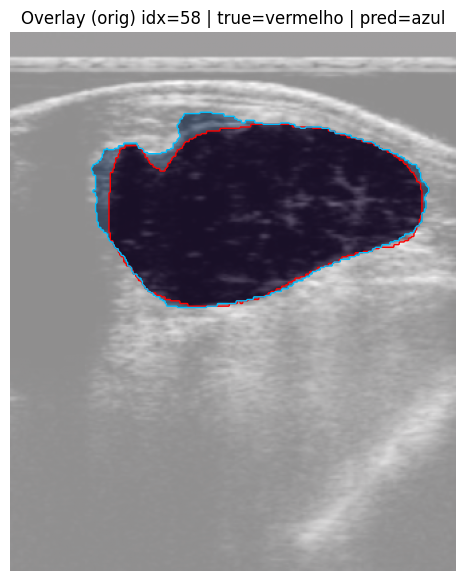

idx=59 | area_true=43.433 cm² | area_pred=51.967 cm² | diff=+8.534 cm² | dice=0.7879 | iou=0.6501


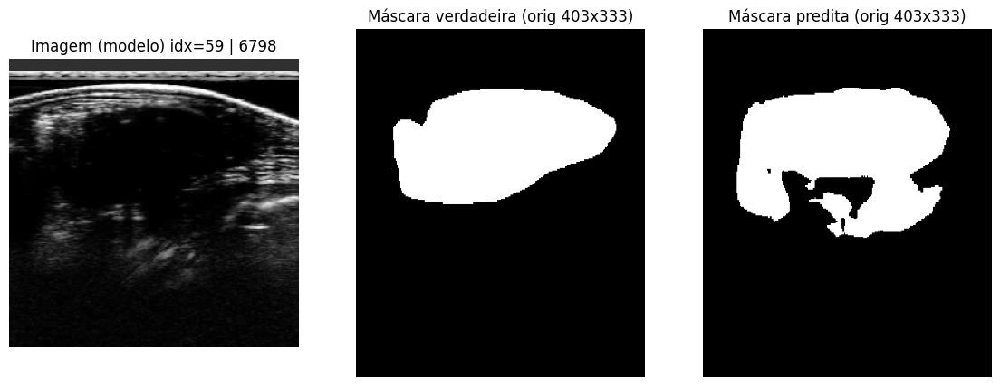

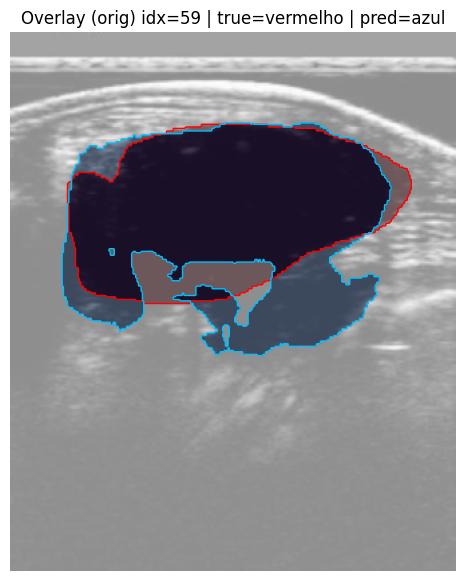

idx=60 | area_true=44.823 cm² | area_pred=43.890 cm² | diff=+0.934 cm² | dice=0.9824 | iou=0.9654


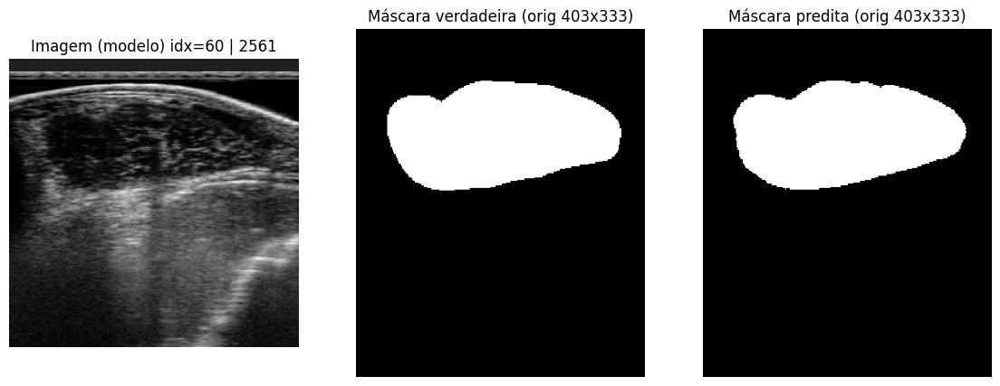

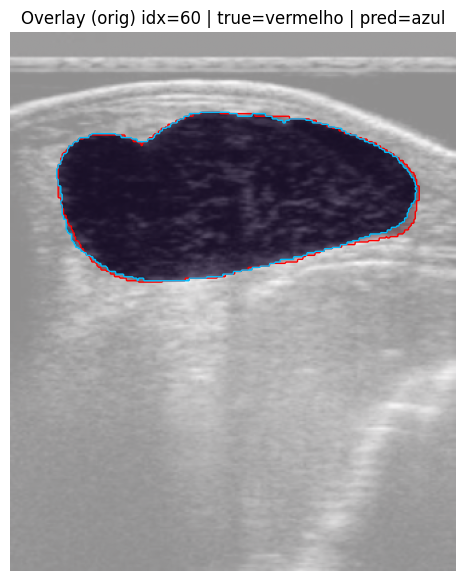

idx=61 | area_true=43.392 cm² | area_pred=41.622 cm² | diff=+1.770 cm² | dice=0.9719 | iou=0.9454


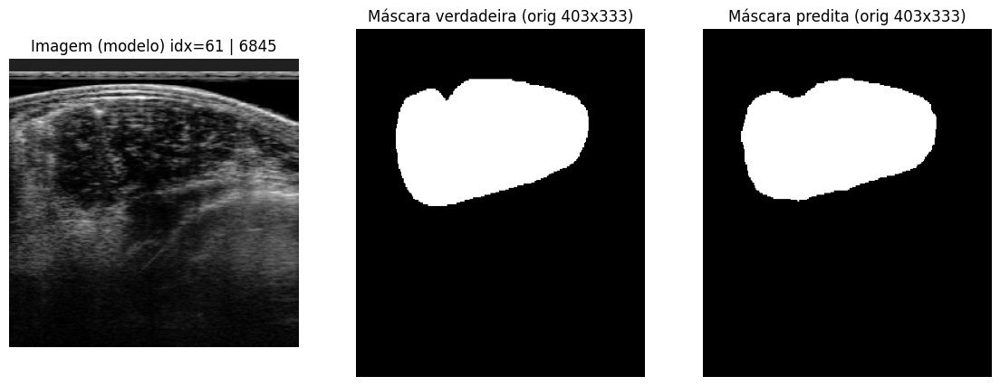

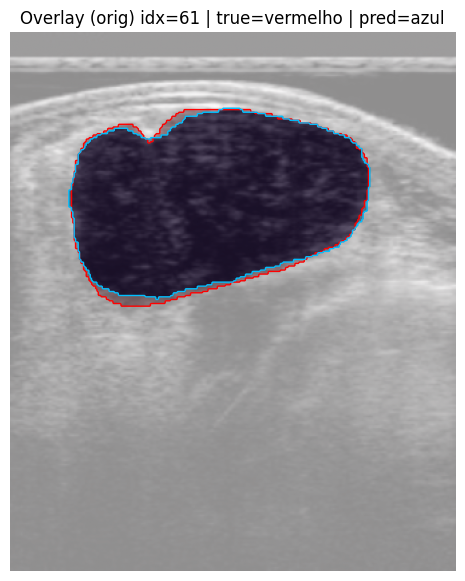

idx=62 | area_true=42.495 cm² | area_pred=41.696 cm² | diff=+0.799 cm² | dice=0.9718 | iou=0.9451


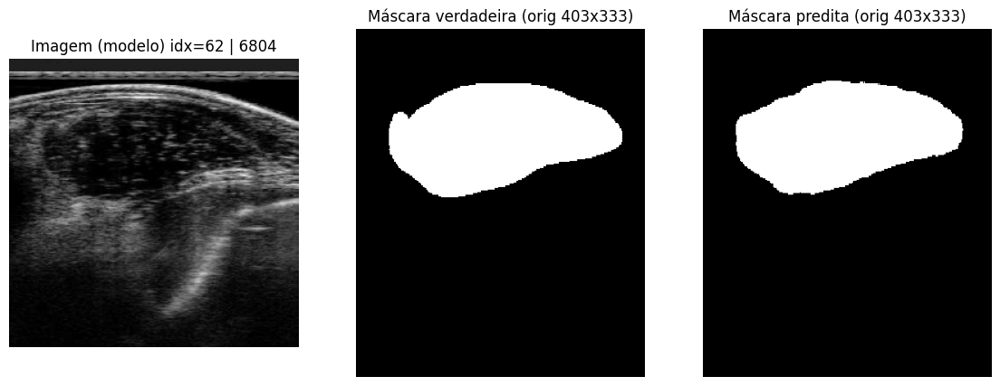

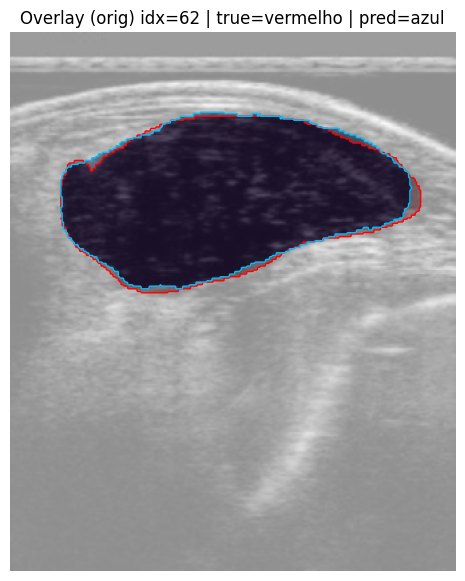

idx=63 | area_true=41.073 cm² | area_pred=40.576 cm² | diff=+0.498 cm² | dice=0.9737 | iou=0.9488


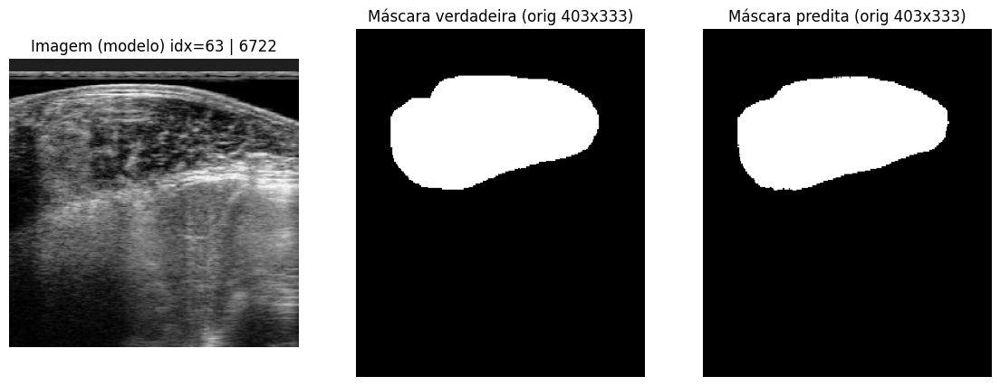

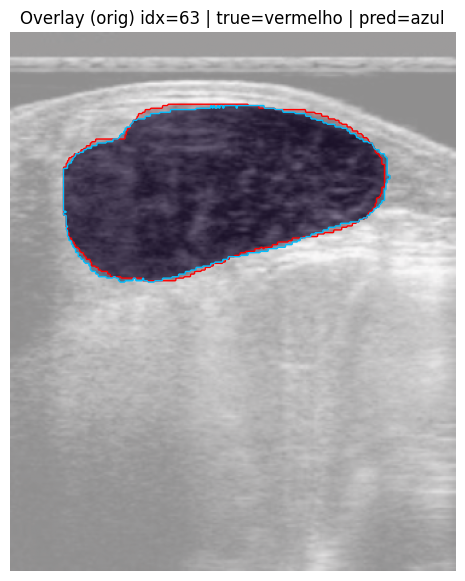

idx=64 | area_true=33.874 cm² | area_pred=32.591 cm² | diff=+1.283 cm² | dice=0.9677 | iou=0.9375


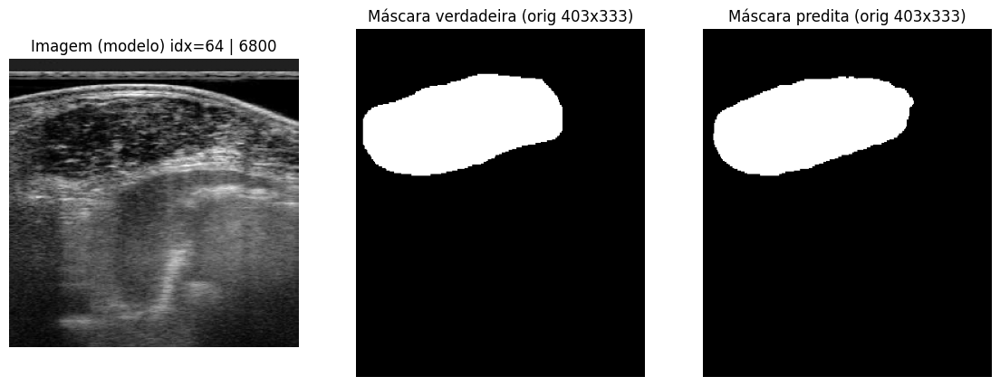

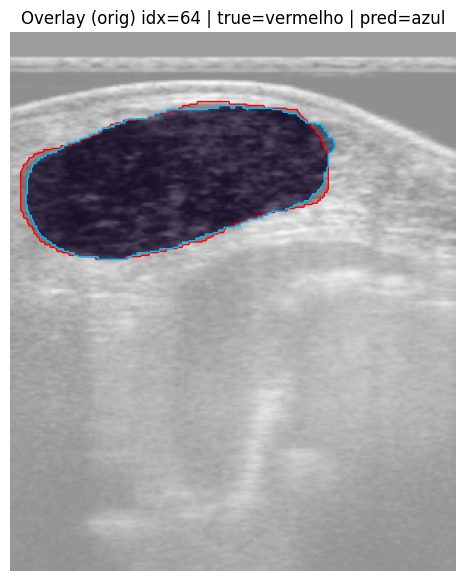

idx=65 | area_true=45.017 cm² | area_pred=48.451 cm² | diff=+3.434 cm² | dice=0.9325 | iou=0.8735


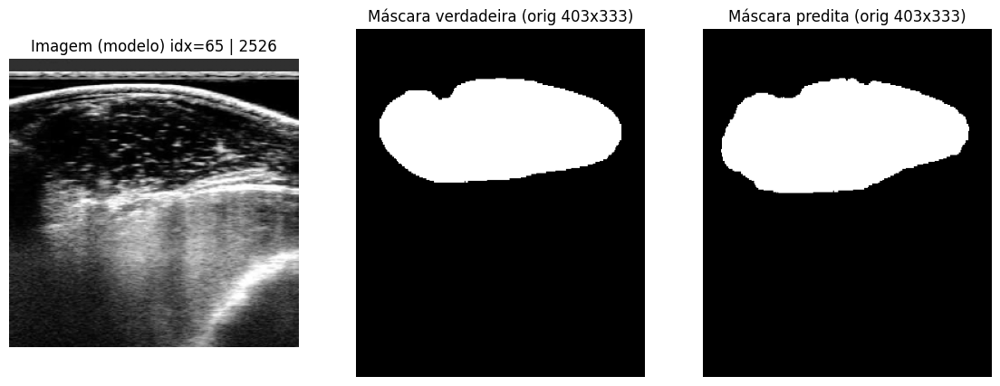

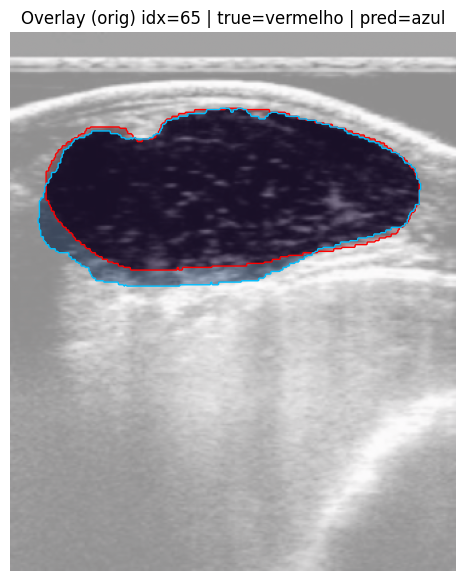

idx=66 | area_true=41.580 cm² | area_pred=40.999 cm² | diff=+0.581 cm² | dice=0.9814 | iou=0.9634


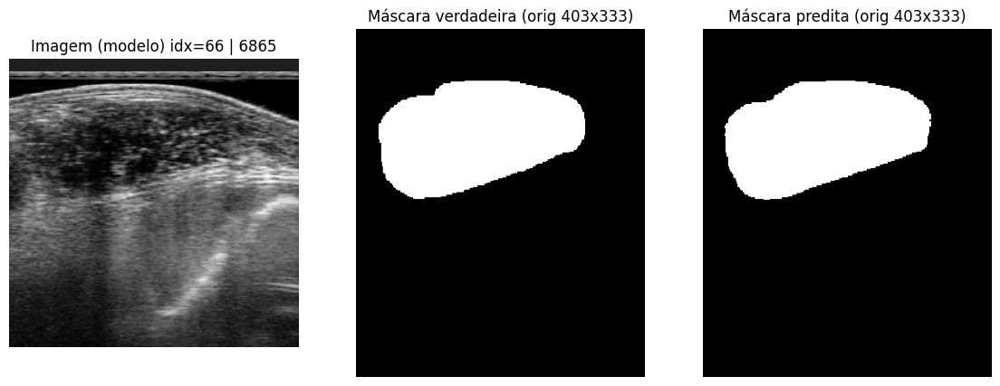

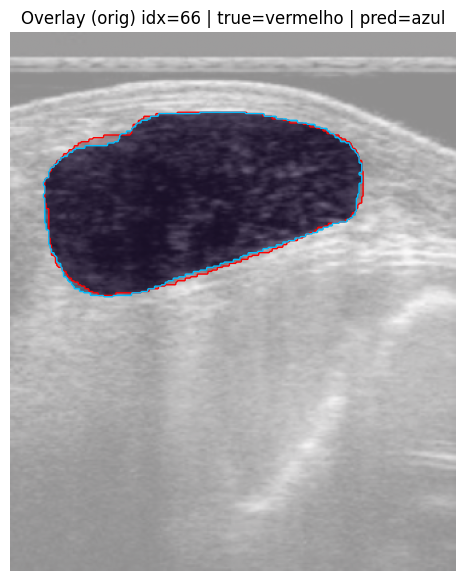

idx=67 | area_true=41.649 cm² | area_pred=38.570 cm² | diff=+3.079 cm² | dice=0.9233 | iou=0.8575


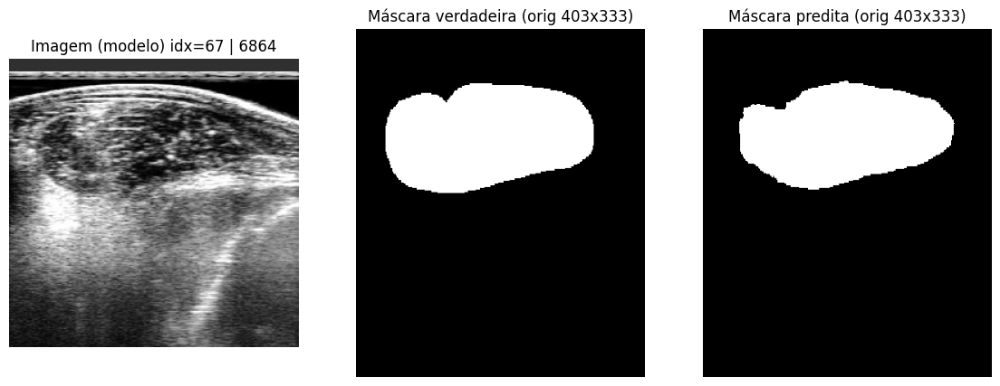

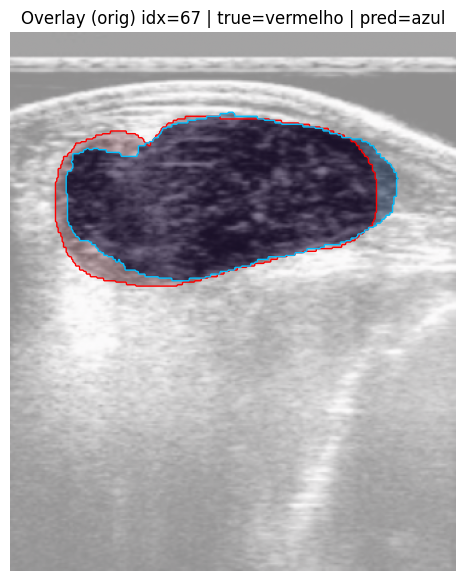

idx=68 | area_true=47.102 cm² | area_pred=49.868 cm² | diff=+2.766 cm² | dice=0.9043 | iou=0.8253


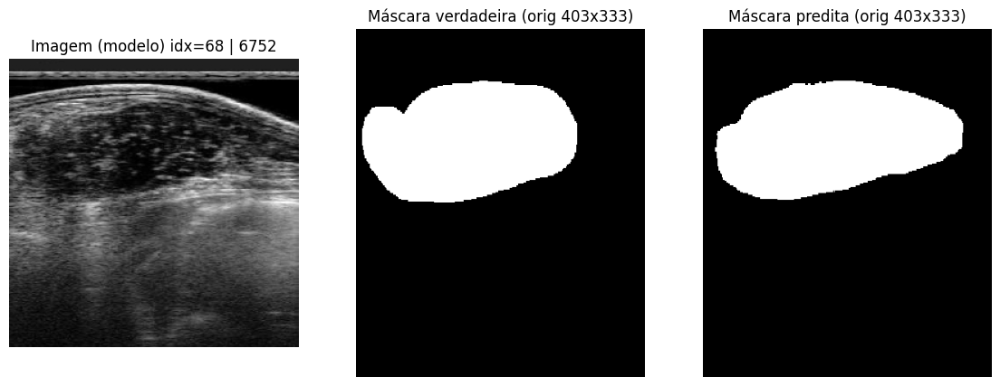

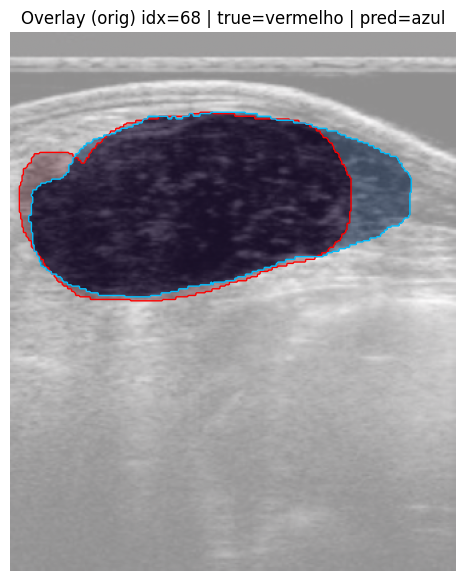

idx=69 | area_true=41.649 cm² | area_pred=38.349 cm² | diff=+3.300 cm² | dice=0.9184 | iou=0.8491


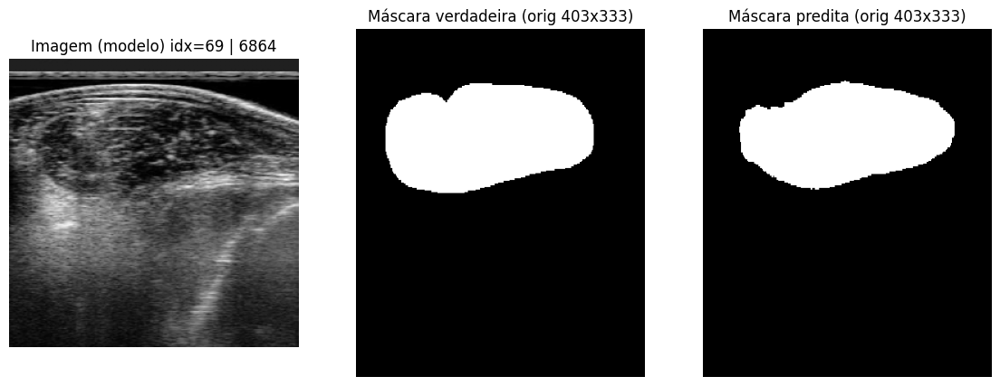

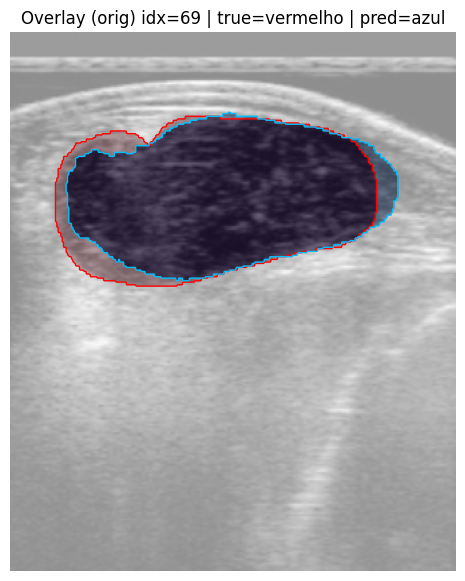

idx=70 | area_true=46.058 cm² | area_pred=45.536 cm² | diff=+0.522 cm² | dice=0.9767 | iou=0.9545


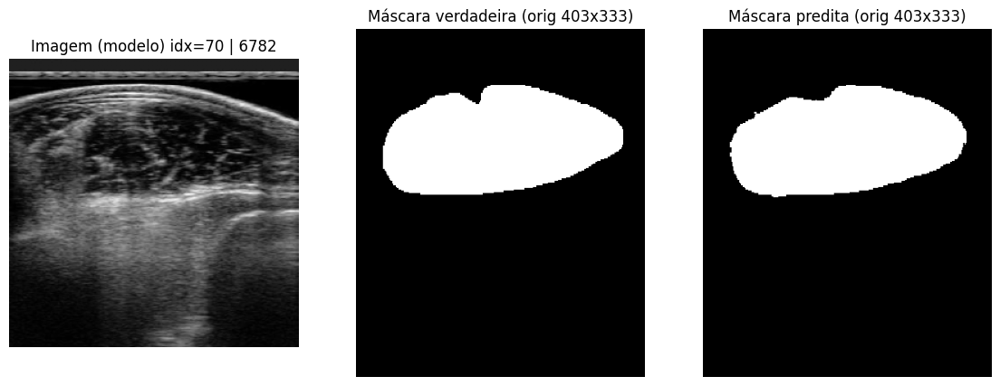

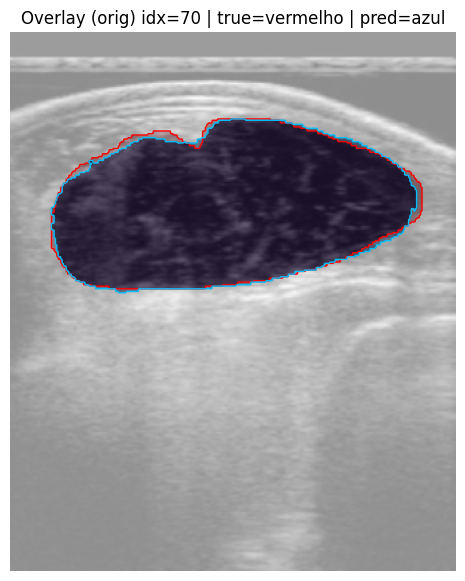

idx=71 | area_true=40.850 cm² | area_pred=42.797 cm² | diff=+1.947 cm² | dice=0.9634 | iou=0.9294


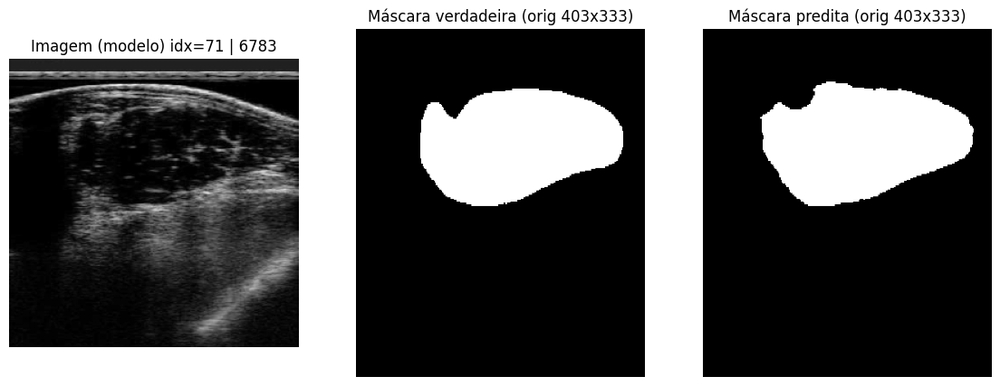

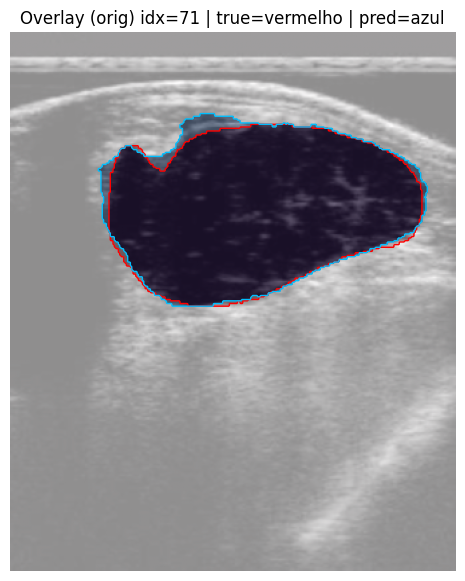

idx=72 | area_true=29.824 cm² | area_pred=32.761 cm² | diff=+2.937 cm² | dice=0.9404 | iou=0.8874


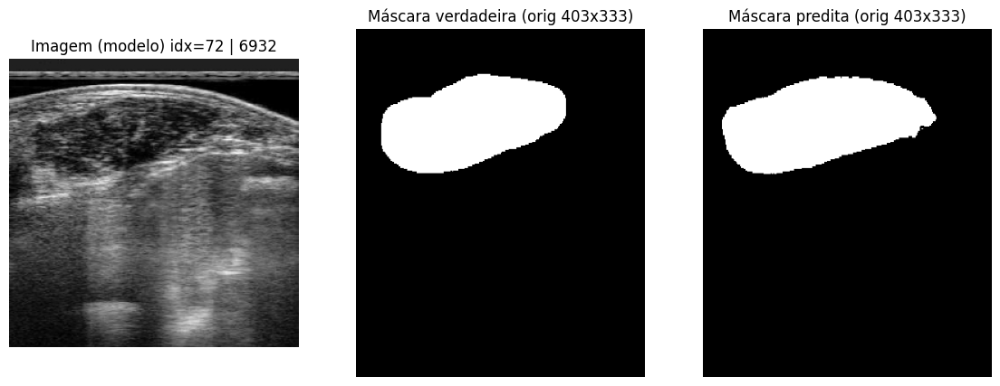

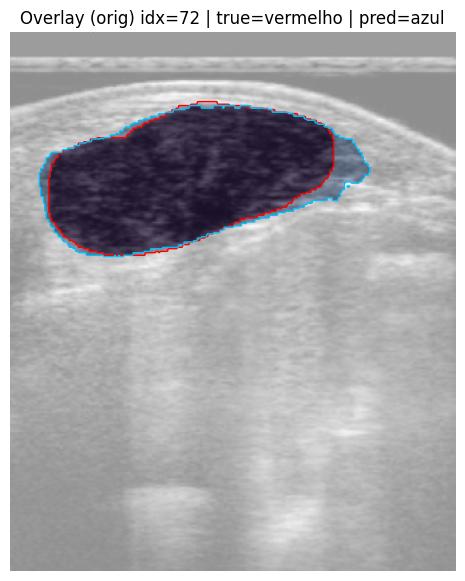

idx=73 | area_true=47.602 cm² | area_pred=44.775 cm² | diff=+2.827 cm² | dice=0.9690 | iou=0.9399


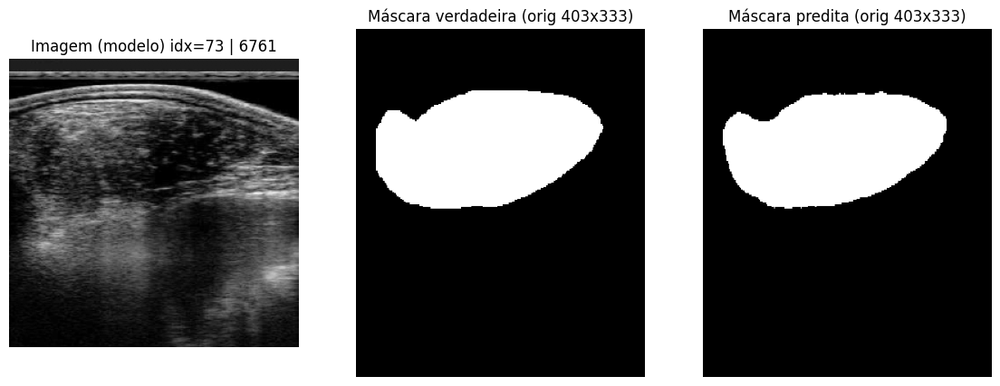

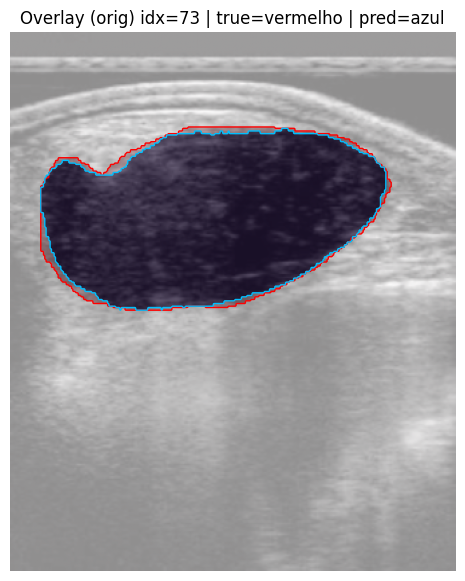

idx=74 | area_true=41.580 cm² | area_pred=41.794 cm² | diff=+0.214 cm² | dice=0.9777 | iou=0.9563


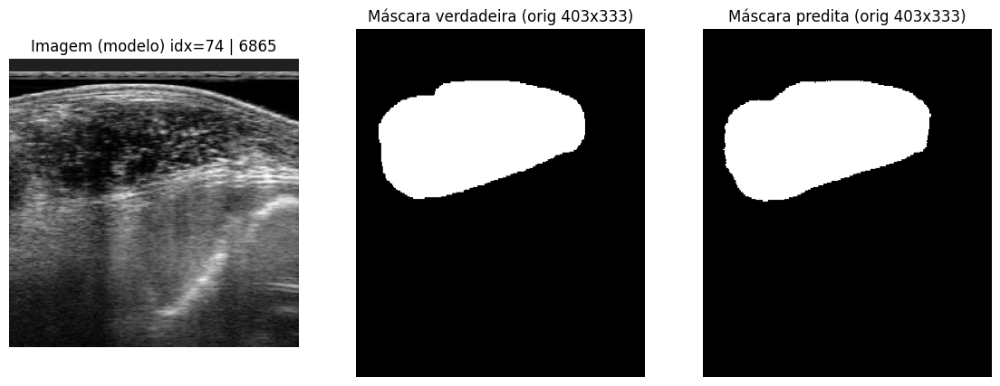

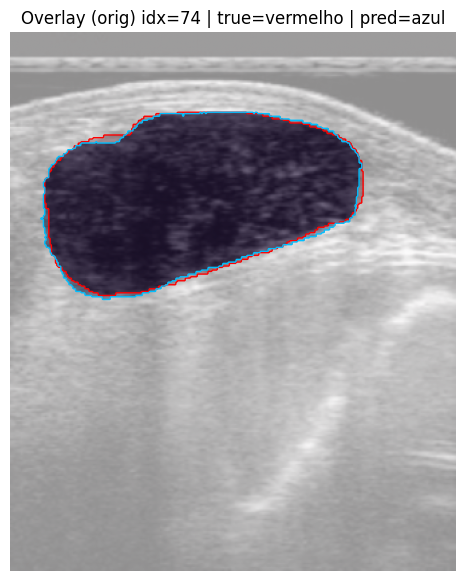

In [21]:
# Print função área
for idx in range(len(x_val)):
    comparar_area_predicao(
        idx,
        modelo,
        x_val,
        y_val,
        nomes_dados= nomes_val,
        orig_size=(403, 333),
        threshold=0.5,
        px_per_cm=24.05,
        smooth=1e-6,
        plot=True,
        overlay_alpha=0.35,
        contours=True,
        verbose=True,
    )

In [22]:
""" Calculando a média dos erros"""
erros = []
area_real: list[float] = [] 
area_predita: list[float] = []
for idx in range(len(x_val)):
    resultado = comparar_area_predicao(
        idx,
        modelo,
        x_val,
        y_val,
        nomes_dados= nomes_val,
        orig_size=(403, 333),
        threshold=0.5,
        px_per_cm=24.05,
        smooth=1e-6,
        plot=False,
        overlay_alpha=0.35,
        contours=True,
        verbose=False,
    )
    erros.append(resultado['diff_cm2'])
    area_real.append(resultado['area_true_cm2'])
    area_predita.append(resultado['area_pred_cm2'])

In [23]:
# Print dos erros
print(f'Erro médio na validação: {np.mean(np.abs(erros)):.3f} cm²')
print(f'Erro Máximo na validação: {np.max(np.abs(erros)):.3f} cm²')
print(f'Erro mínimo na validação: {np.min(np.abs(erros)):.3f} cm²')

Erro médio na validação: 1.592 cm²
Erro Máximo na validação: 8.814 cm²
Erro mínimo na validação: 0.017 cm²


In [24]:
# Print áreas
print(f'Tamanho da lita da área verdadeira = {len(area_real)}. Verificando área: {area_real[2]}')
print(f'Tamanho da lita da área predita= {len(area_predita)}. Verificando área: {area_predita[2]}')

Tamanho da lita da área verdadeira = 75. Verificando área: 43.203478546513885
Tamanho da lita da área predita= 75. Verificando área: 42.17132533140849


In [25]:
# Testando outras imagens 
path_x_new = 'banco2/Validacao/imgs/'
path_y_new = 'banco2/Validacao/labels/'
x_new = banco(path_x_new, resolution=(256,256), grayscale= True)
y_new = banco(path_y_new, resolution=(256,256), grayscale= True)

print(f'Novas imagens : {x_new.shape}')
print(f'Novos rótulos : {y_new.shape}')

new_data = tf.data.Dataset.from_tensor_slices((x_new, y_new))
new_data = new_data.batch(batch_size).prefetch(AUTOTUNE)
modelo.evaluate(new_data, verbose= 1)

Novas imagens : (9, 256, 256, 1)
Novos rótulos : (9, 256, 256, 1)
9/9 ━━━━━━━━━━━━━━━━━━━━ 2s 172ms/step - accuracy: 0.9492 - dice_coefficient: 0.9062 - loss: 0.1428


[0.14277350902557373, 0.9491865634918213, 0.9062265753746033]

idx=0 | area_true=40.596 cm² | area_pred=37.263 cm² | diff=+3.333 cm² | dice=0.9242 | iou=0.8591


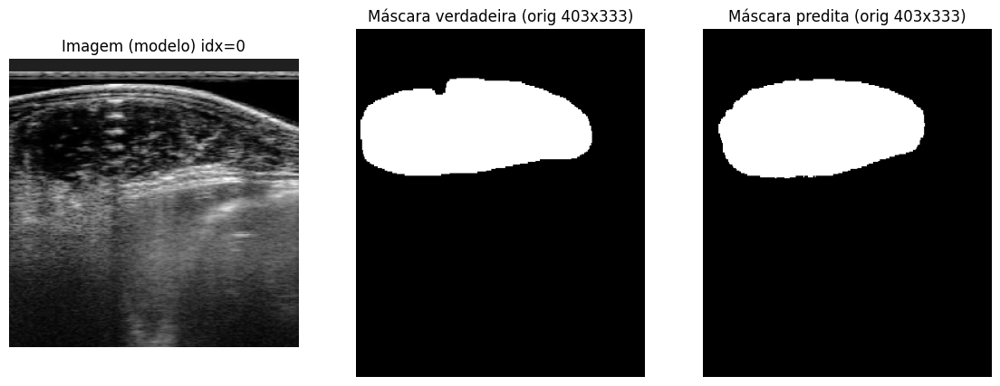

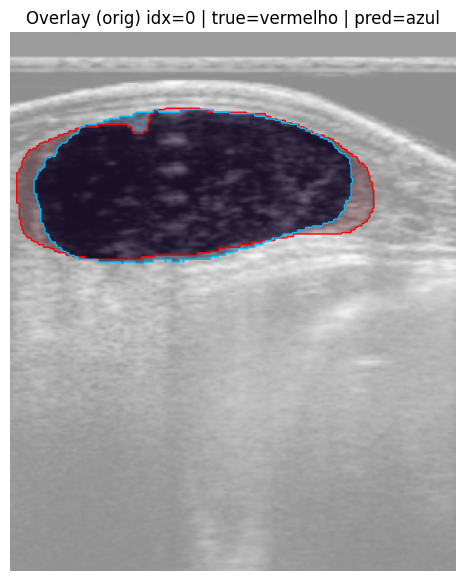

idx=1 | area_true=49.865 cm² | area_pred=43.198 cm² | diff=+6.667 cm² | dice=0.9161 | iou=0.8451


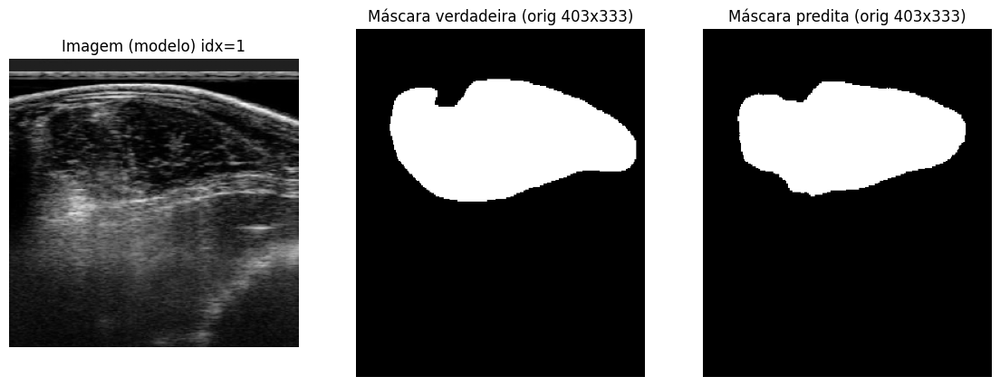

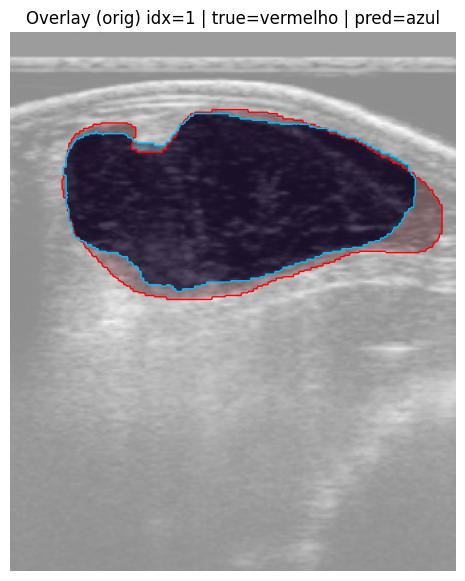

idx=2 | area_true=50.131 cm² | area_pred=46.758 cm² | diff=+3.373 cm² | dice=0.9339 | iou=0.8759


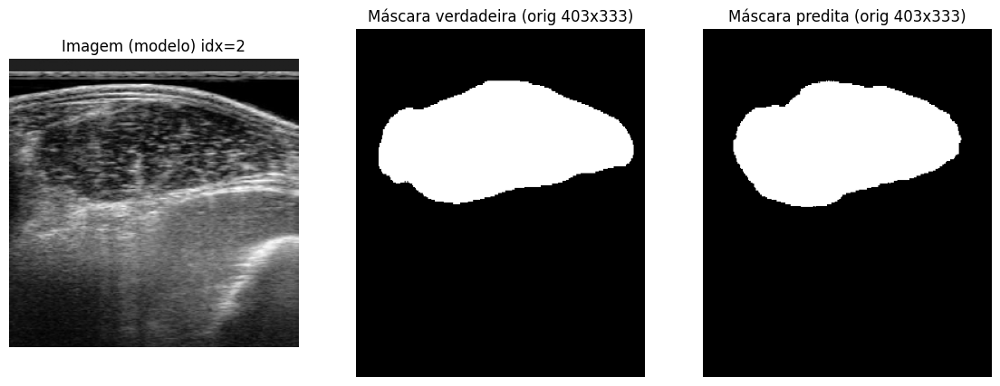

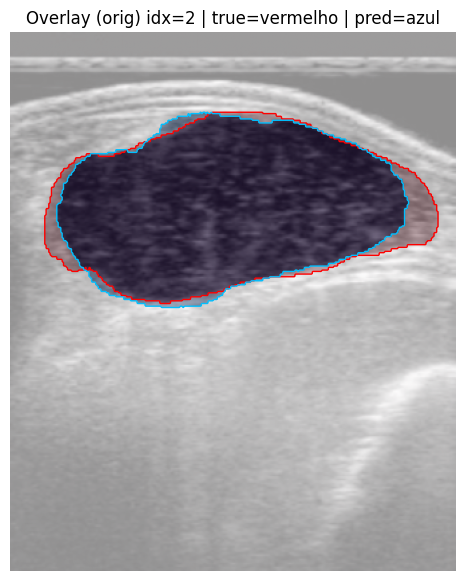

idx=3 | area_true=43.522 cm² | area_pred=41.914 cm² | diff=+1.608 cm² | dice=0.9237 | iou=0.8583


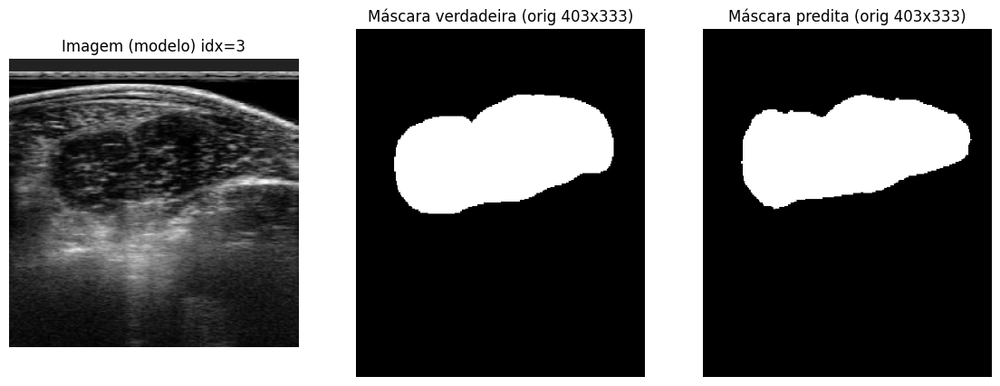

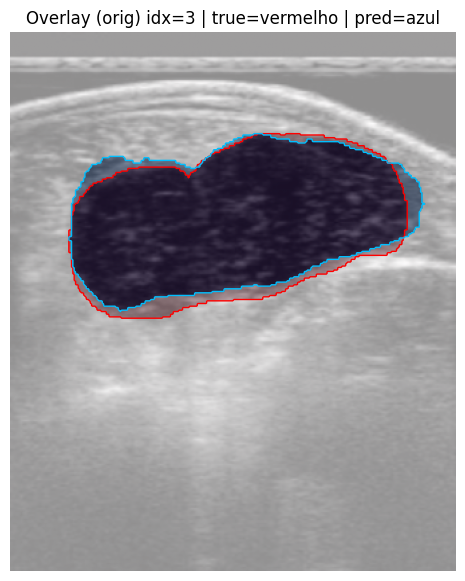

idx=4 | area_true=39.775 cm² | area_pred=39.562 cm² | diff=+0.213 cm² | dice=0.9560 | iou=0.9157


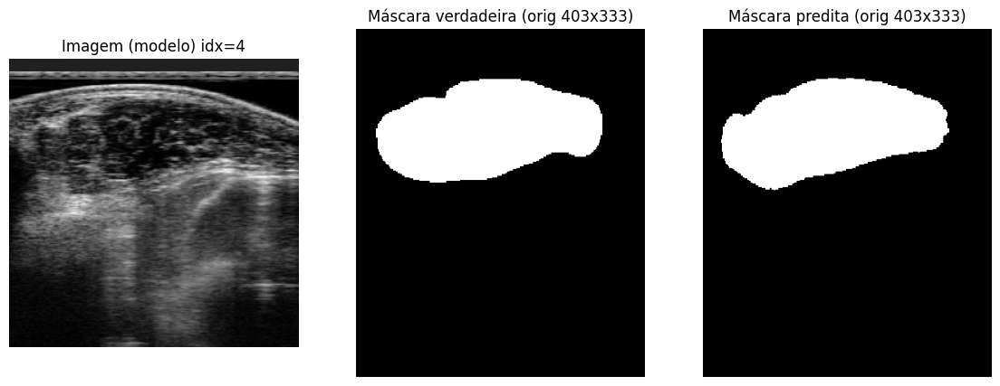

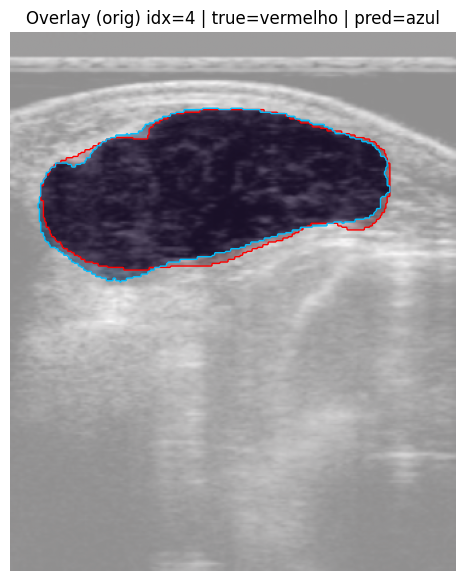

idx=5 | area_true=33.482 cm² | area_pred=37.915 cm² | diff=+4.433 cm² | dice=0.8701 | iou=0.7700


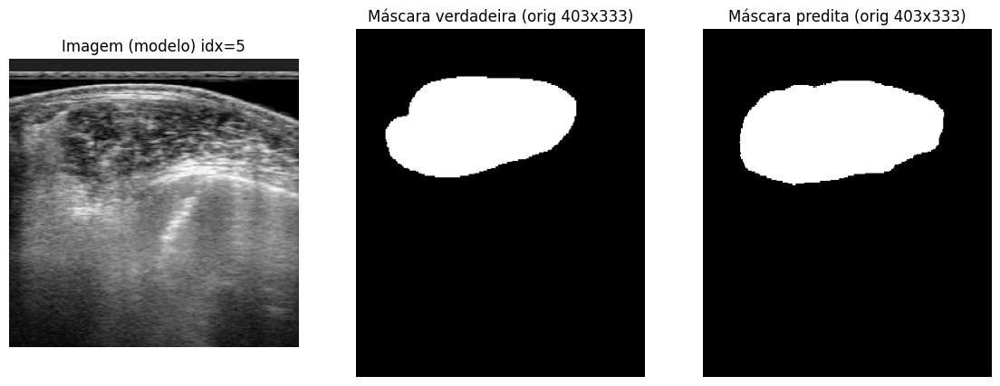

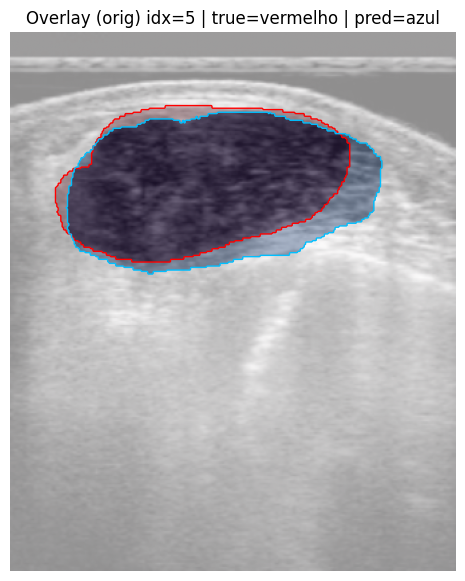

idx=6 | area_true=38.814 cm² | area_pred=48.598 cm² | diff=+9.784 cm² | dice=0.8634 | iou=0.7596


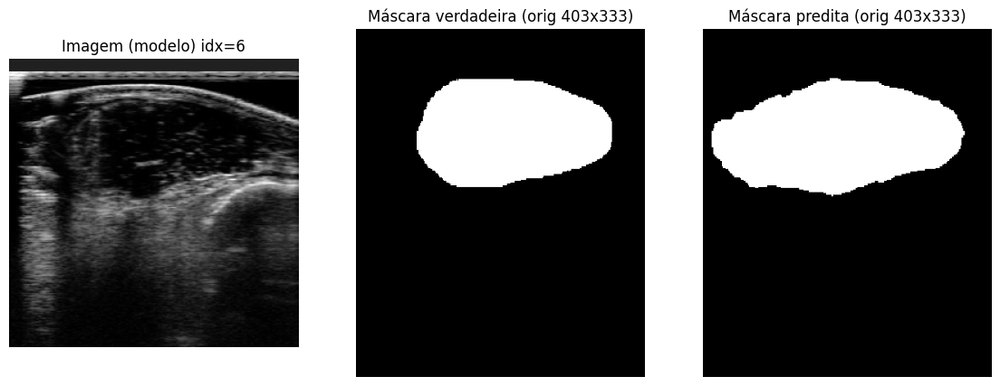

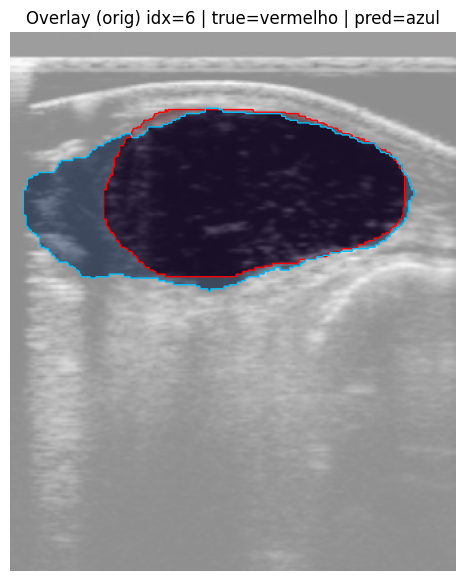

idx=7 | area_true=42.336 cm² | area_pred=44.384 cm² | diff=+2.049 cm² | dice=0.9091 | iou=0.8334


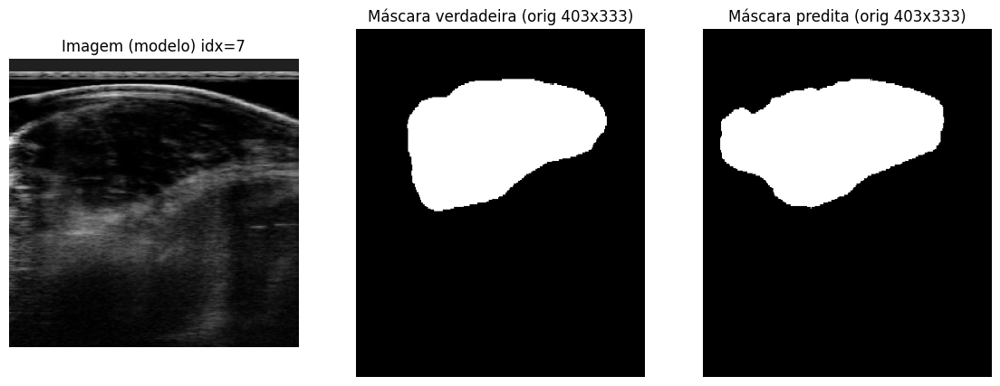

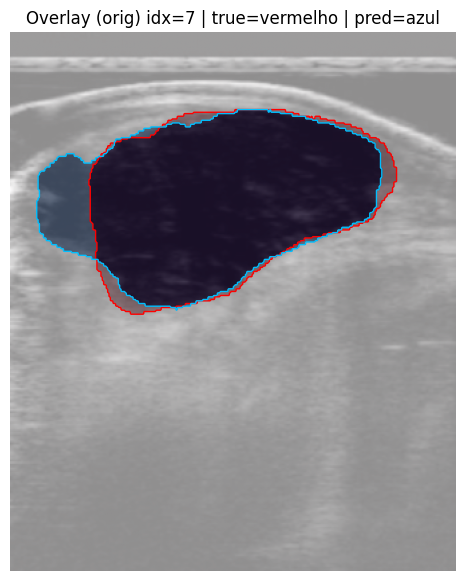

idx=8 | area_true=42.078 cm² | area_pred=44.175 cm² | diff=+2.097 cm² | dice=0.9186 | iou=0.8494


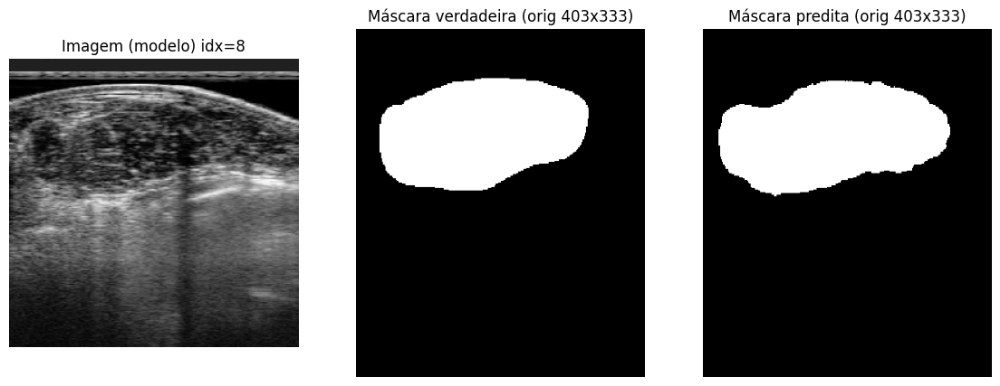

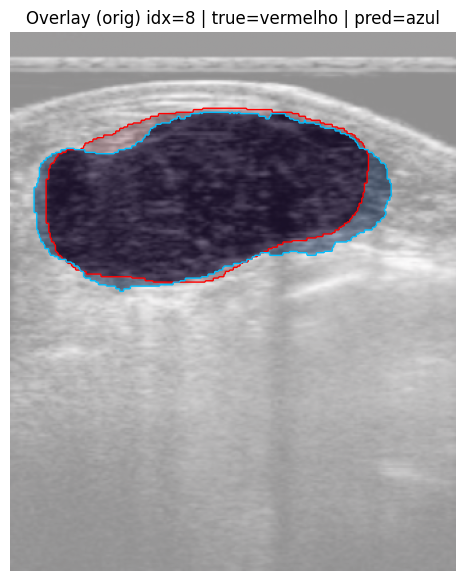

In [26]:
# Print função
for idx in range(len(x_new)):
    comparar_area_predicao(
        idx,
        modelo,
        x_new,
        y_new,
        nomes_dados= None,
        orig_size=(403, 333),
        threshold=0.5,
        px_per_cm=24.05,
        smooth=1e-6,
        plot=True,
        overlay_alpha=0.35,
        contours=True,
        verbose=True,
    )

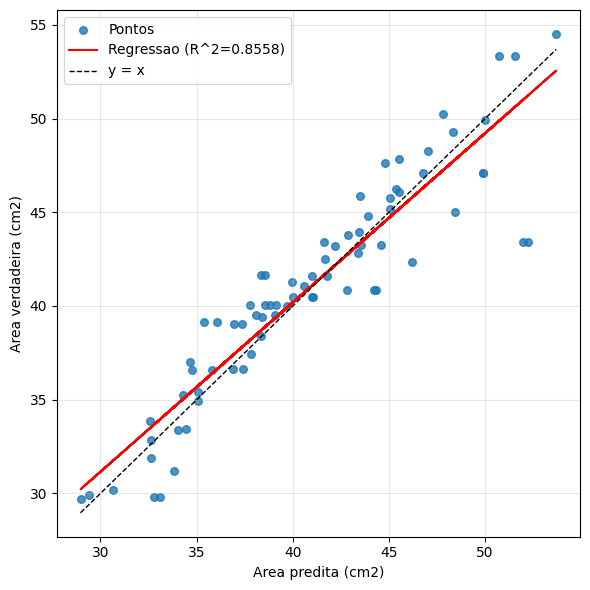

In [27]:
# Print do R^2 
y_pred = np.array(area_predita)
y_true = np.array(area_real)

# Ajuste de reta (y = a*x + b)
a, b = np.polyfit(y_pred, y_true, 1)
y_hat = a * y_pred + b

# R^2
y_mean = y_true.mean()
ss_tot = np.sum((y_true - y_mean) ** 2)
ss_res = np.sum((y_true - y_hat) ** 2)
r2 = 1.0 - (ss_res / ss_tot) if ss_tot != 0 else 0.0

plt.figure(figsize=(6, 6))
plt.scatter(y_pred, y_true, s=30, alpha=0.8, label="Pontos")
plt.plot(y_pred, y_hat, "r-", label=f"Regressao (R^2={r2:.4f})")
plt.plot([y_pred.min(), y_pred.max()],
         [y_pred.min(), y_pred.max()],
         "k--", linewidth=1, label="y = x")

plt.xlabel("Area predita (cm2)")
plt.ylabel("Area verdadeira (cm2)")
plt.grid(True, alpha=0.3)
plt.legend()
plt.tight_layout()
plt.show()

In [28]:
erros2 = []
for idx in range(len(x_new)):
    resultado2 = comparar_area_predicao(
        idx,
        modelo,
        x_new,
        y_new,
        nomes_dados=None,
        orig_size=(403, 333),
        threshold=0.5,
        px_per_cm=24.05,
        smooth=1e-6,
        plot=False,
        overlay_alpha=0.35,
        contours=True,
        verbose=False,
    )
    erros2.append(resultado2['diff_cm2'])

# Print dos erros
print(f'Erro médio nas novas imagens: {np.mean(np.abs(erros2)):.3f} cm²')
print(f'Erro Máximo nas novas imagens: {np.max(np.abs(erros2)):.3f} cm²')
print(f'Erro mínimo nas novas imagens: {np.min(np.abs(erros2)):.3f} cm²')

Erro médio nas novas imagens: 3.728 cm²
Erro Máximo nas novas imagens: 9.784 cm²
Erro mínimo nas novas imagens: 0.213 cm²
